In [1]:
# Importing necessary libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import os
import missingno as msno

from IPython.display import display #To display dataframe with a nice format.

import plotly.graph_objs as go
import plotly.express as px
import plotly.graph_objects as go

from yellowbrick.cluster import KElbowVisualizer, SilhouetteVisualizer
from yellowbrick.cluster import InterclusterDistance

from sklearn.cluster import KMeans
from sklearn.cluster import MiniBatchKMeans
from sklearn.manifold import TSNE
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.compose import ColumnTransformer, make_column_transformer
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.utils import check_random_state
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import PowerTransformer
from sklearn.preprocessing import RobustScaler
from sklearn.cluster import DBSCAN
from sklearn.neighbors import NearestNeighbors
from sklearn.metrics import silhouette_score, davies_bouldin_score

from scipy.cluster.hierarchy import linkage, fcluster, dendrogram


# Setting display precision for pandas
pd.set_option("display.precision", 2)
# Set display option to show all columns
pd.set_option('display.max_columns', None)

blue_green      = (82/255, 162/255, 160/255)
blue_green_dark = (41/255, 81/255, 81/255)

# ==================================================================================================
# Set the fontsize & Bold for each GRAPH !!!
# ==================================================================================================
plt.rcParams['axes.titlesize'] = 18
plt.rcParams['axes.labelsize'] = 14
plt.rcParams["axes.titleweight"] = "bold"
plt.rcParams["axes.labelweight"] = "bold"
plt.rcParams["lines.linewidth"] = 3
plt.rcParams["lines.markersize"] = 10
plt.rcParams["xtick.labelsize"] = 12
plt.rcParams["ytick.labelsize"] = 12
plt.rcParams['axes.titlepad'] = 20 

In [2]:
# ==================================================================================================
# READ DATA
# ==================================================================================================
import csv
# Define the file path for the Excel data
url_df_data      = r"C:\Users\Olivi\OneDrive\Documents\OC_Formation_DATA_SCIENCE\PROJET5_segmentez_des_clients_dun_site_ecommerce\DATA\df_data.csv"
df_data          = pd.read_csv(url_df_data)

print("Datasets loaded succesfully ! :D")

Datasets loaded succesfully ! :D


In [3]:
df_data.describe()

,recency,frequency,total_payment,price,freight_value,review_score,payment_installments,product_photos_qty,product_length_cm,product_height_cm,product_width_cm,Delivery_Delay,payment_value,product_weight_g
count,80144.00,80144.00,80144.00,80144.00,80144.00,80144.00,80144.00,80144.00,80144.00,80144.00,80144.00,80144.00,80144.00,80144.00
mean,235.42,1.03,175.13,133.23,20.95,4.21,2.87,2.29,30.04,16.45,23.01,-11.75,154.18,2111.17
std,152.51,0.18,215.72,199.16,16.72,1.23,2.64,1.76,16.03,13.20,11.68,10.10,206.93,3766.28
min,0.00,1.00,17.85,0.85,0.00,1.00,0.00,1.00,7.00,2.00,6.00,-140.00,10.07,0.00
25%,112.00,1.00,74.78,44.99,13.50,4.00,1.00,1.00,18.00,8.00,15.00,-17.00,59.91,300.00
50%,216.00,1.00,119.19,82.99,16.74,5.00,2.00,2.00,25.00,13.00,20.00,-12.00,101.34,700.00
75%,344.00,1.00,195.02,149.00,22.17,5.00,4.00,3.00,38.00,20.00,30.00,-7.00,170.75,1825.00
max,694.00,14.00,7755.26,7388.00,409.68,5.00,24.00,20.00,105.00,105.00,118.00,188.00,7571.63,40425.00


In [4]:
# ==================================================================================================
# Overview of Clusterig Algorithms
# Ref : https://scikit-learn.org/stable/modules/clustering.html#hierarchical-clustering
# ==================================================================================================

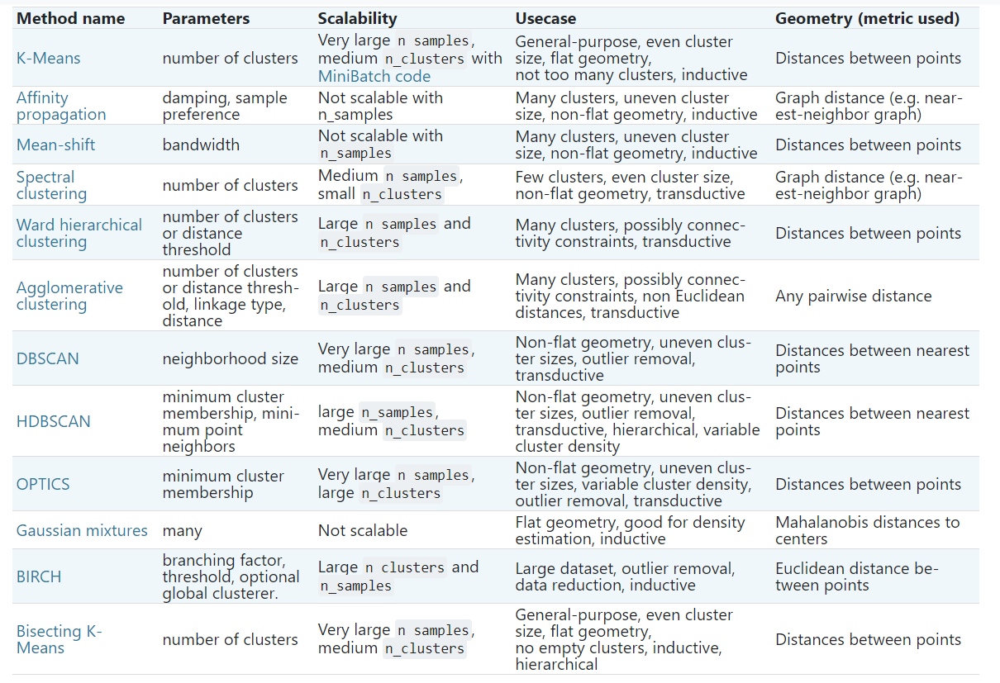

# 0. Approach in this notebook

# I. Data-Driven Technique - K-MEANS - With one-hot encoded categorical features

In [5]:
# ==================================================================================================
# GET 1. DATASET WITH NUMERICAL & ENCODED CATEGORICAL FEATURE AND 2. DATASET WITH NUMERICAL ONLY
# ==================================================================================================
df_data_numeric = df_data.select_dtypes(include=[np.number])
df_data_kmeans_without_cf = pd.concat([df_data_numeric], axis=1) # first copy of df_data without encoded categorical encoded features
df_data_bool = df_data.select_dtypes(include=[bool]).astype(int)
df_data_kmeans_with_cf = pd.concat([df_data_numeric, df_data_bool], axis=1) # copy of df_data with encoded categorical encoded features

# Get the features name by categories
categorical_features = list(df_data_kmeans_with_cf.select_dtypes(exclude=['int32', 'int64', 'float64', 'uint8']).columns)
display('There are :  one-hot encoded categorical features',len(categorical_features))
numerical_features = list(df_data_kmeans_with_cf.select_dtypes(include=['int32', 'int64','float64', 'uint8']).columns)
display('There are :  numerical features',len(numerical_features))


# ==================================================================================================
# Choice of the Preprocessor
# Uncomment the one you want. 
# ==================================================================================================
# Preprocessor - TEST 0 
preprocessor = None


# Preprocessor - TEST 1 
# scaler = MinMaxScaler()

# preprocessor = ColumnTransformer([
#     ('scaler', scaler, numerical_features)])


# Preprocessor - TEST 2
# scaler = StandardScaler()

# preprocessor = ColumnTransformer([
#     ('scaler', scaler, numerical_features)])


# Preprocessor - TEST 3
# scaler = PowerTransformer()  # Use PowerTransformer

# preprocessor = ColumnTransformer([
#     ('scaler', scaler, numerical_features)])


'There are :  one-hot encoded categorical features'

0

'There are :  numerical features'

118

## I.1. Choice of the number of cluster - Data-Driven Technique 1 -  Elbow method, Silhoutette, and Calinski Harabasz. 

[68.45016546349846, 54.39087701255693, 34.57462154937148, 29.23173492960931, 34.107513121315826, 19.40272383990942]


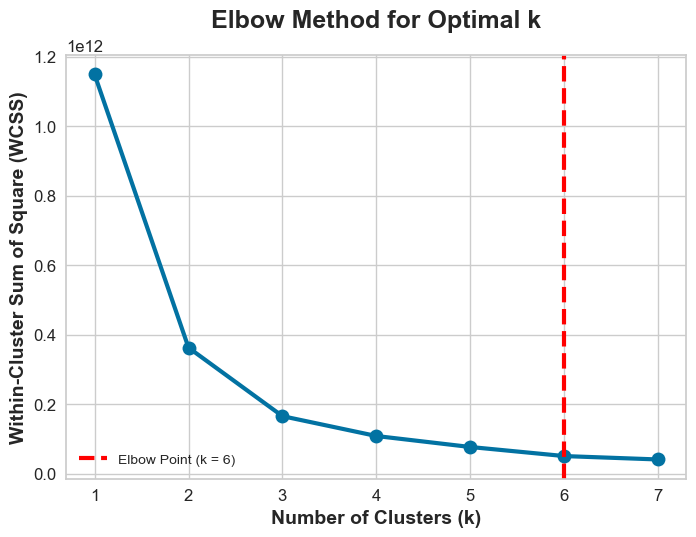

Elbow Point (k = 6)


In [6]:
# ==================================================================================================
# Search the optimal number of cluster using Elbow Curve method
# ==================================================================================================
# Initialize an empty list to store the within-cluster sum of squares (WCSS)
wcss = []

# Define a range of clusters to try
max_clusters = 7
k_values = range(1, max_clusters + 1)

# Calculate the WCSS for different values of k
for k in k_values:
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(df_data_kmeans_with_cf)
    wcss.append(kmeans.inertia_)

# Calculate the percentage decrease in WCSS between successive numbers of clusters
percentage_decrease = [(wcss[i - 1] - wcss[i]) / wcss[i - 1] * 100 for i in range(1, len(wcss))]
print(percentage_decrease)

# Find the index corresponding to a significant drop-off in percentage decrease
threshold_percentage_decrease = 25  # Adjust as needed
elbow_point_index = next((i for i, decrease in enumerate(percentage_decrease) if decrease < threshold_percentage_decrease), None)+1


# ==================================================================================================
# PLOT THE ELBOW CURVE
# ==================================================================================================
# Plot the elbow curve
plt.plot(k_values, wcss, marker='o')
plt.xlabel('Number of Clusters (k)', fontsize=14, fontweight='bold')
plt.ylabel('Within-Cluster Sum of Square (WCSS)',fontsize=14, fontweight='bold')
plt.title('Elbow Method for Optimal k',fontsize=18, fontweight='bold')
plt.grid(True)

# Highlight the elbow point
if elbow_point_index is not None:
    plt.axvline(x=elbow_point_index, color='red', linestyle='--', label=f'Elbow Point (k = {elbow_point_index})')
    plt.legend()

plt.show()

# Print elbow point information
if elbow_point_index is not None:
    print(f'Elbow Point (k = {elbow_point_index})')
else:
    print('No significant elbow point found.')



Visualizer for distortion:


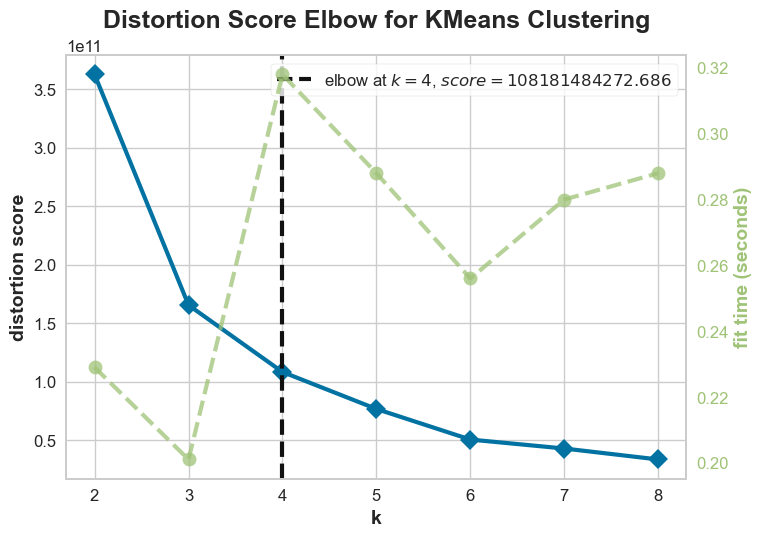

Visualizer for silhouette:


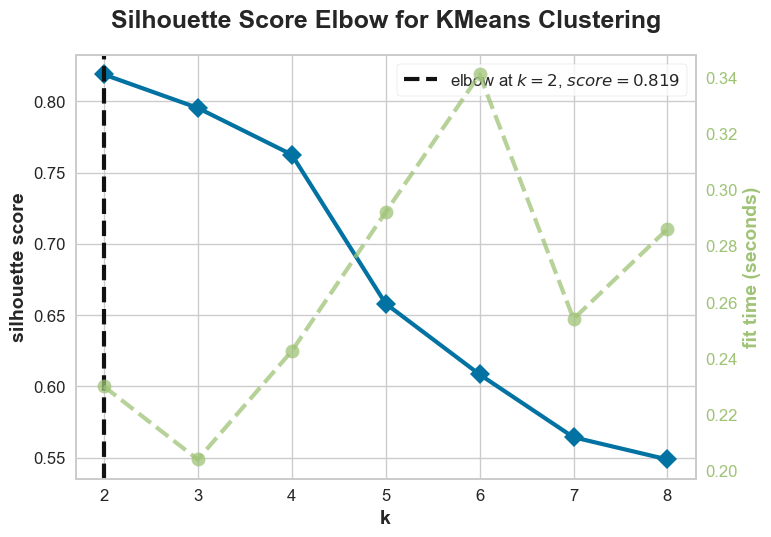

Visualizer for calinski_harabasz:


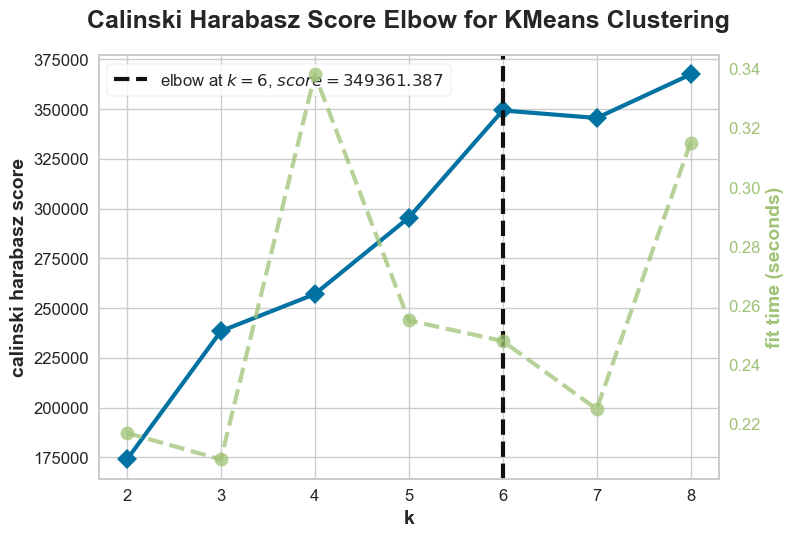

In [7]:
# ==================================================================================================
# PLOT THE ELBOW CURVE WITH YELLOWBRICK
# ==================================================================================================
metrics_to_use = ['distortion', 'silhouette', 'calinski_harabasz']

# Create a visualizer for each metric and display it
for metric in metrics_to_use:
    # Create the visualizer for the current metric
    kmeans_visualizer = Pipeline([
        ("preprocessor", preprocessor),
        ("kelbowvisualizer", KElbowVisualizer(KMeans(), k=(2, 9), metric=metric))
    ])

    # Fit the visualizer to your data
    kmeans_visualizer.fit(df_data_kmeans_with_cf)

    # Show the visualizer for the current metric
    print(f'Visualizer for {metric}:')
    kmeans_visualizer.named_steps['kelbowvisualizer'].poof()

## I.2. Choice of the number of cluster - Data-Driven Technique 2 -  SILHOUETTE VISUALIZER

Calculating Silhouette scores for 2 clusters...


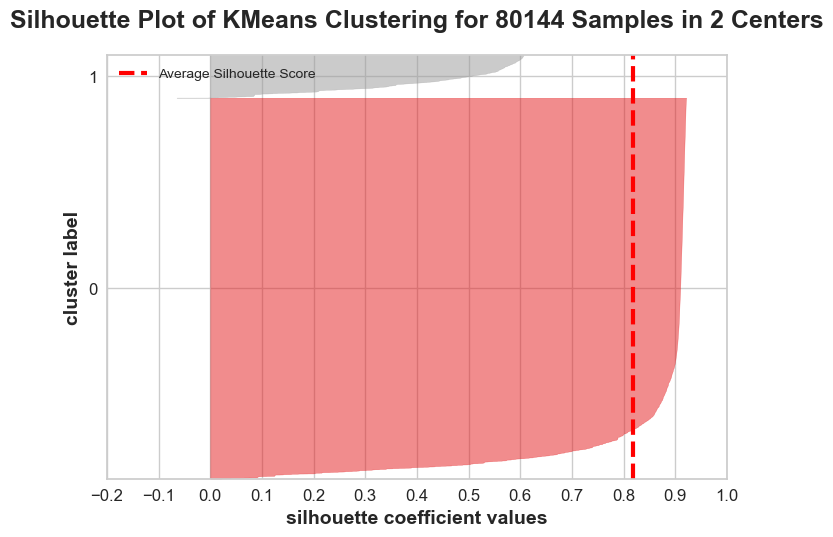

Calculating Silhouette scores for 3 clusters...


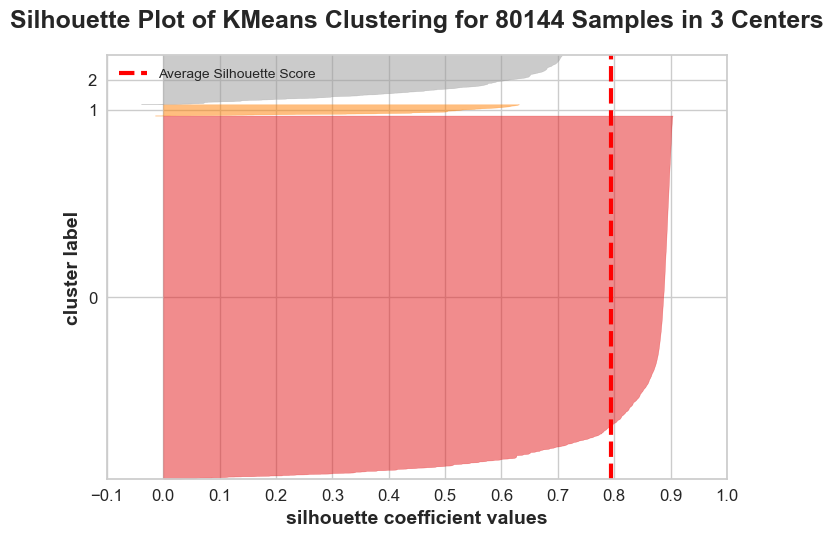

Calculating Silhouette scores for 4 clusters...


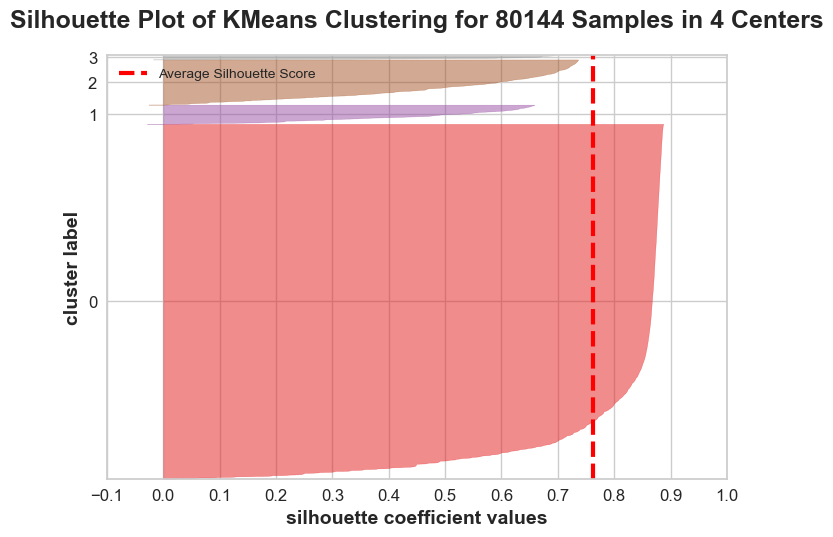

Calculating Silhouette scores for 5 clusters...


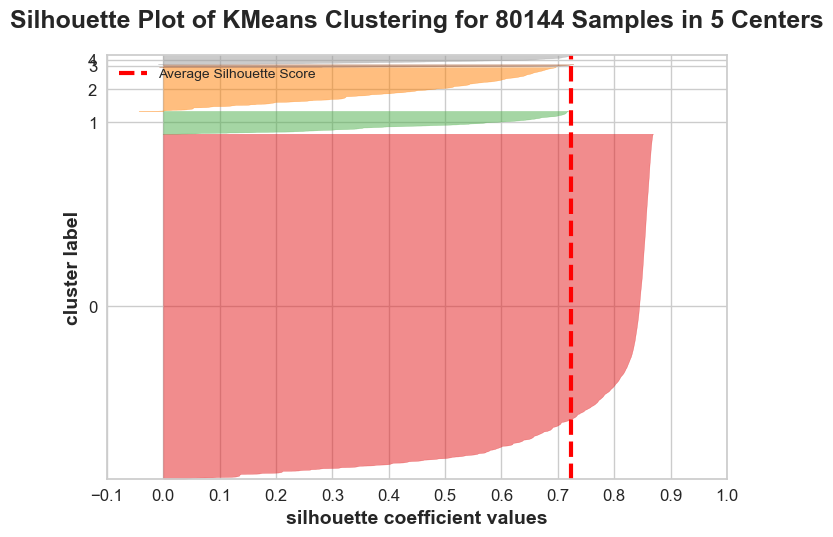

Calculating Silhouette scores for 6 clusters...


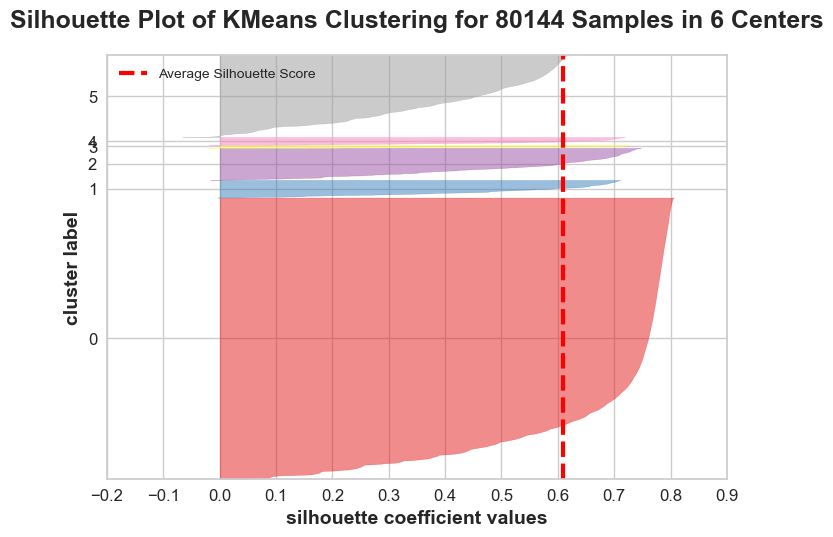

Calculating Silhouette scores for 7 clusters...


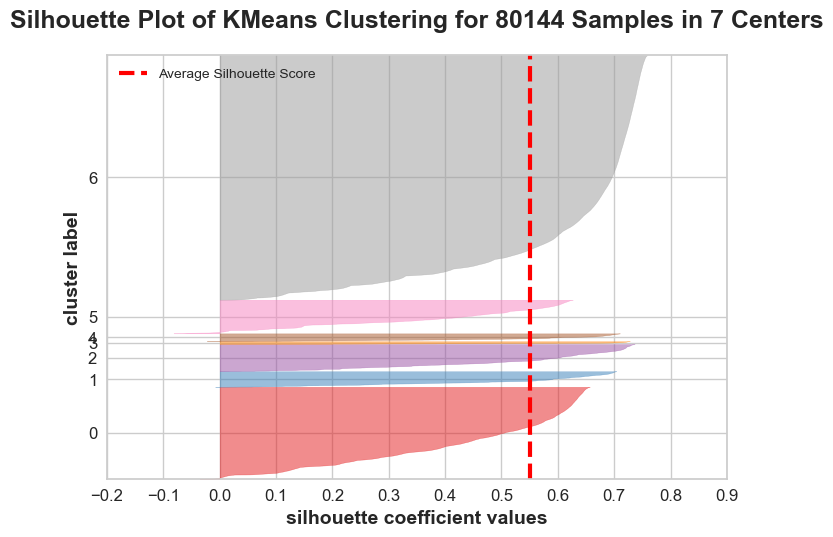

Calculating Silhouette scores for 8 clusters...


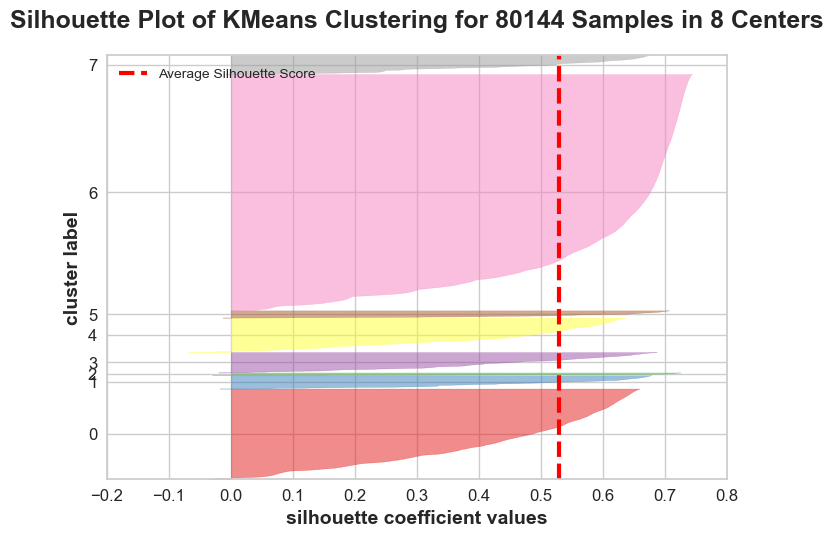

In [8]:
# ==================================================================================================
# SILHOUETTE VISUALIZER WITH YELLOWBRICK
# ==================================================================================================
# Define the range of clusters to try
min_clusters = 2
max_clusters = 8

# Loop through each number of clusters and create Silhouette plots
for num_clusters in range(min_clusters, max_clusters + 1):
    print(f"Calculating Silhouette scores for {num_clusters} clusters...")

    # Instantiate the pipeline with KMeans and SilhouetteVisualizer
    silhouette_visualizer = Pipeline([
        ("preprocessor", preprocessor),
        ("silhouettevisualizer", SilhouetteVisualizer(KMeans(n_clusters=num_clusters, random_state=42)))
    ])

    # Fit the pipeline to your data
    silhouette_visualizer.fit(df_data_kmeans_with_cf)

    # Show the silhouette visualizer for the current number of clusters
    silhouette_visualizer.named_steps['silhouettevisualizer'].poof()

## I.3. Choice of the number of cluster - Data-Driven Technique 3 -  Intercluster Distance Maps using MDS

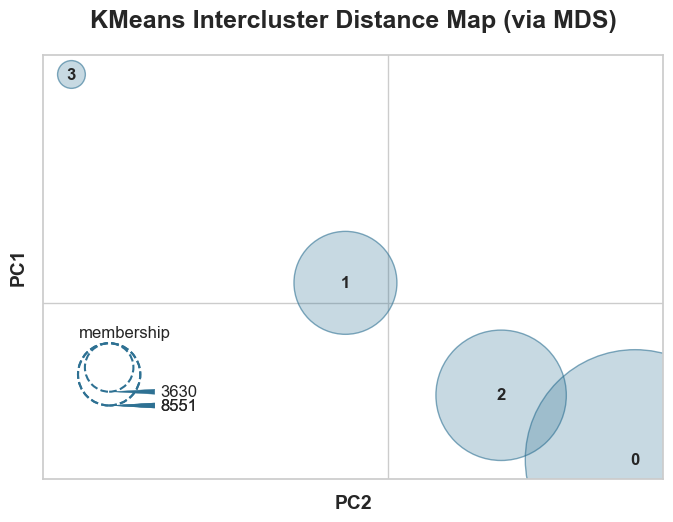

Number of customers in each cluster:
0    67183
2     8551
1     3630
3      780
Name: count, dtype: int64


In [9]:
# ==================================================================================================
# Intercluster Distance Maps WITH YELLOWBRICK
# ==================================================================================================
nb_cluster = 4
distance_intercluster_visualizer = Pipeline([
    ("preprocessor", preprocessor),
    ("distancevisualizer", InterclusterDistance(KMeans(nb_cluster, random_state=42, n_init='auto')))])
distance_intercluster_visualizer.fit(df_data_kmeans_with_cf)
distance_intercluster_visualizer.named_steps['distancevisualizer'].show()


# ==================================================================================================
# NB of CUSTOMERS by CLUSTER
# ==================================================================================================
# Get the labels assigned to each data point
cluster_labels = distance_intercluster_visualizer.named_steps['distancevisualizer'].labels_

# Count the number of customers in each cluster
cluster_counts = pd.Series(cluster_labels).value_counts()

# Print the number of customers in each cluster
print("Number of customers in each cluster:")
print(cluster_counts)

## I.4. Empirical evaluation of the impact of k-means initialization

Evaluation of KMeans with random init
Evaluation of MiniBatchKMeans with k-means++ init


D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\sklearn\cluster\_kmeans.py:1972: UserWarning: MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 2048 or by setting the environment variable OMP_NUM_THREADS=4
  warnings.warn(
D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\sklearn\cluster\_kmeans.py:1972: UserWarning: MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 2048 or by setting the environment variable OMP_NUM_THREADS=4
  warnings.warn(
D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\sklearn\cluster\_kmeans.py:1972: UserWarning: MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 2048 or by setting the environment variable OMP_NUM_THREADS=4
  warnings.warn

Evaluation of MiniBatchKMeans with random init


D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\sklearn\cluster\_kmeans.py:1972: UserWarning: MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 2048 or by setting the environment variable OMP_NUM_THREADS=4
  warnings.warn(
D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\sklearn\cluster\_kmeans.py:1972: UserWarning: MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 2048 or by setting the environment variable OMP_NUM_THREADS=4
  warnings.warn(
D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\sklearn\cluster\_kmeans.py:1972: UserWarning: MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 2048 or by setting the environment variable OMP_NUM_THREADS=4
  warnings.warn

Evaluation of KMeans with k-means++ init


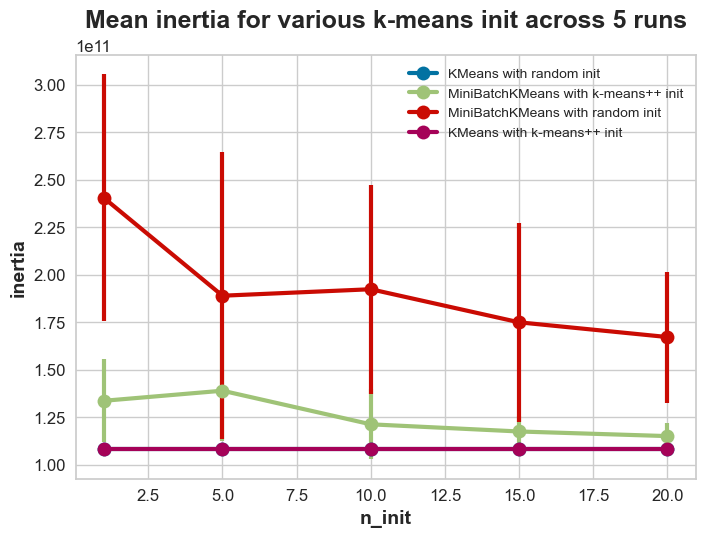

In [10]:
# ==================================================================================================
# Cluster Stability at the Initialization
# ==================================================================================================
# Set the random state
random_state = np.random.RandomState(42)

# Number of runs for each strategy
n_runs = 5

# Number of initializations
n_init_range = np.array([1, 5, 10, 15, 20])

X = df_data_kmeans_with_cf.values

plt.figure()
plots = []
legends = []

cases = [
    (KMeans, "random", {}, "o-"),
    (MiniBatchKMeans, "k-means++", {"max_no_improvement": 3}, "x-"),
    (MiniBatchKMeans, "random", {"max_no_improvement": 3, "init_size": 500}, "d-"),
    (KMeans, "k-means++", {}, "^-"),
]

for factory, init, params, format in cases:
    print("Evaluation of %s with %s init" % (factory.__name__, init))
    inertia = np.empty((len(n_init_range), n_runs))

    for run_id in range(n_runs):
        for i, n_init in enumerate(n_init_range):
            km = factory(
                n_clusters=nb_cluster,
                init=init,
                random_state=check_random_state(random_state),
                n_init=n_init,
                **params,
            ).fit(X)
            inertia[i, run_id] = km.inertia_
    p = plt.errorbar(
        n_init_range, inertia.mean(axis=1), inertia.std(axis=1), fmt='-o'
    )
    plots.append(p[0])
    legends.append("%s with %s init" % (factory.__name__, init))

plt.xlabel("n_init")
plt.ylabel("inertia")
plt.legend(plots, legends)
plt.title("Mean inertia for various k-means init across %d runs" % n_runs)
plt.show()


## I.4. CLUSTERING - K MEANS

In [11]:
# ==================================================================================================
# APPLY THE K-MEANS NOW. 
# ==================================================================================================
# Set the number of clusters based on the elbow method or any other criterion
num_clusters = nb_cluster

# Define the pipeline including preprocessing and KMeans
kmeans_pipeline = Pipeline([
    ("preprocessor", preprocessor),  # Assuming you have defined preprocessor earlier
    ("kmeans", KMeans(n_clusters=num_clusters, random_state=42, n_init='auto'))
])

# Fit the pipeline to the RFM dataset
kmeans_pipeline.fit(df_data_kmeans_with_cf)

# Get the cluster labels for each data point
cluster_labels = kmeans_pipeline.named_steps['kmeans'].labels_

# Add the cluster labels to the DataFrame
df_data_kmeans_with_cf['cluster'] = cluster_labels


# ==================================================================================================
# GET SOME STATS ON THE CLUSTERS
# ==================================================================================================
# Iterate over each cluster label
for cluster_label in range(num_clusters):
    # Count the number of customers in the current cluster
    cluster_count = len(df_data_kmeans_with_cf[df_data_kmeans_with_cf['cluster'] == cluster_label])
    # Print the count for the current cluster
    print(f'CLUSTER {cluster_label} contains {cluster_count} customers')

# ==================================================================================================
# SILHOUETTE SCORE
# ==================================================================================================
# Compute the silhouette score
silhouette_avg = silhouette_score(df_data_kmeans_with_cf.drop(columns=['cluster']), cluster_labels)
print(f"Silhouette Score: {silhouette_avg}")

# ==================================================================================================
# DAVIES-BOULDIN
# ==================================================================================================
# Compute the Davies-Bouldin index
davies_bouldin_idx = davies_bouldin_score(df_data_kmeans_with_cf.drop(columns=['cluster']), cluster_labels)
print(f"Davies-Bouldin Index: {davies_bouldin_idx}")

CLUSTER 0 contains 67183 customers
CLUSTER 1 contains 3630 customers
CLUSTER 2 contains 8551 customers
CLUSTER 3 contains 780 customers
Silhouette Score: 0.7625716195068838
Davies-Bouldin Index: 0.5181365002980454


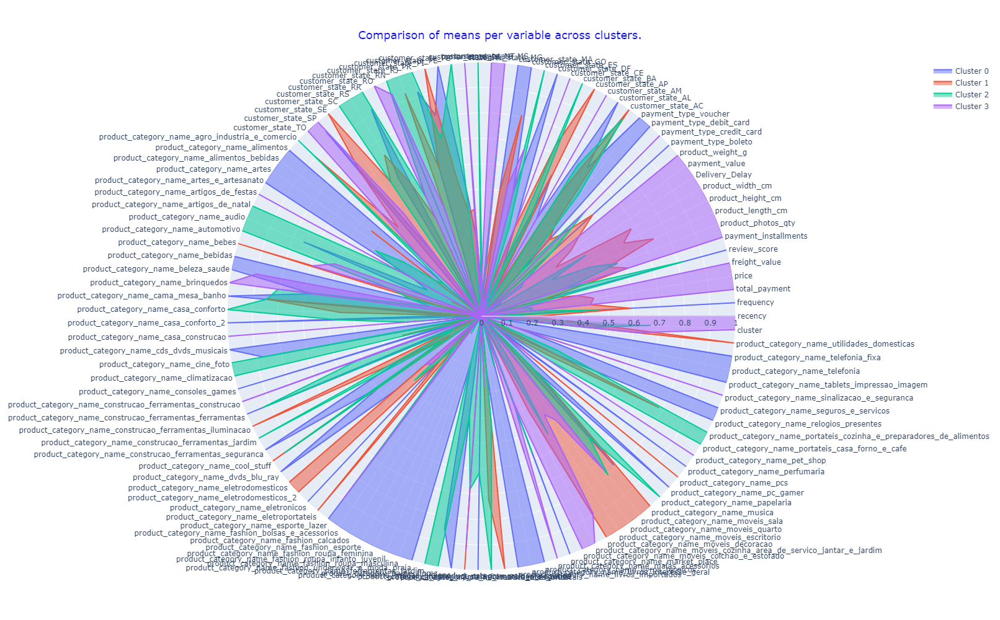

In [12]:
# ==================================================================================================
# DIFFERENCES BETWEEN CLUSTERS - Radar Plot using Plotly
# ==================================================================================================
def plot_radars(data, group, width=800, height=600):
    """
    Plot a radar plot (spider plot) to compare means per variable across clusters.

    Args:
    - data (DataFrame): The input data containing cluster labels and numerical features.
    - group (str): The column name indicating the cluster labels.
    - width (int, optional): Width of the plot in pixels. Default is 800.
    - height (int, optional): Height of the plot in pixels. Default is 600.

    Returns:
    - None: Displays the radar plot using Plotly.

    """
    scaler = MinMaxScaler()
    data = pd.DataFrame(scaler.fit_transform(data), 
                        index=data.index,
                        columns=data.columns).reset_index()
    
    fig = go.Figure()

    # Sort the data by the cluster labels
    data_sorted = data.sort_values(by=[group])

    for k in data_sorted[group].unique():
        cluster_data = data_sorted[data_sorted[group] == k]
        fig.add_trace(go.Scatterpolar(
            r=cluster_data.iloc[:, 1:].values.reshape(-1),
            theta=data.columns[1:],
            fill='toself',
            name='Cluster ' + str(k)
        ))

    fig.update_layout(
        polar=dict(
            radialaxis=dict(
                visible=True,
                range=[0, 1]
            )),
        showlegend=True,
        title={
            'text': "Comparison of means per variable across clusters.",
            'y': 0.95,
            'x': 0.5,
            'xanchor': 'center',
            'yanchor': 'top'},
        title_font_color="blue",
        title_font_size=18,
        width=width,
        height=height)

    fig.show()


numerical_features = list(df_data_kmeans_with_cf.select_dtypes(include=['int32', 'int64','float64', 'uint8']).columns)
# Preprocessor
scaler = MinMaxScaler()

preprocessor = ColumnTransformer([
    ('scaler', scaler, numerical_features)])
X_scaled = preprocessor.fit_transform(df_data_kmeans_with_cf)
X_scaled = pd.DataFrame(X_scaled, index=df_data_kmeans_with_cf.index, columns=df_data_kmeans_with_cf.columns)
X_scaled["kmeans_label"] = cluster_labels
X_scaled_clusters = X_scaled.groupby("kmeans_label").mean()
X_scaled_clusters


plot_radars(data=X_scaled_clusters, group="kmeans_label", width=1200, height=1000)

In [13]:
X_scaled_clusters

,recency,frequency,total_payment,price,freight_value,review_score,payment_installments,product_photos_qty,product_length_cm,product_height_cm,product_width_cm,Delivery_Delay,payment_value,product_weight_g,payment_type_boleto,payment_type_credit_card,payment_type_debit_card,payment_type_voucher,customer_state_AC,customer_state_AL,customer_state_AM,customer_state_AP,customer_state_BA,customer_state_CE,customer_state_DF,customer_state_ES,customer_state_GO,customer_state_MA,customer_state_MG,customer_state_MS,customer_state_MT,customer_state_PA,customer_state_PB,customer_state_PE,customer_state_PI,customer_state_PR,customer_state_RJ,customer_state_RN,customer_state_RO,customer_state_RR,customer_state_RS,customer_state_SC,customer_state_SE,customer_state_SP,customer_state_TO,product_category_name_agro_industria_e_comercio,product_category_name_alimentos,product_category_name_alimentos_bebidas,product_category_name_artes,product_category_name_artes_e_artesanato,product_category_name_artigos_de_festas,product_category_name_artigos_de_natal,product_category_name_audio,product_category_name_automotivo,product_category_name_bebes,product_category_name_bebidas,product_category_name_beleza_saude,product_category_name_brinquedos,product_category_name_cama_mesa_banho,product_category_name_casa_conforto,product_category_name_casa_conforto_2,product_category_name_casa_construcao,product_category_name_cds_dvds_musicais,product_category_name_cine_foto,product_category_name_climatizacao,product_category_name_consoles_games,product_category_name_construcao_ferramentas_construcao,product_category_name_construcao_ferramentas_ferramentas,product_category_name_construcao_ferramentas_iluminacao,product_category_name_construcao_ferramentas_jardim,product_category_name_construcao_ferramentas_seguranca,product_category_name_cool_stuff,product_category_name_dvds_blu_ray,product_category_name_eletrodomesticos,product_category_name_eletrodomesticos_2,product_category_name_eletronicos,product_category_name_eletroportateis,product_category_name_esporte_lazer,product_category_name_fashion_bolsas_e_acessorios,product_category_name_fashion_calcados,product_category_name_fashion_esporte,product_category_name_fashion_roupa_feminina,product_category_name_fashion_roupa_infanto_juvenil,product_category_name_fashion_roupa_masculina,product_category_name_fashion_underwear_e_moda_praia,product_category_name_ferramentas_jardim,product_category_name_flores,product_category_name_fraldas_higiene,product_category_name_industria_comercio_e_negocios,product_category_name_informatica_acessorios,product_category_name_instrumentos_musicais,product_category_name_la_cuisine,product_category_name_livros_importados,product_category_name_livros_interesse_geral,product_category_name_livros_tecnicos,product_category_name_malas_acessorios,product_category_name_market_place,product_category_name_moveis_colchao_e_estofado,product_category_name_moveis_cozinha_area_de_servico_jantar_e_jardim,product_category_name_moveis_decoracao,product_category_name_moveis_escritorio,product_category_name_moveis_quarto,product_category_name_moveis_sala,product_category_name_musica,product_category_name_papelaria,product_category_name_pc_gamer,product_category_name_pcs,product_category_name_perfumaria,product_category_name_pet_shop,product_category_name_portateis_casa_forno_e_cafe,product_category_name_portateis_cozinha_e_preparadores_de_alimentos,product_category_name_relogios_presentes,product_category_name_seguros_e_servicos,product_category_name_sinalizacao_e_seguranca,product_category_name_tablets_impressao_imagem,product_category_name_telefonia,product_category_name_telefonia_fixa,product_category_name_utilidades_domesticas,cluster
kmeans_label,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0,0.34,2.14e-03,0.02,0.01,0.04,0.81,0.11,0.07,0.21,0.11,0.13,0.39,0.02,0.02,0.21,0.76,0.02,1.32e-02,7.89e-04,4.41e-03,1.65e-03,6.85e-04,0.03,0

In [14]:
# # ==================================================================================================
# # PAIRWISE SCATTER PLOTS BY CLUSTER
# # ==================================================================================================

# # Define the numerical features for plotting
# # numerical_features = df_data_kmeans_with_cf.select_dtypes(include=np.number).columns.tolist()
# numerical_features = list(df_data_kmeans_with_cf.select_dtypes(include=['int64','float64', 'uint8']).columns)

# # Plot pairwise scatter plots colored by cluster
# g = sns.pairplot(data=df_data_kmeans_with_cf, vars=numerical_features, hue='cluster', palette='viridis')

# plt.suptitle('Pairwise Scatter Plots Colored by Cluster', fontsize=18, fontweight='bold')
# plt.show()

D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will 

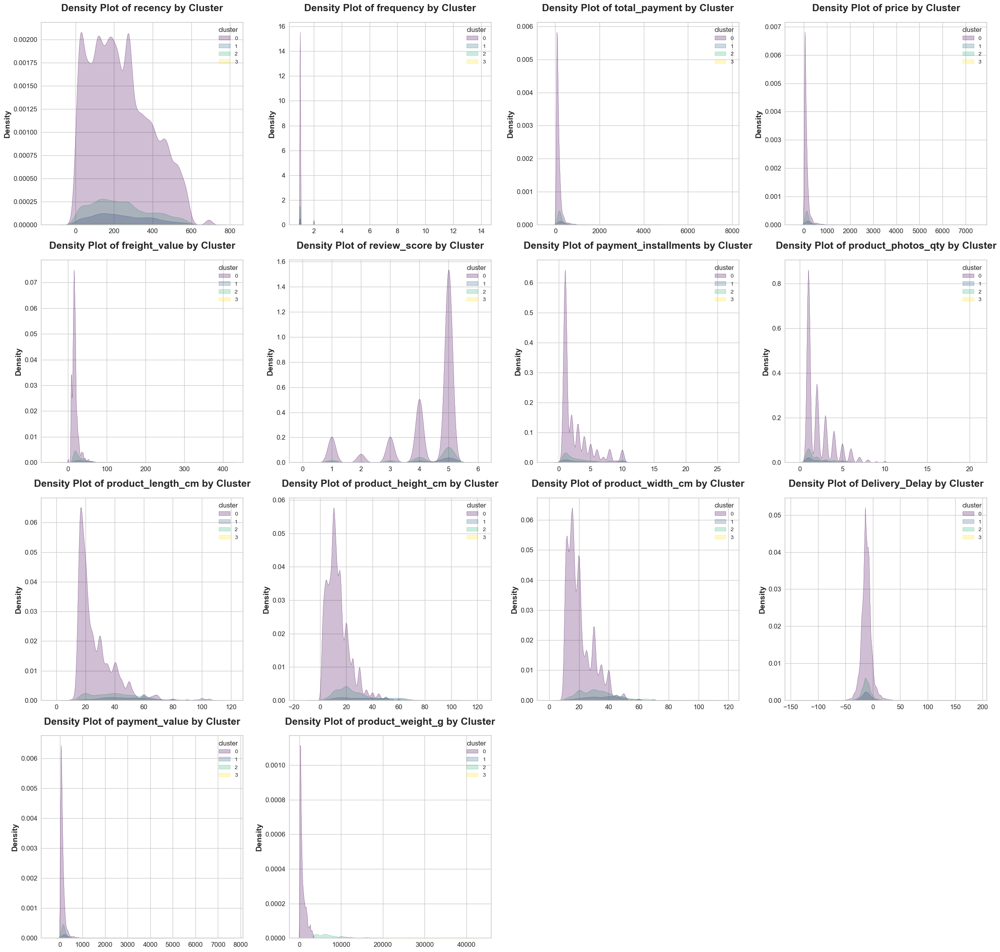

In [15]:
# ==================================================================================================
# DENSITY PLOTS BY CLUSTER
# ==================================================================================================
# Define the numerical features for plotting
# numerical_features = df_data.select_dtypes(include=np.number).columns.tolist()
numerical_features = list(df_data_kmeans_with_cf.select_dtypes(include=['int64','float64', 'uint8']).columns)

# Calculate the number of rows for subplots
num_features = len(numerical_features)
num_rows = (num_features + 3) // 4  # Round up to the nearest integer

# Define the size of the figure
fig_width = 25  # Adjust as needed
fig_height = num_rows * 6  # Adjust as needed

# Create subplots with a larger figure size
fig, axes = plt.subplots(num_rows, 4, figsize=(fig_width, fig_height))

# Flatten axes if only one row
if num_rows == 1:
    axes = [axes]

# Plot density plots for each numerical feature
for i, feature in enumerate(numerical_features):
    row_index = i // 4
    col_index = i % 4
    ax = axes[row_index][col_index]
    
    sns.kdeplot(data=df_data_kmeans_with_cf, x=feature, hue='cluster', palette='viridis', fill=True, ax=ax)
    ax.set_title(f'Density Plot of {feature} by Cluster')
    ax.set_xlabel('')
    ax.set_ylabel('Density')

# Remove empty subplots
if num_features % 4 != 0:
    for i in range(num_features % 4, 4):
        axes[-1][i].remove()

# Adjust layout
plt.tight_layout()
plt.show()

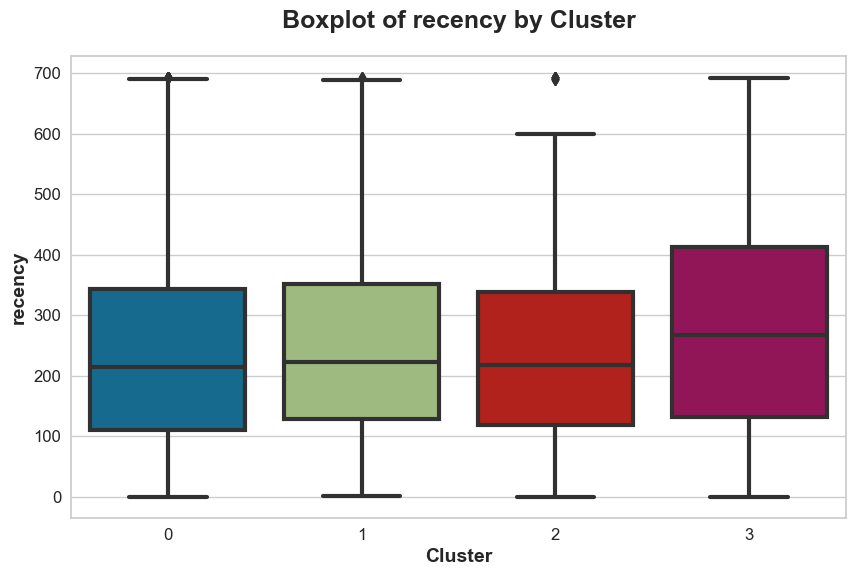

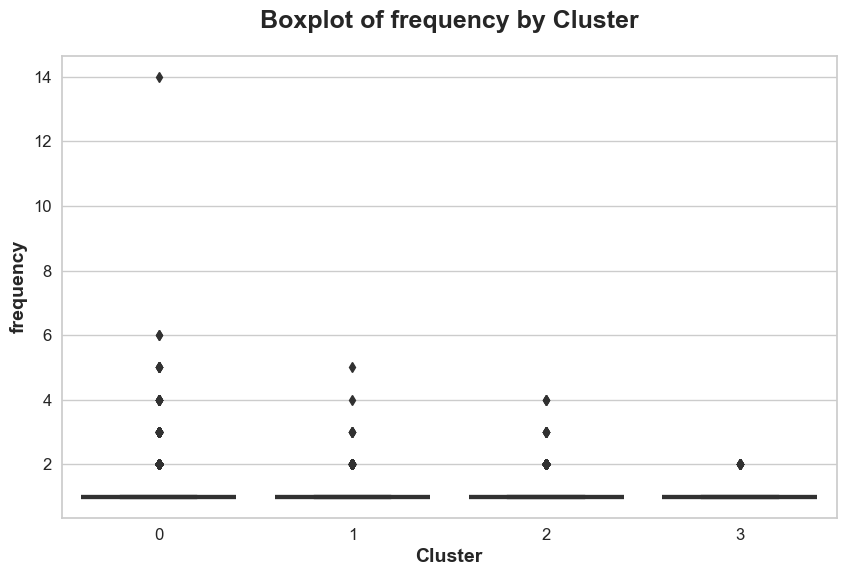

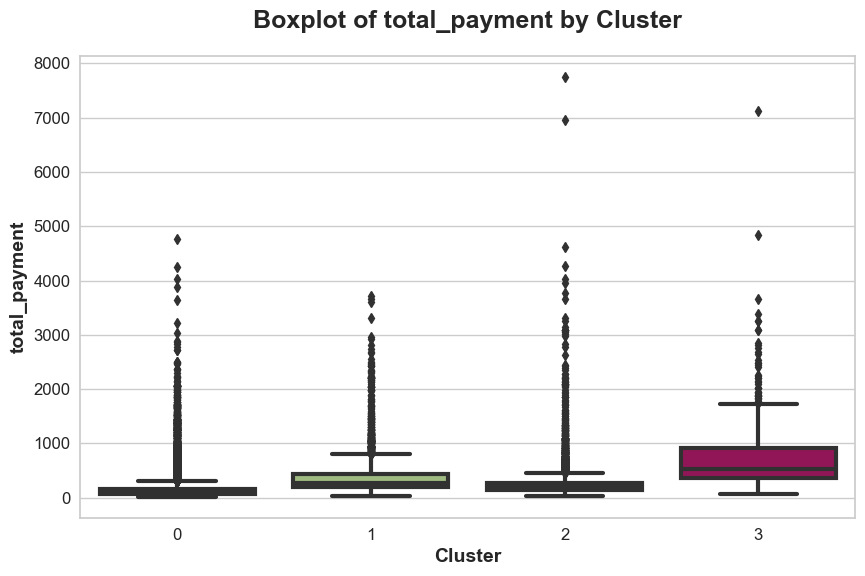

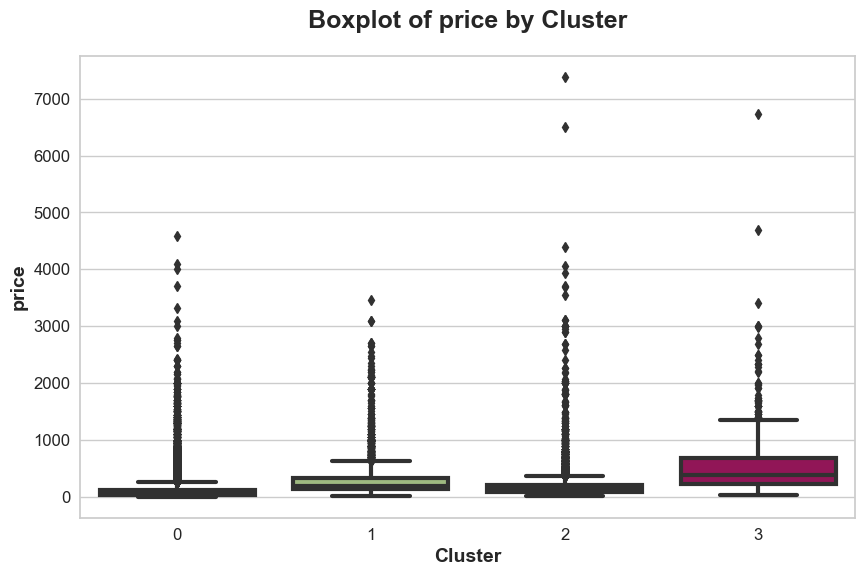

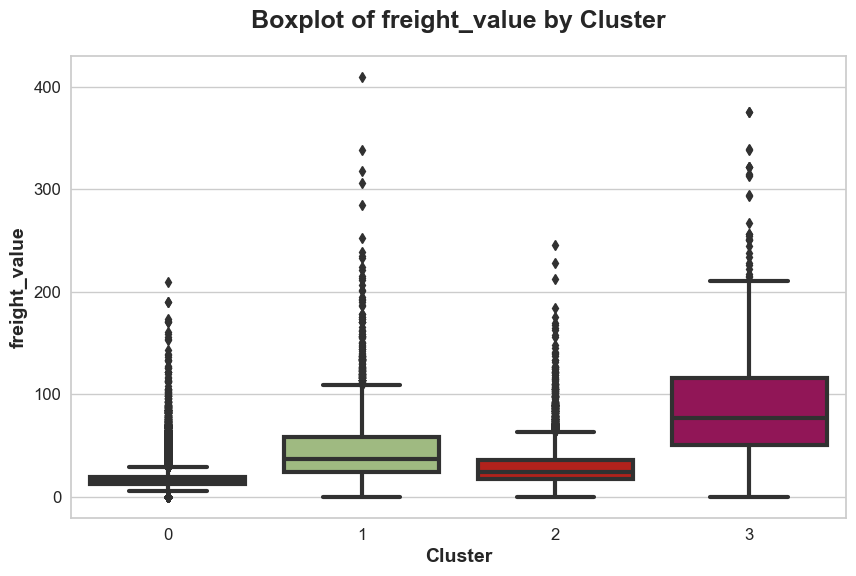

...

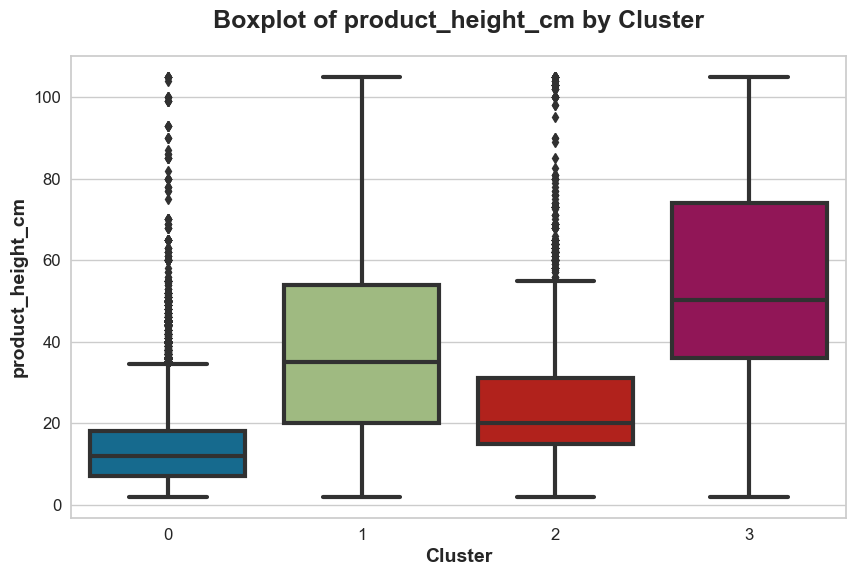

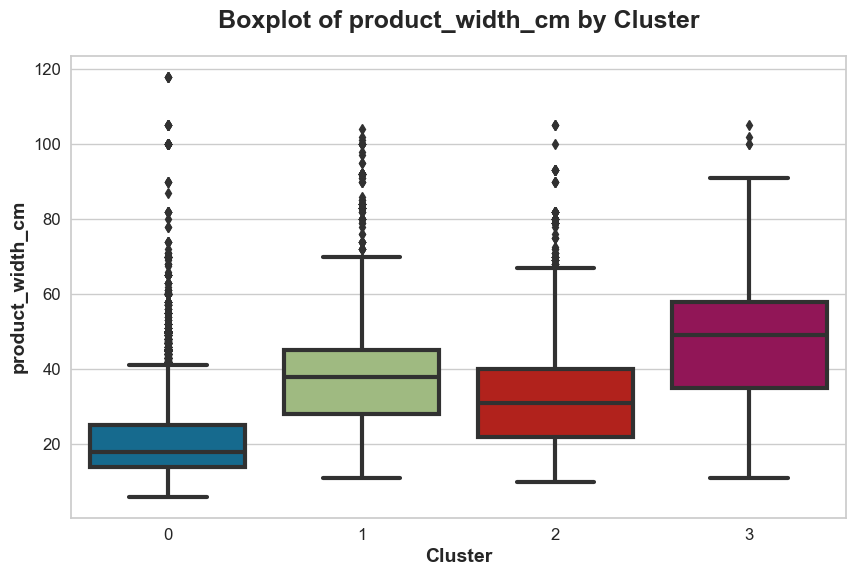

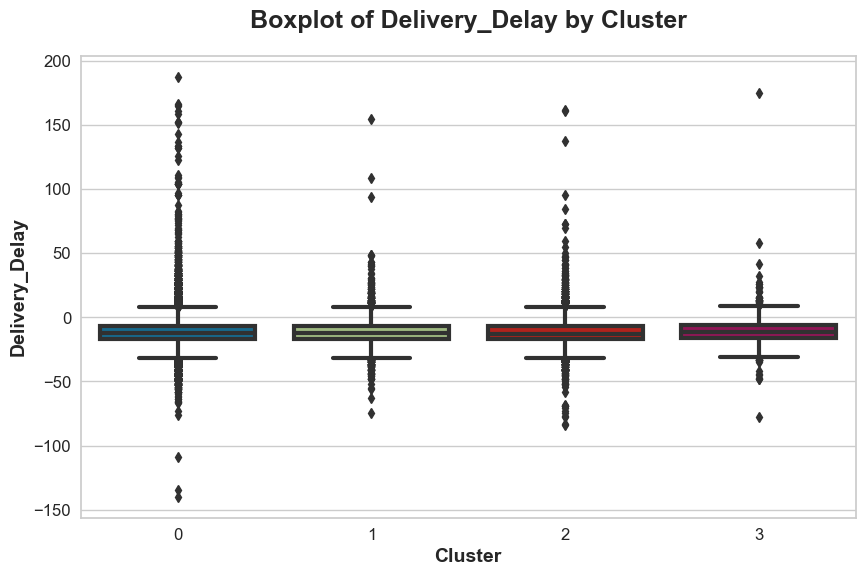

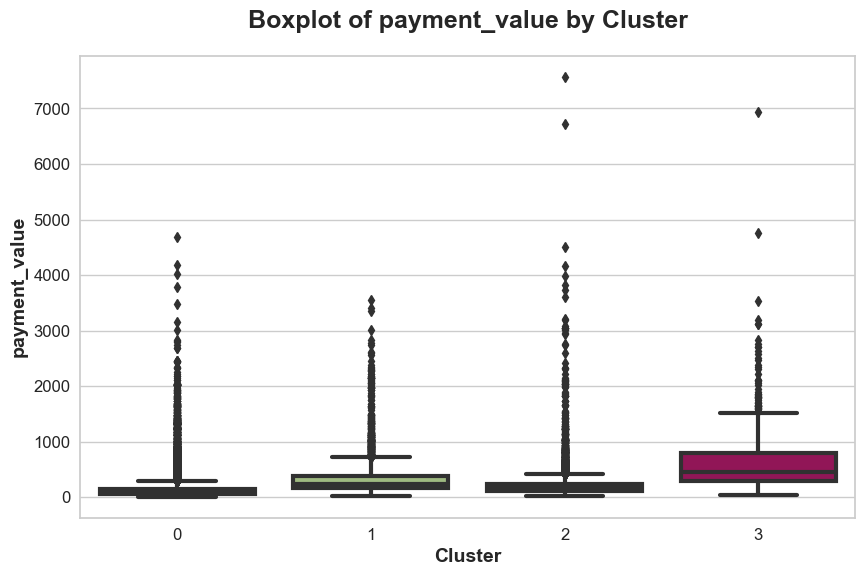

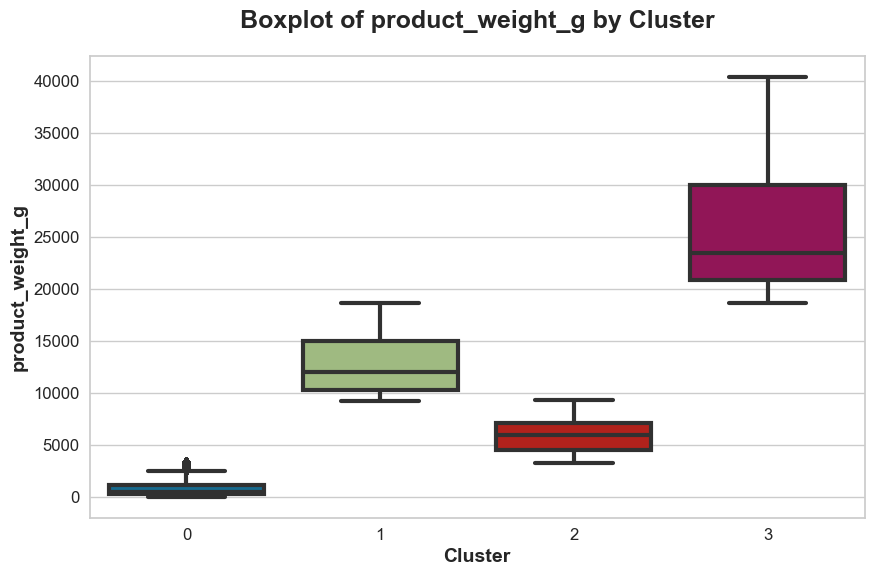

In [16]:
# Define the features used for clustering
# numerical_features = df_data.select_dtypes(include=np.number).columns.tolist()
numerical_features = list(df_data_kmeans_with_cf.select_dtypes(include=['int64','float64', 'uint8']).columns)

# Iterate over each feature and create a boxplot for each cluster
for feature in numerical_features:
    plt.figure(figsize=(10, 6))
    sns.boxplot(x='cluster', y=feature, data=df_data_kmeans_with_cf)
    plt.title(f'Boxplot of {feature} by Cluster')
    plt.xlabel('Cluster')
    plt.ylabel(feature)
    plt.show()

# II. Data-Driven Technique - K-MEANS - Without one-hot encoded categorical features

## II.1. Choice of the number of cluster - Data-Driven Technique 1 -  Elbow method, Silhoutette, and Calinski Harabasz

In [17]:
numerical_features = list(df_data_kmeans_with_cf.select_dtypes(include=['int64','float64', 'uint8']).columns) # without the encodec categorical features
display('There are :  numerical features',len(numerical_features))

# ==================================================================================================
# Choice of the Preprocessor
# ==================================================================================================
# Preprocessor - TEST 0 
preprocessor = None


# Preprocessor - TEST 1 
# scaler = MinMaxScaler()

# preprocessor = ColumnTransformer([
#     ('scaler', scaler, numerical_features)])


# Preprocessor - TEST 2
# scaler = StandardScaler()

# preprocessor = ColumnTransformer([
#     ('scaler', scaler, numerical_features)])


# Preprocessor - TEST 3
# scaler = PowerTransformer()  # Use PowerTransformer

# preprocessor = ColumnTransformer([
#     ('scaler', scaler, numerical_features)])

'There are :  numerical features'

14

In [18]:
df_data_kmeans_without_cf

,recency,frequency,total_payment,price,freight_value,review_score,payment_installments,product_photos_qty,product_length_cm,product_height_cm,product_width_cm,Delivery_Delay,payment_value,product_weight_g
0,111,1,153.90,129.90,12.00,5.0,8.0,1.0,34.0,7.0,32.0,-5.0,141.90,1500.0
1,114,1,35.48,18.90,8.29,4.0,1.0,1.0,26.0,11.0,18.0,-5.0,27.19,375.0
2,536,1,103.44,69.00,17.22,3.0,8.0,3.0,25.0,50.0,35.0,-2.0,86.22,1500.0
3,320,1,61.25,25.99,17.63,4.0,4.0,5.0,19.0,5.0,11.0,-12.0,43.62,150.0
4,287,1,213.78,180.00,16.89,5.0,6.0,3.0,16.0,3.0,11.0,-8.0,196.89,6050.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
80139,254,1,88.32,58.00,15.16,5.0,1.0,1.0,14.0,9.0,13.0,-23.0,73.16,213.0
80140,261,1,104.27,64.89,19.69,4.0,1.0,2.0,33.0,36.0,27.0,-3.0,84.58,1720.0
80141,567,1,135.02,89.90,22.56,5.0,1.0,5.0,17.0,15.0,13.0,-30.0,112.46,600.0
80142,118,1,152.38,115.00,18.69,5.0,5.0,3.0,20.0,14.0,16.0,-14.0,133.69,444.0


[68.4501658746602, 54.39091608030324, 34.57463242434508, 29.231806438951686, 34.10758719117016, 19.402787688686132]


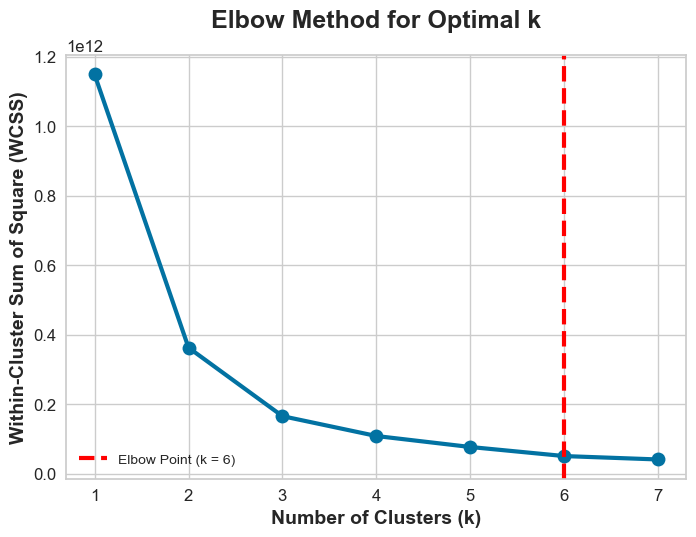

Elbow Point (k = 6)


In [19]:
# ==================================================================================================
# Search the optimal number of cluster using Elbow Curve method
# ==================================================================================================
# Initialize an empty list to store the within-cluster sum of squares (WCSS)
wcss = []

# Define a range of clusters to try
max_clusters = 7
k_values = range(1, max_clusters + 1)

# Calculate the WCSS for different values of k
for k in k_values:
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(df_data_kmeans_without_cf)
    wcss.append(kmeans.inertia_)

# Calculate the percentage decrease in WCSS between successive numbers of clusters
percentage_decrease = [(wcss[i - 1] - wcss[i]) / wcss[i - 1] * 100 for i in range(1, len(wcss))]
print(percentage_decrease)

# Find the index corresponding to a significant drop-off in percentage decrease
threshold_percentage_decrease = 25  # Adjust as needed
elbow_point_index = next((i for i, decrease in enumerate(percentage_decrease) if decrease < threshold_percentage_decrease), None)+1


# ==================================================================================================
# PLOT THE ELBOW CURVE
# ==================================================================================================
# Plot the elbow curve
plt.plot(k_values, wcss, marker='o')
plt.xlabel('Number of Clusters (k)', fontsize=14, fontweight='bold')
plt.ylabel('Within-Cluster Sum of Square (WCSS)',fontsize=14, fontweight='bold')
plt.title('Elbow Method for Optimal k',fontsize=18, fontweight='bold')
plt.grid(True)

# Highlight the elbow point
if elbow_point_index is not None:
    plt.axvline(x=elbow_point_index, color='red', linestyle='--', label=f'Elbow Point (k = {elbow_point_index})')
    plt.legend()

plt.show()

# Print elbow point information
if elbow_point_index is not None:
    print(f'Elbow Point (k = {elbow_point_index})')
else:
    print('No significant elbow point found.')



Visualizer for distortion:


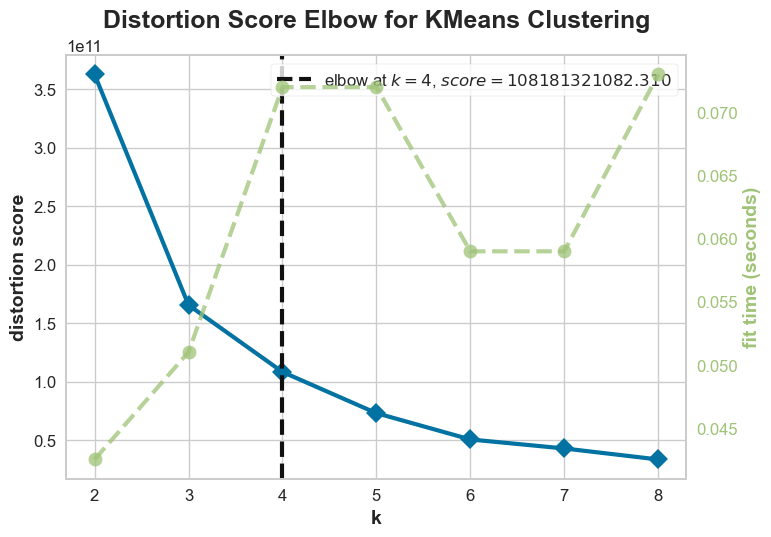

Visualizer for silhouette:


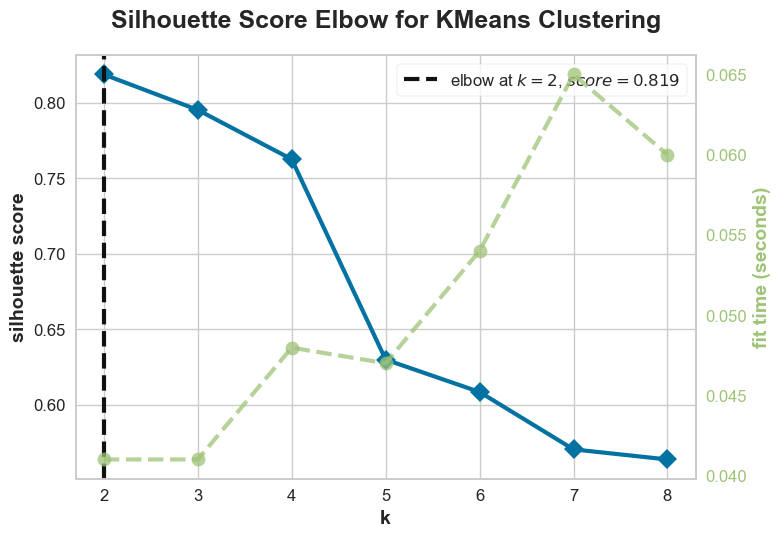

Visualizer for calinski_harabasz:


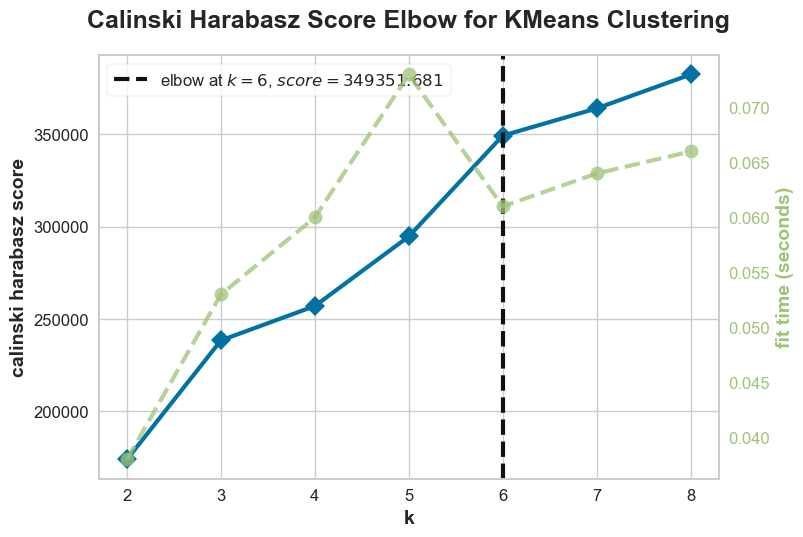

In [20]:
# ==================================================================================================
# PLOT THE ELBOW CURVE WITH YELLOWBRICK
# ==================================================================================================
metrics_to_use = ['distortion', 'silhouette', 'calinski_harabasz']

# Create a visualizer for each metric and display it
for metric in metrics_to_use:
    # Create the visualizer for the current metric
    kmeans_visualizer = Pipeline([
        ("preprocessor", preprocessor),
        ("kelbowvisualizer", KElbowVisualizer(KMeans(), k=(2, 9), metric=metric))
    ])

    # Fit the visualizer to your data
    kmeans_visualizer.fit(df_data_kmeans_without_cf)

    # Show the visualizer for the current metric
    print(f'Visualizer for {metric}:')
    kmeans_visualizer.named_steps['kelbowvisualizer'].poof()

## II.2. Choice of the number of cluster - Data-Driven Technique 2 -  SILHOUETTE VISUALIZER

Calculating Silhouette scores for 4 clusters...


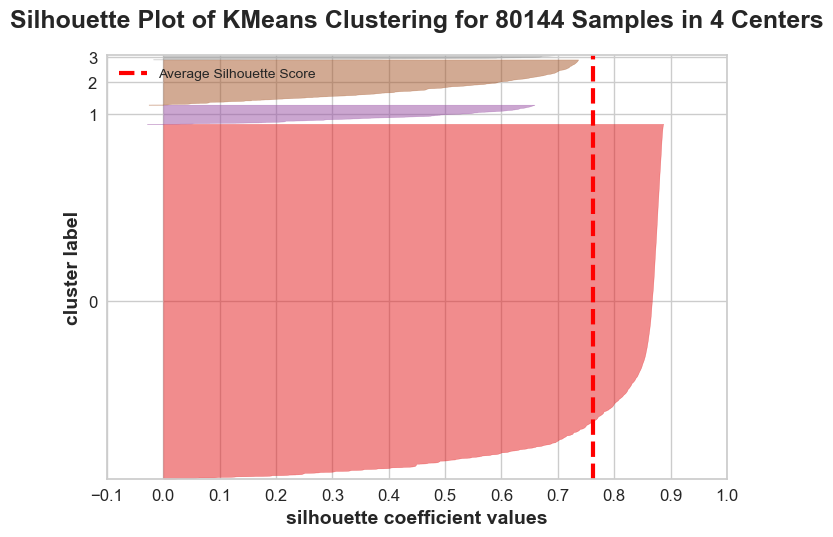

Calculating Silhouette scores for 5 clusters...


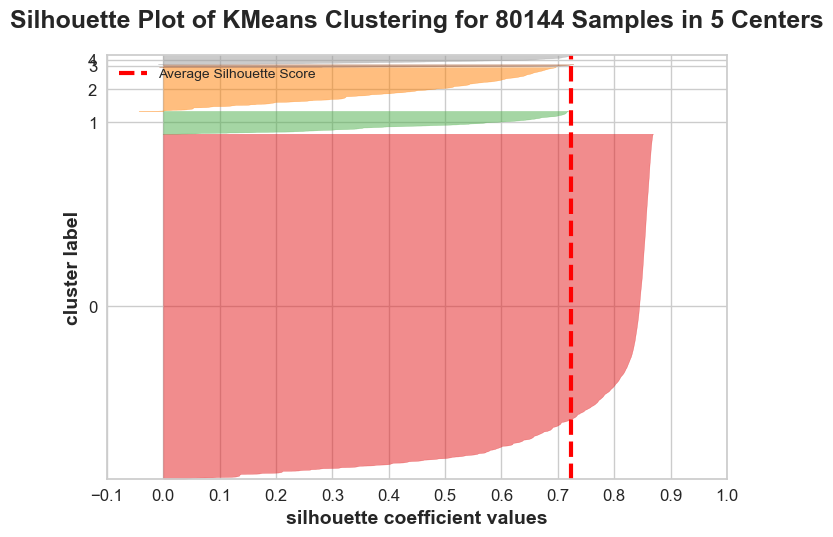

Calculating Silhouette scores for 6 clusters...


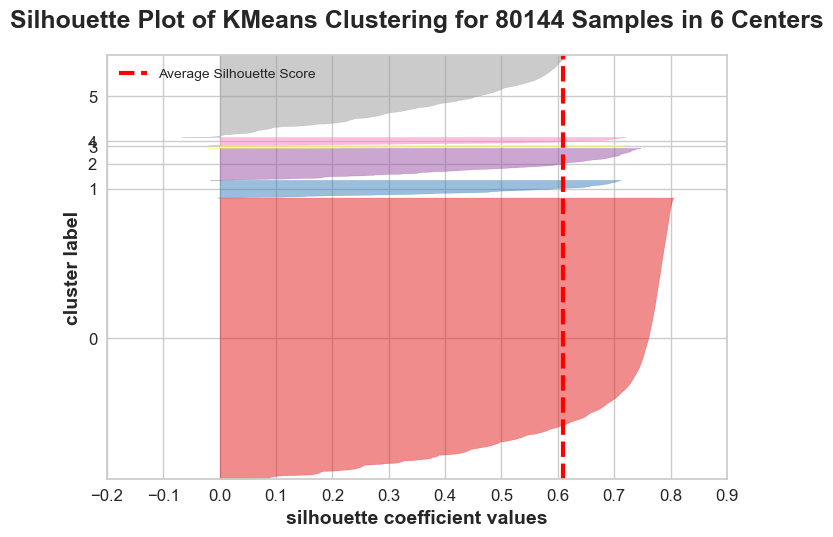

Calculating Silhouette scores for 7 clusters...


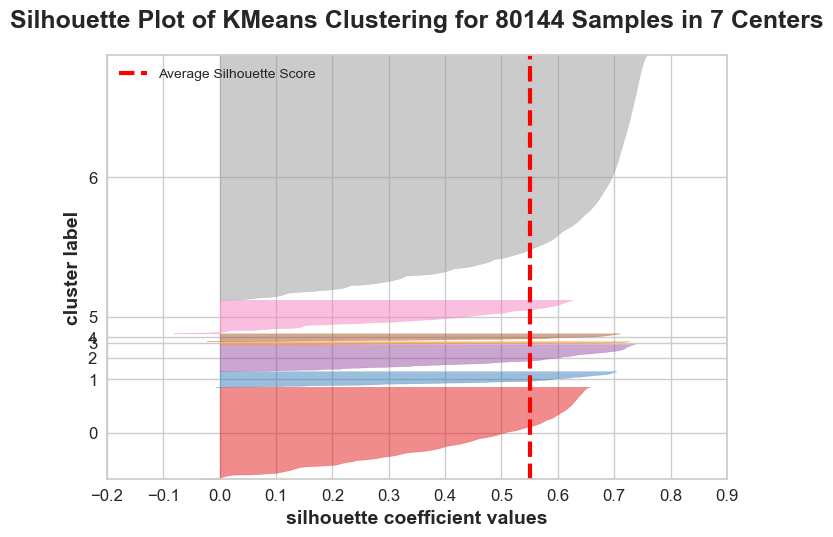

Calculating Silhouette scores for 8 clusters...


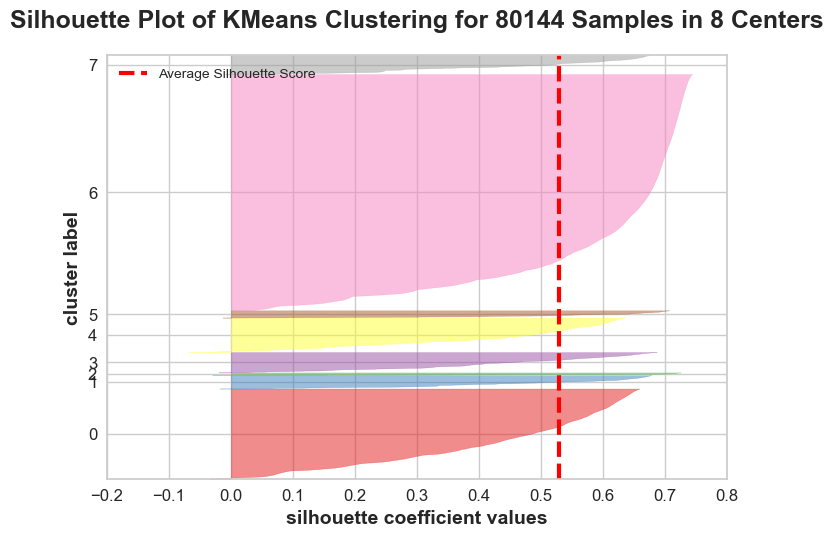

In [21]:
# # ==================================================================================================
# # SILHOUETTE VISUALIZER WITH YELLOWBRICK
# # ==================================================================================================
# Define the range of clusters to try
min_clusters = 4
max_clusters = 8

# Loop through each number of clusters and create Silhouette plots
for num_clusters in range(min_clusters, max_clusters + 1):
    print(f"Calculating Silhouette scores for {num_clusters} clusters...")

    # Instantiate the pipeline with KMeans and SilhouetteVisualizer
    silhouette_visualizer = Pipeline([
        ("preprocessor", preprocessor),
        ("silhouettevisualizer", SilhouetteVisualizer(KMeans(n_clusters=num_clusters, random_state=42)))
    ])

    # Fit the pipeline to your data
    silhouette_visualizer.fit(df_data_kmeans_without_cf)

    # Show the silhouette visualizer for the current number of clusters
    silhouette_visualizer.named_steps['silhouettevisualizer'].poof()



## II.3. Choice of the number of cluster - Data-Driven Technique 3 -  Intercluster Distance Maps using MDS

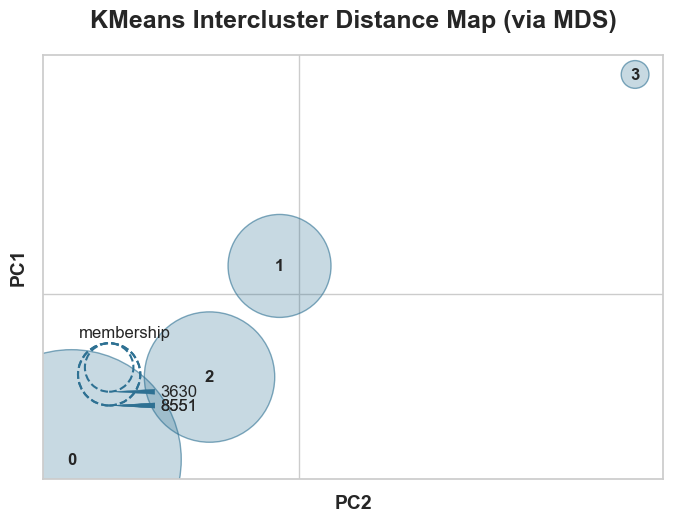

Number of customers in each cluster:
0    67183
2     8551
1     3630
3      780
Name: count, dtype: int64


In [22]:
# ==================================================================================================
# Intercluster Distance Maps WITH YELLOWBRICK
# ==================================================================================================
nb_cluster = 4
distance_intercluster_visualizer = Pipeline([
    ("preprocessor", preprocessor),
    ("distancevisualizer", InterclusterDistance(KMeans(nb_cluster)))])
distance_intercluster_visualizer.fit(df_data_kmeans_without_cf)
distance_intercluster_visualizer.named_steps['distancevisualizer'].show()

# ==================================================================================================
# NB of CUSTOMERS by CLUSTER
# ==================================================================================================
# Get the labels assigned to each data point
cluster_labels = distance_intercluster_visualizer.named_steps['distancevisualizer'].labels_

# Count the number of customers in each cluster
cluster_counts = pd.Series(cluster_labels).value_counts()

# Print the number of customers in each cluster
print("Number of customers in each cluster:")
print(cluster_counts)

## II.4. Empirical evaluation of the impact of k-means initialization

Evaluation of KMeans with random init
Evaluation of MiniBatchKMeans with k-means++ init


D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\sklearn\cluster\_kmeans.py:1972: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 2048 or by setting the environment variable OMP_NUM_THREADS=4

D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\sklearn\cluster\_kmeans.py:1972: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 2048 or by setting the environment variable OMP_NUM_THREADS=4

D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\sklearn\cluster\_kmeans.py:1972: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 2048 or by setting the environment variable OMP_NUM_THREADS=4

D:\ANACONDA\envs\OC_PROJET2\Lib\site-packag

Evaluation of MiniBatchKMeans with random init


D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\sklearn\cluster\_kmeans.py:1972: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 2048 or by setting the environment variable OMP_NUM_THREADS=4

D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\sklearn\cluster\_kmeans.py:1972: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 2048 or by setting the environment variable OMP_NUM_THREADS=4

D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\sklearn\cluster\_kmeans.py:1972: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 2048 or by setting the environment variable OMP_NUM_THREADS=4

D:\ANACONDA\envs\OC_PROJET2\Lib\site-packag

Evaluation of KMeans with k-means++ init


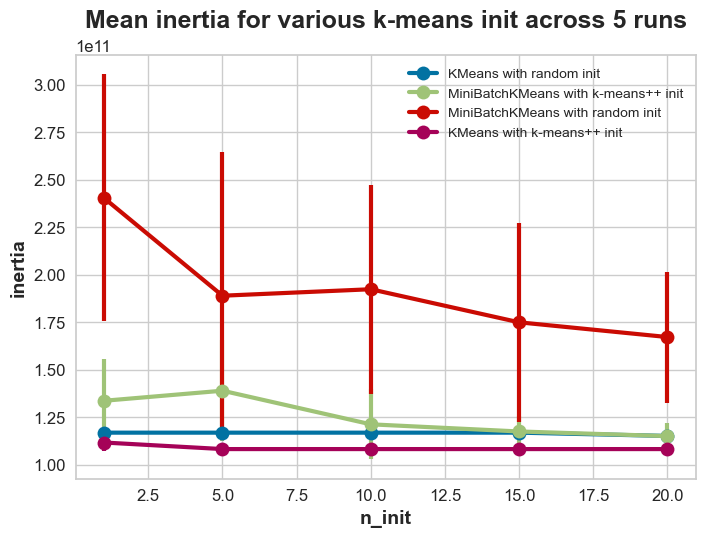

In [23]:
# ==================================================================================================
# STABILITY AT INITIALIZATION
# ==================================================================================================
# Set the random state
random_state = np.random.RandomState(42)

# Number of runs for each strategy
n_runs = 5

# Number of initializations
n_init_range = np.array([1, 5, 10, 15, 20])

# Assuming you have df_data_kmeans_with_cf DataFrame with features
# Let's assume X is your feature matrix from df_data_kmeans_with_cf
X = df_data_kmeans_without_cf.values

plt.figure()
plots = []
legends = []

cases = [
    (KMeans, "random", {}, "o-"),
    (MiniBatchKMeans, "k-means++", {"max_no_improvement": 3}, "x-"),
    (MiniBatchKMeans, "random", {"max_no_improvement": 3, "init_size": 500}, "d-"),
    (KMeans, "k-means++", {}, "^-"),
]

for factory, init, params, format in cases:
    print("Evaluation of %s with %s init" % (factory.__name__, init))
    inertia = np.empty((len(n_init_range), n_runs))

    for run_id in range(n_runs):
        for i, n_init in enumerate(n_init_range):
            km = factory(
                n_clusters=nb_cluster,
                init=init,
                random_state=check_random_state(random_state),
                n_init=n_init,
                **params,
            ).fit(X)
            inertia[i, run_id] = km.inertia_
    p = plt.errorbar(
        n_init_range, inertia.mean(axis=1), inertia.std(axis=1), fmt='-o'
    )
    plots.append(p[0])
    legends.append("%s with %s init" % (factory.__name__, init))

plt.xlabel("n_init")
plt.ylabel("inertia")
plt.legend(plots, legends)
plt.title("Mean inertia for various k-means init across %d runs" % n_runs)
plt.show()


## II.5. CLUSTERING - K MEANS

In [24]:
# ==================================================================================================
# APPLY THE K-MEANS NOW FOR VARIOUS K and VARIOUS PREPROCESSOR
# GET results_df_sorted
# ==================================================================================================

# Define the range of cluster numbers
cluster_range = range(2, 9)  # From 2 to 8 clusters

# Define preprocessors
preprocessors = [
    (None, None),
    ("MinMaxScaler", MinMaxScaler()),
    ("StandardScaler", StandardScaler()),
    ("PowerTransformer", PowerTransformer()),
    ("RobustScaler", RobustScaler())
]

# Create an empty DataFrame to store the results
results_data = []

# Loop over the range of cluster numbers
for num_clusters in cluster_range:
    # Loop over each preprocessor
    for preprocessor_name, preprocessor in preprocessors:
        # Define the pipeline including preprocessing and KMeans
        kmeans_pipeline = Pipeline([
            ("preprocessor", preprocessor if preprocessor is not None else 'passthrough'),
            ("kmeans", KMeans(n_clusters=num_clusters, random_state=42, n_init='auto'))
        ])

        # Fit the pipeline to the data
        kmeans_pipeline.fit(df_data_kmeans_without_cf)

        # Get the cluster labels for each data point
        cluster_labels = kmeans_pipeline.named_steps['kmeans'].labels_

        # Add the cluster labels to the DataFrame
        df_data_kmeans_without_cf['cluster'] = cluster_labels

        # Compute the silhouette score
        silhouette_avg = silhouette_score(df_data_kmeans_without_cf.drop(columns=['cluster']), cluster_labels)

        # Compute the Davies-Bouldin index
        davies_bouldin_idx = davies_bouldin_score(df_data_kmeans_without_cf.drop(columns=['cluster']), cluster_labels)

        # Append the results to the list
        results_data.append({
            "num_clusters": num_clusters,
            "preprocessor": preprocessor_name if preprocessor_name is not None else 'None',
            "silhouette_score": silhouette_avg,
            "davies_bouldin": davies_bouldin_idx
        })

        print(f"Processed: {num_clusters} clusters, Preprocessor: {preprocessor_name}")

# Create a DataFrame from the results
results_df = pd.DataFrame(results_data)

# Sort the DataFrame by silhouette score in descending order and by Davies-Bouldin index in ascending order
results_df_sorted = results_df.sort_values(by=["silhouette_score", "davies_bouldin"], ascending=[False, True])

# Assign a rank to each feature combination
results_df_sorted["silhouette_rank"] = range(1, len(results_df_sorted) + 1)
results_df_sorted["davies_bouldin_rank"] = range(1, len(results_df_sorted) + 1)

# Calculate the mean rank for each feature combination
results_df_sorted["mean_rank"] = (results_df_sorted["silhouette_rank"] + results_df_sorted["davies_bouldin_rank"]) / 2

# Set display options to show values in non-scientific notation
pd.set_option('display.float_format', lambda x: '%.2f' % x)

# Display the sorted DataFrame with ranks
display(results_df_sorted)

Processed: 2 clusters, Preprocessor: None
Processed: 2 clusters, Preprocessor: MinMaxScaler
Processed: 2 clusters, Preprocessor: StandardScaler
Processed: 2 clusters, Preprocessor: PowerTransformer
Processed: 2 clusters, Preprocessor: RobustScaler
Processed: 3 clusters, Preprocessor: None
Processed: 3 clusters, Preprocessor: MinMaxScaler
Processed: 3 clusters, Preprocessor: StandardScaler
Processed: 3 clusters, Preprocessor: PowerTransformer
Processed: 3 clusters, Preprocessor: RobustScaler
Processed: 4 clusters, Preprocessor: None
Processed: 4 clusters, Preprocessor: MinMaxScaler
Processed: 4 clusters, Preprocessor: StandardScaler
Processed: 4 clusters, Preprocessor: PowerTransformer
Processed: 4 clusters, Preprocessor: RobustScaler
Processed: 5 clusters, Preprocessor: None
Processed: 5 clusters, Preprocessor: MinMaxScaler
Processed: 5 clusters, Preprocessor: StandardScaler
Processed: 5 clusters, Preprocessor: PowerTransformer
Processed: 5 clusters, Preprocessor: RobustScaler
Processe

,num_clusters,preprocessor,silhouette_score,davies_bouldin,silhouette_rank,davies_bouldin_rank,mean_rank
0,2,None,0.82,0.49,1,1,1.00
5,3,None,0.79,0.50,2,2,2.00
10,4,None,0.76,0.52,3,3,3.00
9,3,RobustScaler,0.75,3.76,4,4,4.00
4,2,RobustScaler,0.74,0.81,5,5,5.00
15,5,None,0.72,0.52,6,6,6.00
2,2,StandardScaler,0.70,0.86,7,7,7.00
20,6,None,0.61,0.55,8,8,8.00
25,7,None,0.55,0.57,9,9,9.00
14,4,RobustScaler,0.54,1.71,10,10,10.00


In [38]:
from sklearn.preprocessing import PowerTransformer

numerical_features = list(df_data_kmeans_without_cf.select_dtypes(include=['int64','float64', 'uint8']).columns) # without the encodec categorical features
display('There are :  numerical features',len(numerical_features))

# ==================================================================================================
# Choice of the Preprocessor
# ==================================================================================================
# Preprocessor - TEST 0 
preprocessor = None


# Preprocessor - TEST 1 
# scaler = MinMaxScaler()

# preprocessor = ColumnTransformer([
#     ('scaler', scaler, numerical_features)])


# Preprocessor - TEST 2
# scaler = StandardScaler()

# preprocessor = ColumnTransformer([
#     ('scaler', scaler, numerical_features)])


# Preprocessor - TEST 3
# scaler = PowerTransformer()  # Use PowerTransformer

# preprocessor = ColumnTransformer([
#     ('scaler', scaler, numerical_features)])

'There are :  numerical features'

14

In [39]:
# ==================================================================================================
# APPLY THE K-MEANS NOW. 
# ==================================================================================================
from sklearn.cluster import KMeans

# Set the number of clusters based on the elbow method or any other criterion
num_clusters = nb_cluster

# Define the pipeline including preprocessing and KMeans
kmeans_pipeline = Pipeline([
    ("preprocessor", preprocessor),  # Assuming you have defined preprocessor earlier
    ("kmeans", KMeans(n_clusters=num_clusters, random_state=42, n_init='auto'))
])

# Fit the pipeline to the RFM dataset
kmeans_pipeline.fit(df_data_kmeans_without_cf)

# Get the cluster labels for each data point
cluster_labels = kmeans_pipeline.named_steps['kmeans'].labels_

# Add the cluster labels to the DataFrame
df_data_kmeans_without_cf['cluster'] = cluster_labels



# ==================================================================================================
# GET SOME STATS ON THE CLUSTERS
# ==================================================================================================
# Iterate over each cluster label
for cluster_label in range(num_clusters):
    # Count the number of customers in the current cluster
    cluster_count = len(df_data_kmeans_without_cf[df_data_kmeans_without_cf['cluster'] == cluster_label])
    # Print the count for the current cluster
    print(f'CLUSTER {cluster_label} contains {cluster_count} customers')

from sklearn.metrics import silhouette_score, davies_bouldin_score

# ==================================================================================================
# SILHOUETTE SCORE
# ==================================================================================================
# Compute the silhouette score
silhouette_avg = silhouette_score(df_data_kmeans_without_cf.drop(columns=['cluster']), cluster_labels)
print(f"Silhouette Score: {silhouette_avg}")

# ==================================================================================================
# DAVIES-BOULDIN
# ==================================================================================================
# Compute the Davies-Bouldin index
davies_bouldin_idx = davies_bouldin_score(df_data_kmeans_without_cf.drop(columns=['cluster']), cluster_labels)
print(f"Davies-Bouldin Index: {davies_bouldin_idx}")

CLUSTER 0 contains 67183 customers
CLUSTER 1 contains 3630 customers
CLUSTER 2 contains 8551 customers
CLUSTER 3 contains 780 customers
Silhouette Score: 0.7625723894979084
Davies-Bouldin Index: 0.5181361469096848


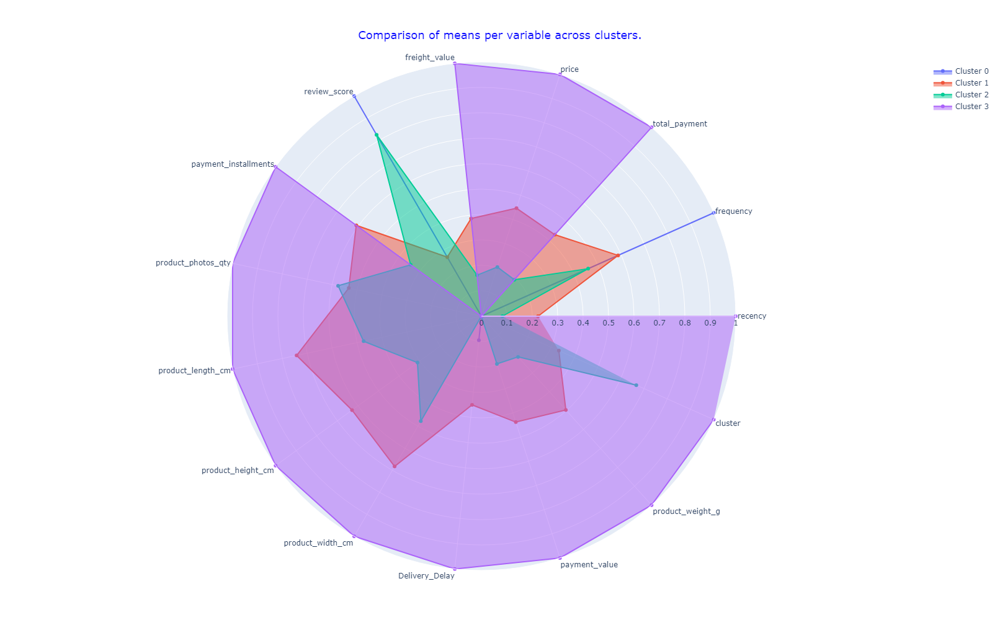

In [40]:
# ==================================================================================================
# DIFFERENCES BETWEEN CLUSTERS - Radar Plot using Plotly
# ==================================================================================================
def plot_radars(data, group, width=800, height=600):
    """
    Plot a radar plot (spider plot) to compare means per variable across clusters.

    Args:
    - data (DataFrame): The input data containing cluster labels and numerical features.
    - group (str): The column name indicating the cluster labels.
    - width (int, optional): Width of the plot in pixels. Default is 800.
    - height (int, optional): Height of the plot in pixels. Default is 600.

    Returns:
    - None: Displays the radar plot using Plotly.

    """
    scaler = MinMaxScaler()
    data = pd.DataFrame(scaler.fit_transform(data), 
                        index=data.index,
                        columns=data.columns).reset_index()
    
    fig = go.Figure()

    # Sort the data by the cluster labels
    data_sorted = data.sort_values(by=[group])

    for k in data_sorted[group].unique():
        cluster_data = data_sorted[data_sorted[group] == k]
        fig.add_trace(go.Scatterpolar(
            r=cluster_data.iloc[:, 1:].values.reshape(-1),
            theta=data.columns[1:],
            fill='toself',
            name='Cluster ' + str(k)
        ))

    fig.update_layout(
        polar=dict(
            radialaxis=dict(
                visible=True,
                range=[0, 1]
            )),
        showlegend=True,
        title={
            'text': "Comparison of means per variable across clusters.",
            'y': 0.95,
            'x': 0.5,
            'xanchor': 'center',
            'yanchor': 'top'},
        title_font_color="blue",
        title_font_size=18,
        width=width,
        height=height)

    fig.show()


numerical_features = list(df_data_kmeans_without_cf.select_dtypes(include=['int32', 'int64','float64', 'uint8']).columns)
# Preprocessor
scaler = MinMaxScaler()

preprocessor = ColumnTransformer([
    ('scaler', scaler, numerical_features)])
X_scaled = preprocessor.fit_transform(df_data_kmeans_without_cf)
X_scaled = pd.DataFrame(X_scaled, index=df_data_kmeans_without_cf.index, columns=df_data_kmeans_without_cf.columns)
X_scaled["kmeans_label"] = cluster_labels
X_scaled_clusters = X_scaled.groupby("kmeans_label").mean()
X_scaled_clusters


plot_radars(data=X_scaled_clusters, group="kmeans_label", width=1200, height=1000)

D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\seaborn\_oldcore.py:1057: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



Cluster 0, Mean of recency: 234.33
Cluster 0, Mode of recency: 277

Cluster 2, Mean of recency: 237.47
Cluster 2, Mode of recency: 277

Cluster 3, Mean of recency: 272.32
Cluster 3, Mode of recency: 278

Cluster 1, Mean of recency: 242.79
Cluster 1, Mode of recency: 278



D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\seaborn\_oldcore.py:1057: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



Cluster 0, Mean of frequency: 1.03
Cluster 0, Mode of frequency: 1

Cluster 2, Mean of frequency: 1.02
Cluster 2, Mode of frequency: 1

Cluster 3, Mean of frequency: 1.02
Cluster 3, Mode of frequency: 1

Cluster 1, Mean of frequency: 1.02
Cluster 1, Mode of frequency: 1



D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\seaborn\_oldcore.py:1057: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



Cluster 0, Mean of total_payment: 146.30
Cluster 0, Mode of total_payment: 95.24

Cluster 2, Mean of total_payment: 257.91
Cluster 2, Mode of total_payment: 114.6

Cluster 3, Mean of total_payment: 724.17
Cluster 3, Mode of total_payment: 433.86

Cluster 1, Mean of total_payment: 395.73
Cluster 1, Mode of total_payment: 257.54



D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\seaborn\_oldcore.py:1057: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



Cluster 0, Mean of review_score: 4.23
Cluster 0, Mode of review_score: 5.0

Cluster 2, Mean of review_score: 4.19
Cluster 2, Mode of review_score: 5.0

Cluster 3, Mean of review_score: 4.00
Cluster 3, Mode of review_score: 5.0

Cluster 1, Mean of review_score: 4.06
Cluster 1, Mode of review_score: 5.0



D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\seaborn\_oldcore.py:1057: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



Cluster 0, Mean of Delivery_Delay: -11.77
Cluster 0, Mode of Delivery_Delay: -14.0

Cluster 2, Mean of Delivery_Delay: -11.89
Cluster 2, Mode of Delivery_Delay: -14.0

Cluster 3, Mean of Delivery_Delay: -10.56
Cluster 3, Mode of Delivery_Delay: -14.0

Cluster 1, Mean of Delivery_Delay: -11.43
Cluster 1, Mode of Delivery_Delay: -14.0



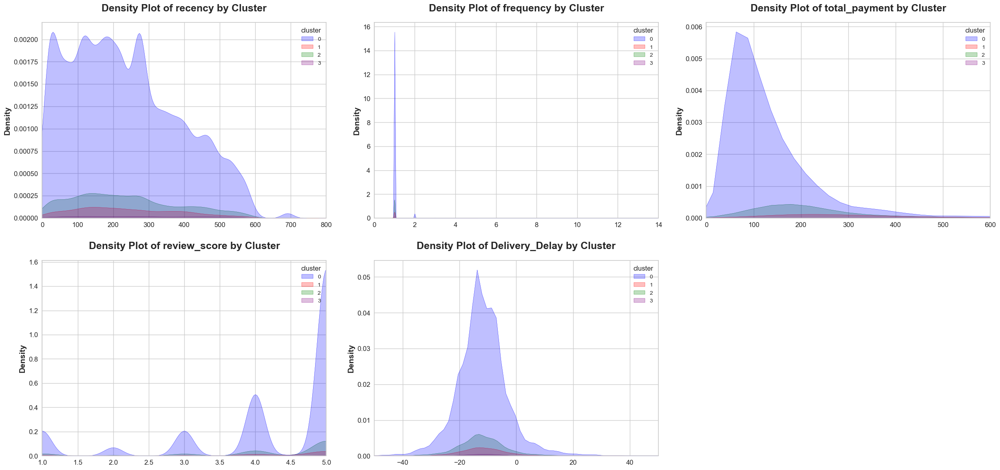

In [41]:
# ==================================================================================================
# DENSITY PLOTS BY CLUSTER
# 'recency', 'frequency', 'total_payment', 'review_score', 'Delivery_Delay'
# ==================================================================================================

import matplotlib.pyplot as plt
import seaborn as sns

# Check if 'cluster' column exists and is categorical
if 'cluster' not in df_data_kmeans_without_cf.columns:
    df_data_kmeans_without_cf['cluster'] = cluster_labels  # Assuming 'cluster_labels' contains cluster assignments
else:
    df_data_kmeans_without_cf['cluster'] = df_data_kmeans_without_cf['cluster'].astype('category')

# Define the features for plotting
features_to_plot = ['recency', 'frequency', 'total_payment', 'review_score', 'Delivery_Delay']
x_limits = {'recency': (0, 800),
            'frequency': (0, 14),
            'total_payment': (0, 600),
            'review_score': (1, 5),
            'Delivery_Delay': (-50, 50)}

# Calculate the number of rows for subplots
num_features = len(features_to_plot)
num_rows = (num_features + 2) // 3  # Adjusted for three subplots per row

# Define the size of the figure
fig_width = 25  # Adjust as needed
fig_height = num_rows * 6  # Adjust as needed

# Create subplots with a larger figure size
fig, axes = plt.subplots(num_rows, 3, figsize=(fig_width, fig_height))  # Changed to 3 columns

# Flatten axes if only one row
if num_rows == 1:
    axes = [axes]

# Define custom colors for each cluster
colors = ['blue', 'red', 'green', 'purple']

# Plot density plots for each numerical feature
for i, feature in enumerate(features_to_plot):
    row_index = i // 3  # Adjusted for three subplots per row
    col_index = i % 3  # Adjusted for three subplots per row
    ax = axes[row_index][col_index]
    
    sns.kdeplot(data=df_data_kmeans_without_cf, x=feature, hue='cluster', palette=colors, fill=True, ax=ax)
    ax.set_title(f'Density Plot of {feature} by Cluster')
    ax.set_xlabel('')
    ax.set_ylabel('Density')
    
    # Set x-axis limits
    if feature in x_limits:
        ax.set_xlim(x_limits[feature])
    
    # Iterate over clusters
    for cluster, color in zip(df_data_kmeans_without_cf['cluster'].unique(), colors):
        cluster_data = df_data_kmeans_without_cf[df_data_kmeans_without_cf['cluster'] == cluster][feature]
        
        # Calculate and print mean
        mean_value = cluster_data.mean()
        print(f"Cluster {cluster}, Mean of {feature}: {mean_value:.2f}")
        
        # Calculate and print mode
        mode_value = cluster_data.mode().values[0]
        print(f"Cluster {cluster}, Mode of {feature}: {mode_value}\n")
    
# Remove empty subplots
if num_features % 3 != 0:  # Adjusted for three subplots per row
    for i in range(num_features % 3, 3):  # Adjusted for three subplots per row
        axes[-1][i].remove()

# Adjust layout
plt.tight_layout(pad=2)  # Adjust spacing between subplots
plt.show()


D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\seaborn\_oldcore.py:1057: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



Cluster 0, Mean of payment_installments: 2.67
Cluster 0, Mode of payment_installments: 1.0

Cluster 2, Mean of payment_installments: 3.59
Cluster 2, Mode of payment_installments: 1.0

Cluster 3, Mean of payment_installments: 5.35
Cluster 3, Mode of payment_installments: 1.0

Cluster 1, Mean of payment_installments: 4.30
Cluster 1, Mode of payment_installments: 1.0



D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\seaborn\_oldcore.py:1057: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



Cluster 0, Mean of product_photos_qty: 2.26
Cluster 0, Mode of product_photos_qty: 1.0

Cluster 2, Mean of product_photos_qty: 2.44
Cluster 2, Mode of product_photos_qty: 1.0

Cluster 3, Mean of product_photos_qty: 2.57
Cluster 3, Mode of product_photos_qty: 1.0

Cluster 1, Mean of product_photos_qty: 2.43
Cluster 1, Mode of product_photos_qty: 1.0



D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\seaborn\_oldcore.py:1057: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



Cluster 0, Mean of product_length_cm: 27.14
Cluster 0, Mode of product_length_cm: 16.0

Cluster 2, Mean of product_length_cm: 41.80
Cluster 2, Mode of product_length_cm: 20.0

Cluster 3, Mean of product_length_cm: 58.11
Cluster 3, Mode of product_length_cm: 60.0

Cluster 1, Mean of product_length_cm: 50.14
Cluster 1, Mode of product_length_cm: 35.0



D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\seaborn\_oldcore.py:1057: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



Cluster 0, Mean of product_height_cm: 13.65
Cluster 0, Mode of product_height_cm: 10.0

Cluster 2, Mean of product_height_cm: 25.84
Cluster 2, Mode of product_height_cm: 20.0

Cluster 3, Mean of product_height_cm: 52.88
Cluster 3, Mode of product_height_cm: 50.0

Cluster 1, Mean of product_height_cm: 38.31
Cluster 1, Mode of product_height_cm: 15.0



D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\seaborn\_oldcore.py:1057: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



Cluster 0, Mean of product_width_cm: 20.61
Cluster 0, Mode of product_width_cm: 20.0

Cluster 2, Mean of product_width_cm: 33.13
Cluster 2, Mode of product_width_cm: 20.0

Cluster 3, Mean of product_width_cm: 46.89
Cluster 3, Mode of product_width_cm: 50.0

Cluster 1, Mean of product_width_cm: 38.54
Cluster 1, Mode of product_width_cm: 40.0



D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\seaborn\_oldcore.py:1057: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



Cluster 0, Mean of product_weight_g: 794.34
Cluster 0, Mode of product_weight_g: 200.0

Cluster 2, Mean of product_weight_g: 5934.73
Cluster 2, Mode of product_weight_g: 6550.0

Cluster 3, Mean of product_weight_g: 24653.08
Cluster 3, Mode of product_weight_g: 30000.0

Cluster 1, Mean of product_weight_g: 12632.00
Cluster 1, Mode of product_weight_g: 9750.0



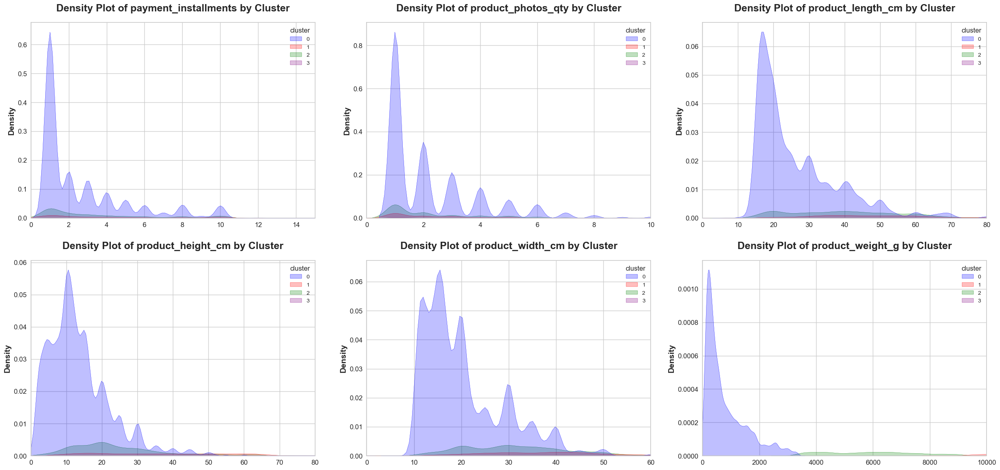

In [42]:
# ==================================================================================================
# DENSITY PLOTS BY CLUSTER
# 'payment_installments', 'product_photos_qty', 'product_length_cm', 'product_height_cm', 'product_width_cm', 'product_weight_g'
# ==================================================================================================

# Check if 'cluster' column exists and is categorical
if 'cluster' not in df_data_kmeans_without_cf.columns:
    df_data_kmeans_without_cf['cluster'] = cluster_labels  # Assuming 'cluster_labels' contains cluster assignments
else:
    df_data_kmeans_without_cf['cluster'] = df_data_kmeans_without_cf['cluster'].astype('category')

# Define the features for plotting
features_to_plot = ['payment_installments', 'product_photos_qty', 'product_length_cm', 'product_height_cm', 'product_width_cm', 'product_weight_g']
x_limits = {'payment_installments': (0, 15),
            'product_photos_qty'  : (0, 10),
            'product_length_cm'   : (0, 80),
            'product_height_cm'   : (0, 80),
            'product_width_cm'    : (0, 60), 
            'product_weight_g'    : (0, 10000)}

# Calculate the number of rows for subplots
num_features = len(features_to_plot)
num_rows = (num_features + 2) // 3  # Adjusted for three subplots per row

# Define the size of the figure
fig_width = 25  # Adjust as needed
fig_height = num_rows * 6  # Adjust as needed

# Create subplots with a larger figure size
fig, axes = plt.subplots(num_rows, 3, figsize=(fig_width, fig_height))  # Changed to 3 columns

# Flatten axes if only one row
if num_rows == 1:
    axes = [axes]

# Define custom colors for each cluster
colors = ['blue', 'red', 'green', 'purple']

# Plot density plots for each numerical feature
for i, feature in enumerate(features_to_plot):
    row_index = i // 3  # Adjusted for three subplots per row
    col_index = i % 3  # Adjusted for three subplots per row
    ax = axes[row_index][col_index]
    
    sns.kdeplot(data=df_data_kmeans_without_cf, x=feature, hue='cluster', palette=colors, fill=True, ax=ax)
    ax.set_title(f'Density Plot of {feature} by Cluster')
    ax.set_xlabel('')
    ax.set_ylabel('Density')
    
    # Set x-axis limits
    if feature in x_limits:
        ax.set_xlim(x_limits[feature])
    
    # Iterate over clusters
    for cluster, color in zip(df_data_kmeans_without_cf['cluster'].unique(), colors):
        cluster_data = df_data_kmeans_without_cf[df_data_kmeans_without_cf['cluster'] == cluster][feature]
        
        # Calculate and print mean
        mean_value = cluster_data.mean()
        print(f"Cluster {cluster}, Mean of {feature}: {mean_value:.2f}")
        
        # Calculate and print mode
        mode_value = cluster_data.mode().values[0]
        print(f"Cluster {cluster}, Mode of {feature}: {mode_value}\n")
    
# Remove empty subplots
if num_features % 3 != 0:  # Adjusted for three subplots per row
    for i in range(num_features % 3, 3):  # Adjusted for three subplots per row
        axes[-1][i].remove()

# Adjust layout
plt.tight_layout(pad=2)  # Adjust spacing between subplots
plt.show()


In [43]:
# # ==================================================================================================
# # PAIRWISE SCATTER PLOTS BY CLUSTER
# # ==================================================================================================

# # Define the numerical features for plotting
# # numerical_features = df_data_kmeans_without_cf.select_dtypes(include=np.number).columns.tolist()
# numerical_features = list(df_data_kmeans_without_cf.select_dtypes(include=['int64','float64', 'uint8']).columns)

# # Plot pairwise scatter plots colored by cluster
# g = sns.pairplot(data=df_data_kmeans_without_cf, vars=numerical_features, hue='cluster', palette='viridis')

# plt.suptitle('Pairwise Scatter Plots Colored by Cluster', fontsize=18, fontweight='bold')
# plt.show()

D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\seaborn\_oldcore.py:1057: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



Cluster 0, Mean of recency: 234.33
Cluster 2, Mean of recency: 237.47
Cluster 3, Mean of recency: 272.32
Cluster 1, Mean of recency: 242.79


D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\seaborn\_oldcore.py:1057: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



Cluster 0, Mean of frequency: 1.03
Cluster 2, Mean of frequency: 1.02
Cluster 3, Mean of frequency: 1.02
Cluster 1, Mean of frequency: 1.02


D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\seaborn\_oldcore.py:1057: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



Cluster 0, Mean of total_payment: 146.30
Cluster 2, Mean of total_payment: 257.91
Cluster 3, Mean of total_payment: 724.17
Cluster 1, Mean of total_payment: 395.73


D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\seaborn\_oldcore.py:1057: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



Cluster 0, Mean of price: 110.83
Cluster 2, Mean of price: 199.04
Cluster 3, Mean of price: 544.45
Cluster 1, Mean of price: 304.51


D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\seaborn\_oldcore.py:1057: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



Cluster 0, Mean of freight_value: 17.73
Cluster 2, Mean of freight_value: 29.43
Cluster 3, Mean of freight_value: 89.86
Cluster 1, Mean of freight_value: 45.61


D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\seaborn\_oldcore.py:1057: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



Cluster 0, Mean of review_score: 4.23
Cluster 2, Mean of review_score: 4.19
Cluster 3, Mean of review_score: 4.00
Cluster 1, Mean of review_score: 4.06


D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\seaborn\_oldcore.py:1057: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



Cluster 0, Mean of payment_installments: 2.67
Cluster 2, Mean of payment_installments: 3.59
Cluster 3, Mean of payment_installments: 5.35
Cluster 1, Mean of payment_installments: 4.30


D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\seaborn\_oldcore.py:1057: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



Cluster 0, Mean of product_photos_qty: 2.26
Cluster 2, Mean of product_photos_qty: 2.44
Cluster 3, Mean of product_photos_qty: 2.57
Cluster 1, Mean of product_photos_qty: 2.43


D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\seaborn\_oldcore.py:1057: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



Cluster 0, Mean of product_length_cm: 27.14
Cluster 2, Mean of product_length_cm: 41.80
Cluster 3, Mean of product_length_cm: 58.11
Cluster 1, Mean of product_length_cm: 50.14


D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\seaborn\_oldcore.py:1057: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



Cluster 0, Mean of product_height_cm: 13.65
Cluster 2, Mean of product_height_cm: 25.84
Cluster 3, Mean of product_height_cm: 52.88
Cluster 1, Mean of product_height_cm: 38.31


D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\seaborn\_oldcore.py:1057: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



Cluster 0, Mean of product_width_cm: 20.61
Cluster 2, Mean of product_width_cm: 33.13
Cluster 3, Mean of product_width_cm: 46.89
Cluster 1, Mean of product_width_cm: 38.54


D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\seaborn\_oldcore.py:1057: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



Cluster 0, Mean of Delivery_Delay: -11.77
Cluster 2, Mean of Delivery_Delay: -11.89
Cluster 3, Mean of Delivery_Delay: -10.56
Cluster 1, Mean of Delivery_Delay: -11.43


D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\seaborn\_oldcore.py:1057: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



Cluster 0, Mean of payment_value: 128.56
Cluster 2, Mean of payment_value: 228.47
Cluster 3, Mean of payment_value: 634.31
Cluster 1, Mean of payment_value: 350.12


D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\seaborn\_oldcore.py:1057: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



Cluster 0, Mean of product_weight_g: 794.34
Cluster 2, Mean of product_weight_g: 5934.73
Cluster 3, Mean of product_weight_g: 24653.08
Cluster 1, Mean of product_weight_g: 12632.00


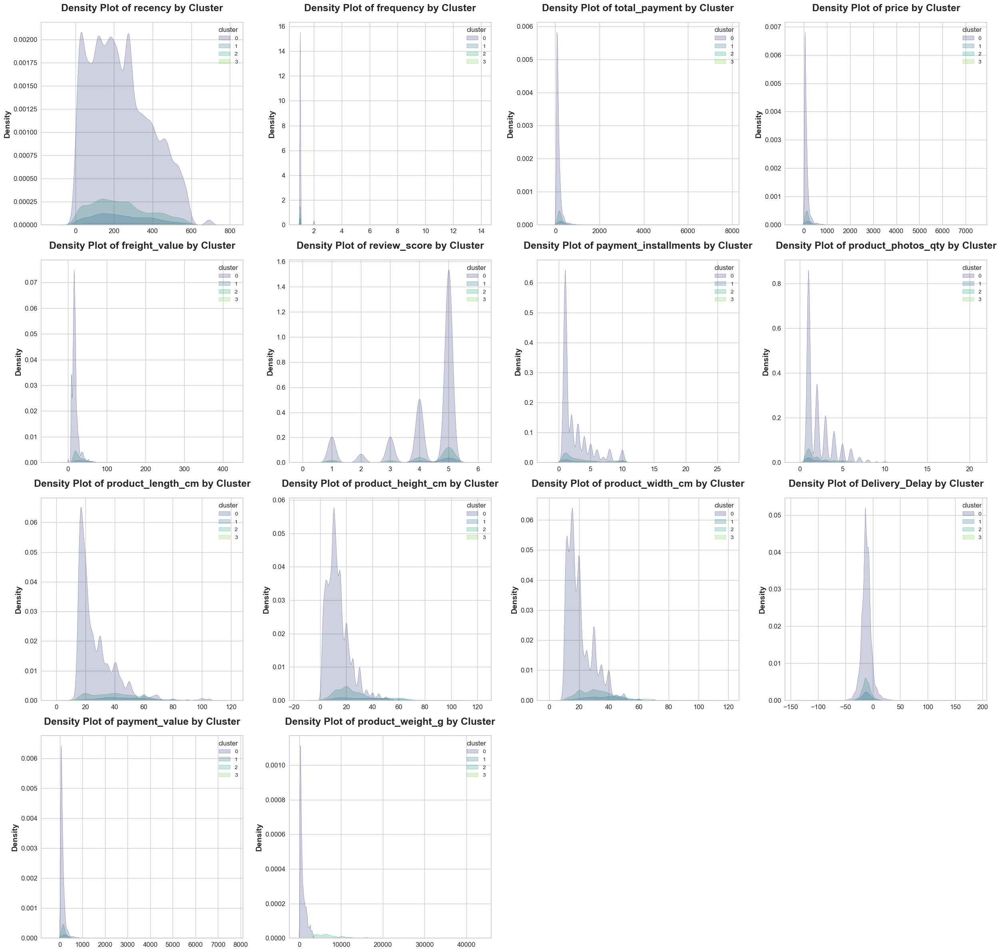

In [44]:
# ==================================================================================================
# DENSITY PLOTS BY CLUSTER
# ==================================================================================================
# Define the numerical features for plotting
# numerical_features = df_data.select_dtypes(include=np.number).columns.tolist()
numerical_features = list(df_data_kmeans_without_cf.select_dtypes(include=['int64','float64', 'uint8']).columns)

# Calculate the number of rows for subplots
num_features = len(numerical_features)
num_rows = (num_features + 3) // 4  # Round up to the nearest integer

# Define the size of the figure
fig_width = 25  # Adjust as needed
fig_height = num_rows * 6  # Adjust as needed

# Create subplots with a larger figure size
fig, axes = plt.subplots(num_rows, 4, figsize=(fig_width, fig_height))

# Flatten axes if only one row
if num_rows == 1:
    axes = [axes]

# Plot density plots for each numerical feature
for i, feature in enumerate(numerical_features):
    row_index = i // 4
    col_index = i % 4
    ax = axes[row_index][col_index]
    
    sns.kdeplot(data=df_data_kmeans_without_cf, x=feature, hue='cluster', palette='viridis', fill=True, ax=ax)
    ax.set_title(f'Density Plot of {feature} by Cluster')
    ax.set_xlabel('')
    ax.set_ylabel('Density')

    # Iterate over clusters
    for cluster, color in zip(df_data_kmeans_without_cf['cluster'].unique(), colors):
        cluster_data = df_data_kmeans_without_cf[df_data_kmeans_without_cf['cluster'] == cluster][feature]
        
        # Calculate and print mean
        mean_value = cluster_data.mean()
        print(f"Cluster {cluster}, Mean of {feature}: {mean_value:.2f}")
        


# Remove empty subplots
if num_features % 4 != 0:
    for i in range(num_features % 4, 4):
        axes[-1][i].remove()

# Adjust layout
plt.tight_layout()
plt.show()

D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\seaborn\categorical.py:641: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



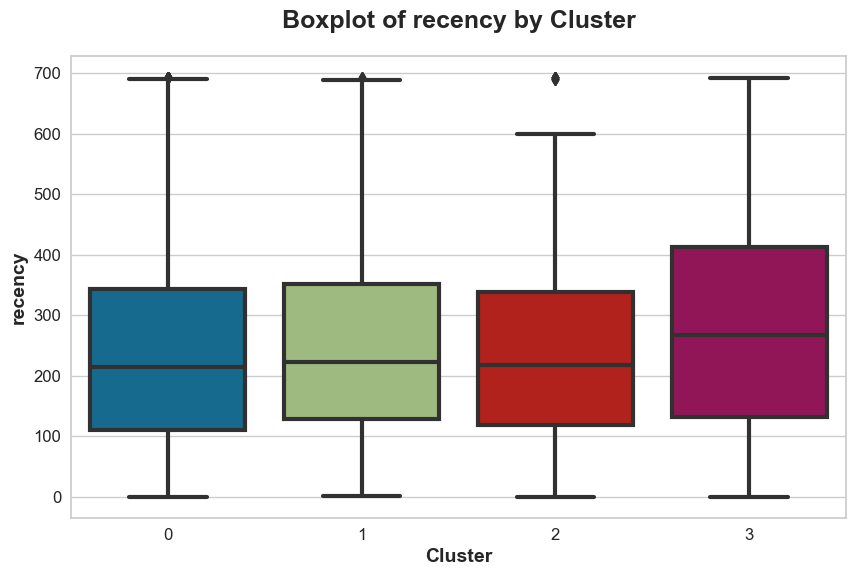

D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\seaborn\categorical.py:641: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



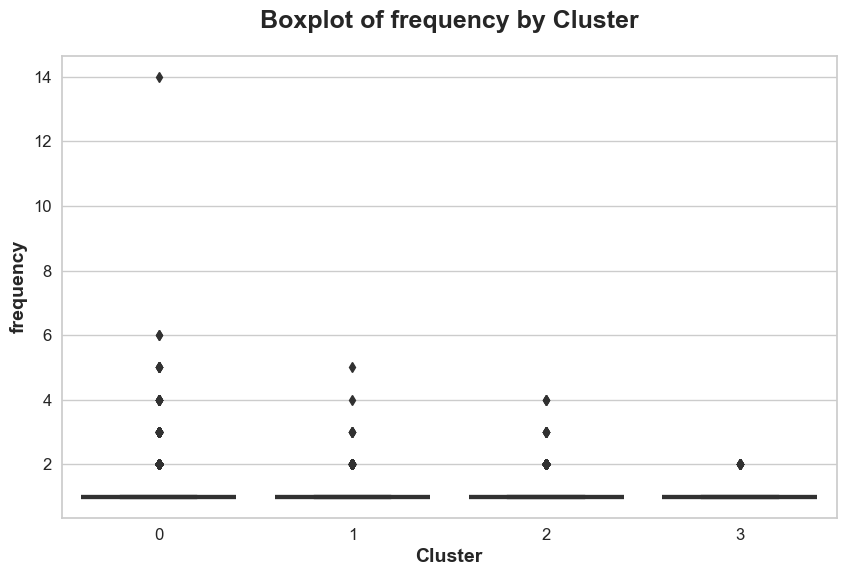

D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\seaborn\categorical.py:641: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



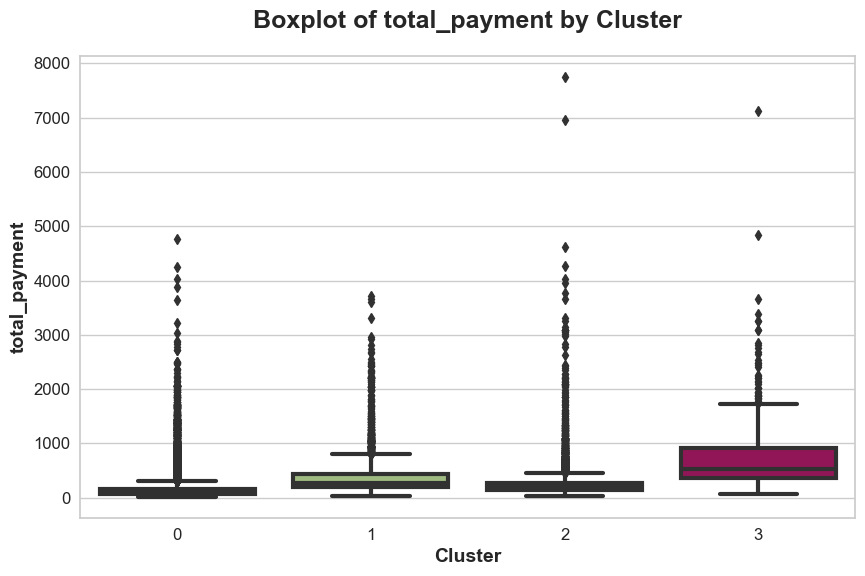

D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\seaborn\categorical.py:641: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



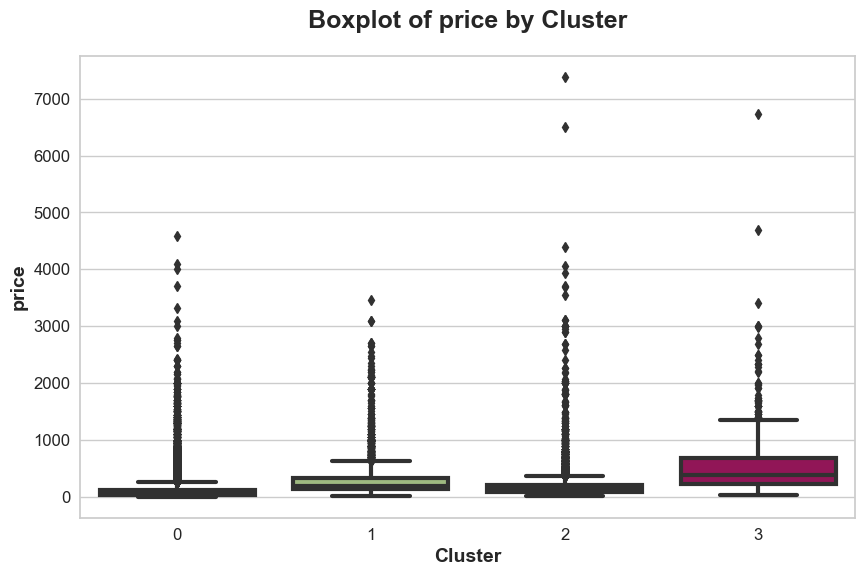

D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\seaborn\categorical.py:641: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



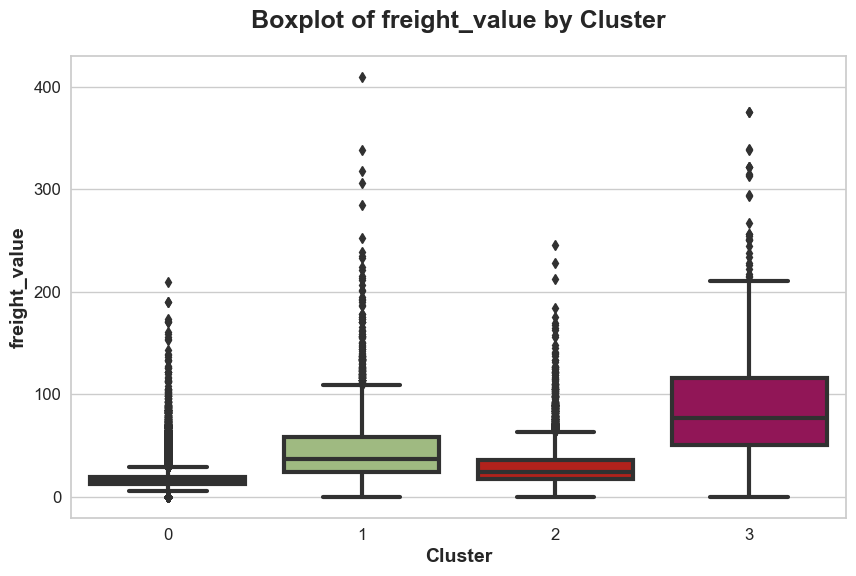

D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\seaborn\categorical.py:641: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



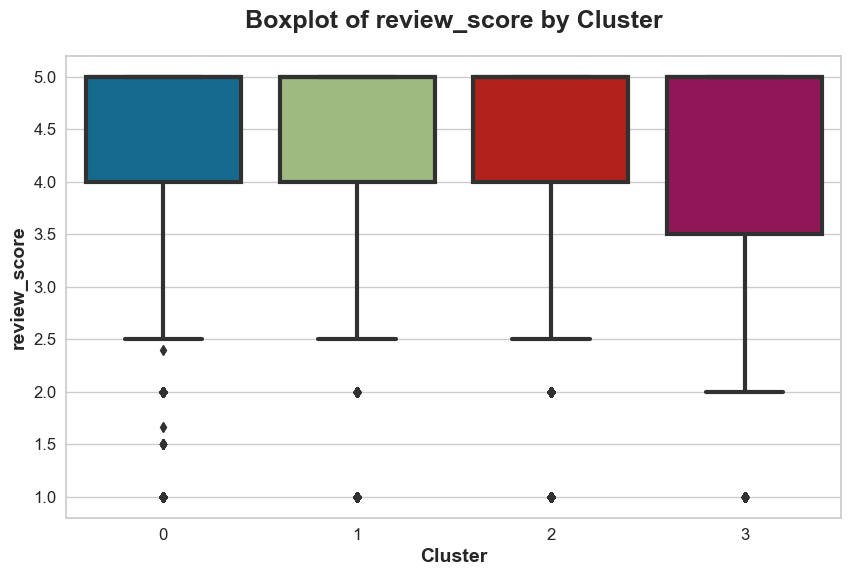

D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\seaborn\categorical.py:641: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



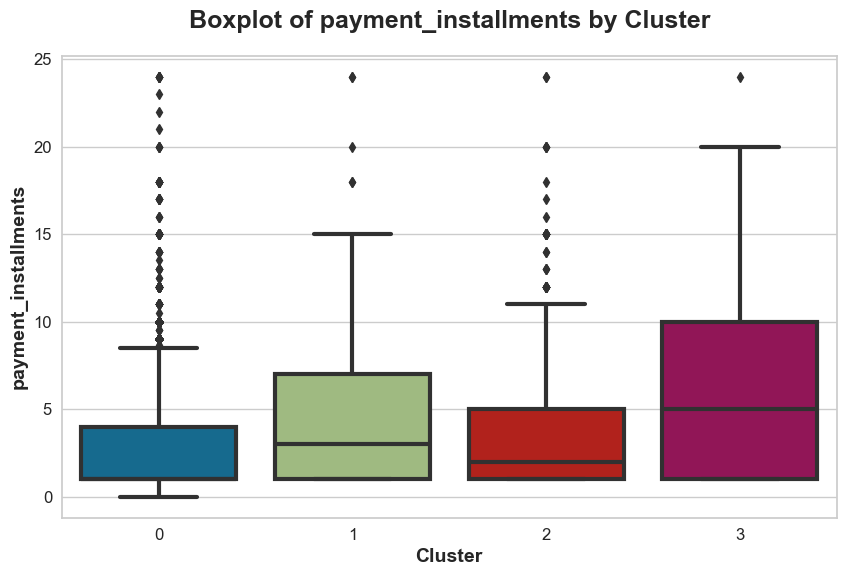

D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\seaborn\categorical.py:641: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



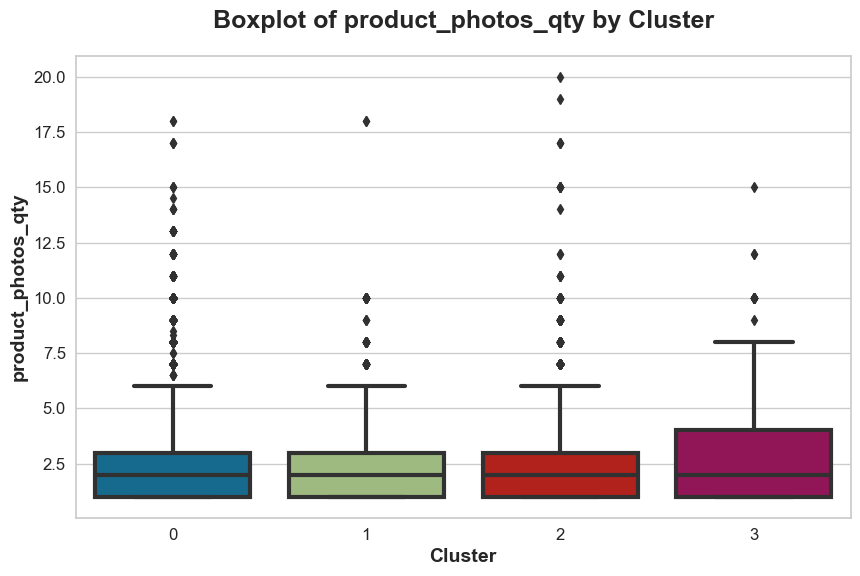

D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\seaborn\categorical.py:641: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



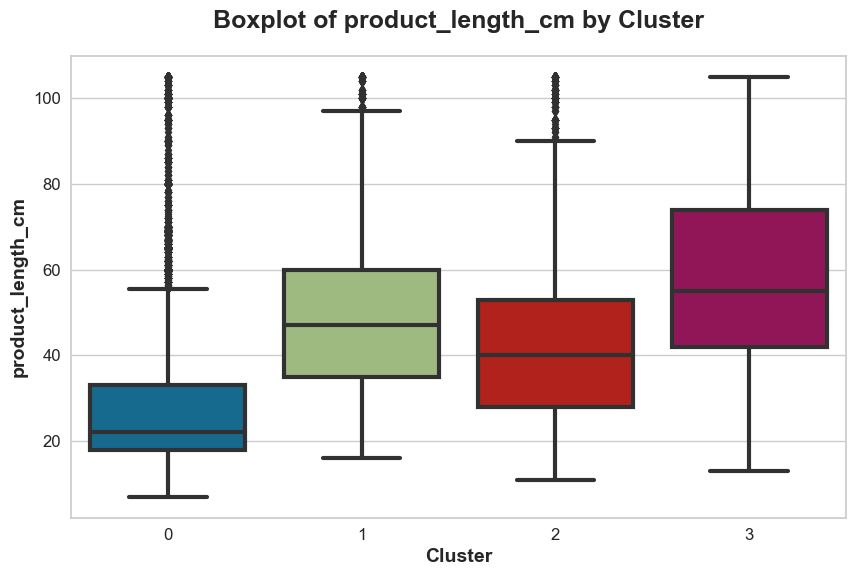

D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\seaborn\categorical.py:641: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



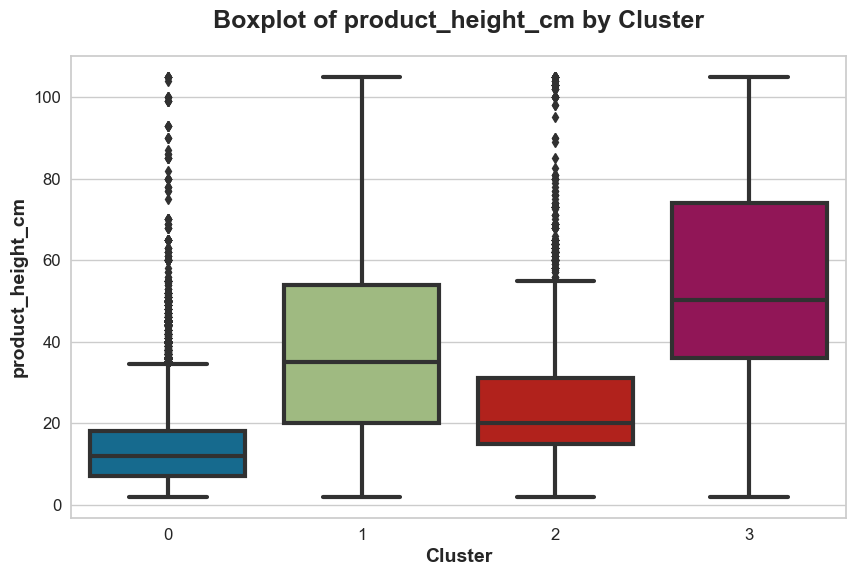

D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\seaborn\categorical.py:641: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



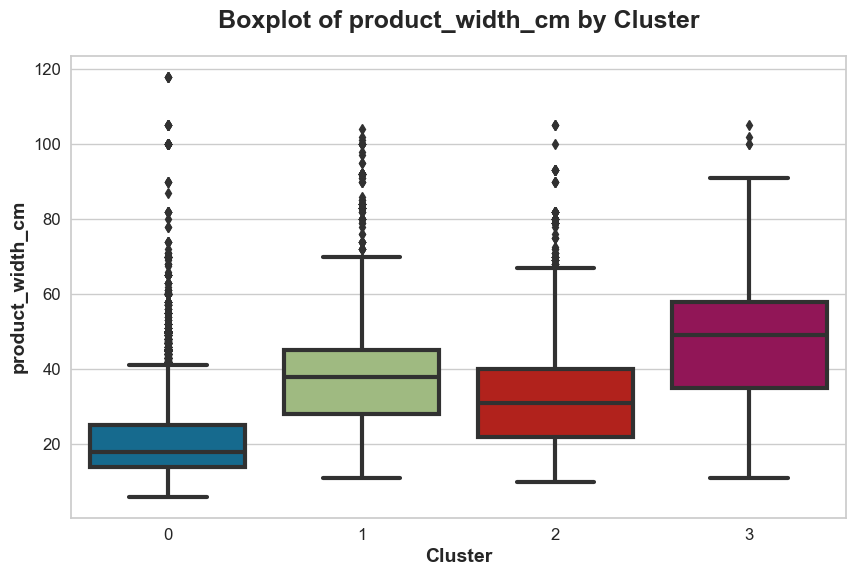

D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\seaborn\categorical.py:641: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



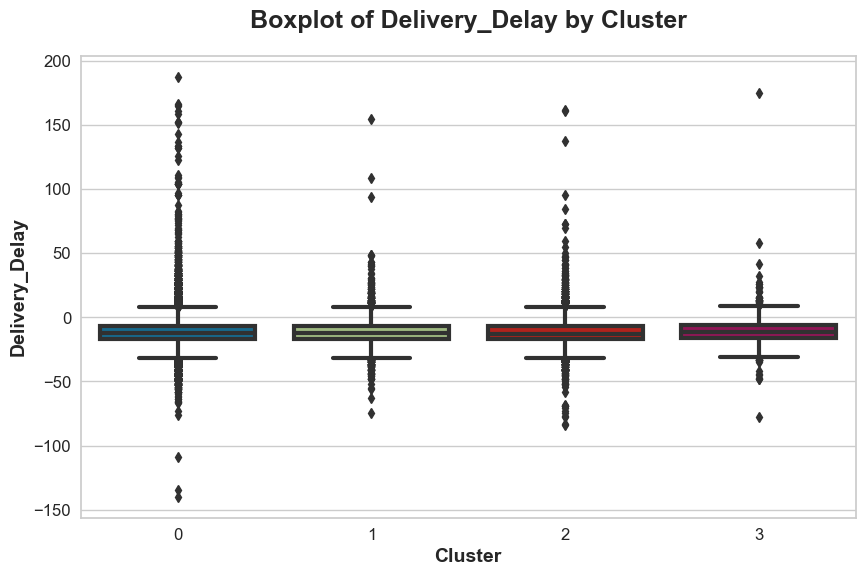

D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\seaborn\categorical.py:641: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



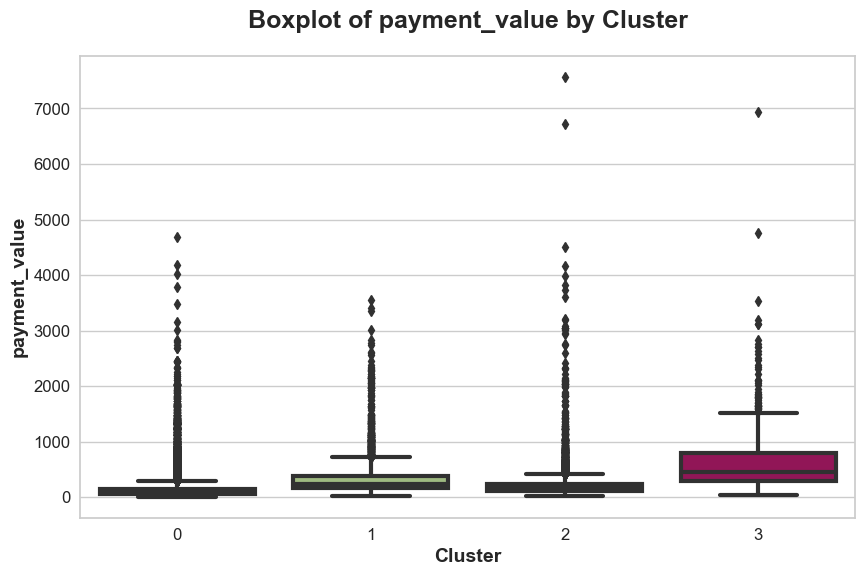

D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\seaborn\categorical.py:641: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



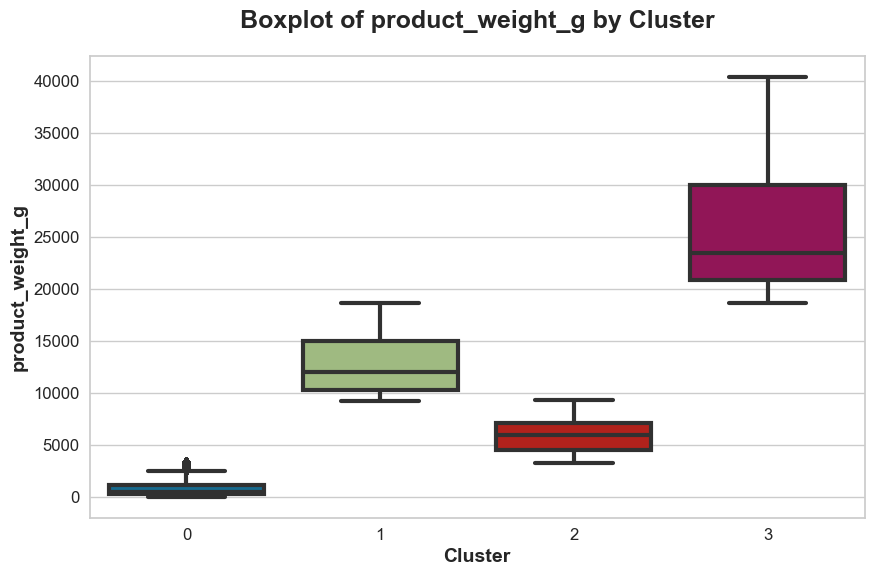

In [45]:
# Define the features used for clustering
# numerical_features = df_data.select_dtypes(include=np.number).columns.tolist()
numerical_features = list(df_data_kmeans_without_cf.select_dtypes(include=['int64','float64', 'uint8']).columns)

# Iterate over each feature and create a boxplot for each cluster
for feature in numerical_features:
    plt.figure(figsize=(10, 6))
    sns.boxplot(x='cluster', y=feature, data=df_data_kmeans_without_cf)
    plt.title(f'Boxplot of {feature} by Cluster')
    plt.xlabel('Cluster')
    plt.ylabel(feature)
    plt.show()

# III. Data-driven - K-MEANS AVEC PCA (Réduction dimensionnel)

## III.1. PCA - Dimensional Reduction

10


,Components,Information Retained
0,1,0.30
1,2,0.44
2,3,0.53
3,4,0.60
4,5,0.67
5,6,0.73
6,7,0.79
7,8,0.85
8,9,0.89
9,10,0.93


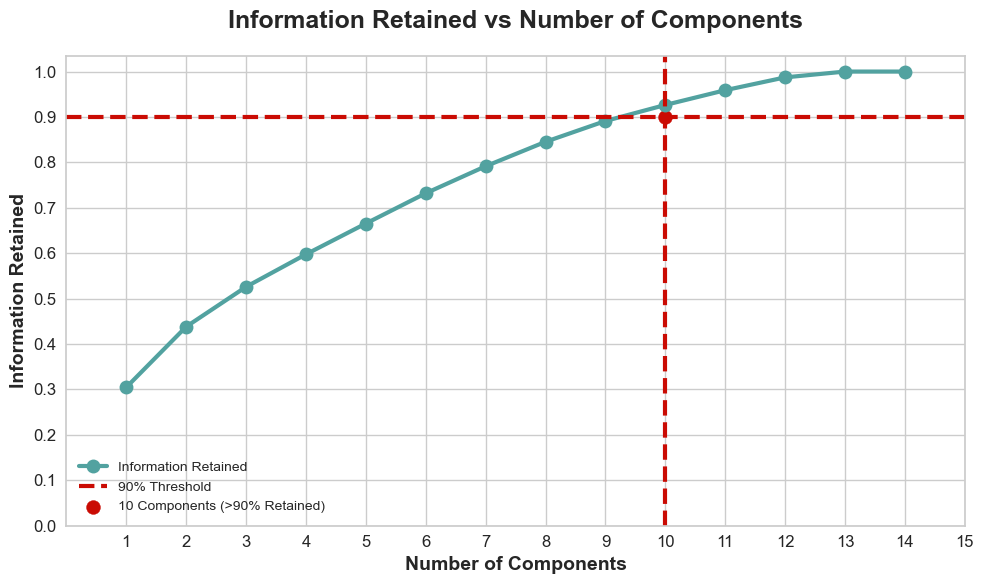

In [46]:
# ==================================================================================================
# How much PCA should i keep to retain >90% of the information ?
# Use it when df_final_features is created (so when it contains both numerical & encoded categorical features)
# ==================================================================================================
# Select numerical+encoded categorical features
list_features = df_data_kmeans_without_cf.columns.tolist()

# Step 1: Standardize the data
X = df_data_kmeans_without_cf[list_features]
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Initialize a list to store information_retained values
information_retained_list = []

# Step 2: Fit PCA
for i in range(1, len(list_features)):
    pca = PCA(n_components=i)  # Specify the number of components
    pca.fit(X_scaled)
    X_pca = pca.transform(X_scaled)
    
    information_retained = sum(pca.explained_variance_ratio_)
    information_retained_list.append(information_retained)

# Create a DataFrame from the information_retained list
info_df = pd.DataFrame({
    'Components': range(1, len(list_features)),
    'Information Retained': information_retained_list
})

# Find the number of components required to retain at least 90% of the information
required_components = info_df[info_df['Information Retained'] >= 0.9]['Components'].iloc[0]
print(required_components)

display(info_df)


# Plot information retained vs number of components
plt.figure(figsize=(10, 6))
plt.plot(info_df['Components'], info_df['Information Retained'], marker='o', linestyle='-', label='Information Retained', color = blue_green)
plt.axhline(y=0.9, color='r', linestyle='--', label='90% Threshold')
plt.axvline(x=required_components, color='r', linestyle='--')
plt.scatter(required_components, 0.9, color='r', marker='o', label=f'{required_components} Components (>90% Retained)')

# Bold title with increased font size
plt.title('Information Retained vs Number of Components', fontsize=18, fontweight='bold')

# Axis labels with increased font size and bold
plt.xlabel('Number of Components', fontsize=14, fontweight='bold')
plt.ylabel('Information Retained', fontsize=14, fontweight='bold')

plt.grid(True)

# Set x-axis ticks to show every 10th component
nb_tick_label = 1
plt.xticks(np.arange(0, len(list_features) + 1, nb_tick_label))
# Define the list of component labels to show every 10th component
component_labels = [str(i) if i % nb_tick_label == 0 else '' for i in range(1, len(list_features) + 1)]

plt.xticks(range(1, len(list_features) + 1), component_labels)
plt.yticks(np.arange(0, 1.1, 0.1))
plt.legend()
plt.tight_layout()
plt.show()



In [47]:
df_data_kmeans_without_cf.columns

Index(['recency', 'frequency', 'total_payment', 'price', 'freight_value',
       'review_score', 'payment_installments', 'product_photos_qty',
       'product_length_cm', 'product_height_cm', 'product_width_cm',
       'Delivery_Delay', 'payment_value', 'product_weight_g', 'cluster'],
      dtype='object')

In [48]:
# ==================================================================================================
# APPLY PCA
# ==================================================================================================
# Select numerical features

# Step 1: Standardize the data / CENTRATE & REDUCE (mean to 0 and STD to 1). 
X = df_data_kmeans_without_cf
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

#  Check mean and standard deviation of the standardized data
print("Mean of standardized data:", np.mean(X_scaled, axis=0))
print("Standard deviation of standardized data:", np.std(X_scaled, axis=0))
print('\n')

# Step 2: Fit PCA
pca = PCA(n_components=10)  # Specify the number of components
X_pca = pca.fit_transform(X_scaled)

# Create a DataFrame for the principal components
df_PCA = pd.DataFrame(X_pca, columns=[f"PC{i+1}" for i in range(10)])

# Print the DataFrame
display(df_PCA)

Mean of standardized data: [ 1.93275000e-17 -2.61541858e-16 -3.93642662e-17 -4.75208258e-17
  3.10658533e-16 -2.78386927e-16  7.94377984e-17 -1.92565734e-16
 -1.03996136e-16  1.46108808e-16  1.79621629e-16  7.89058488e-17
  1.91501835e-17  3.72586325e-17  1.10667669e-16]
Standard deviation of standardized data: [1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1. 1.]




,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10
0,-0.04,0.23,0.16,-0.13,-0.27,-0.16,-2.09,-1.48,0.77,0.02
1,-1.70,-0.11,0.78,0.60,-0.26,-0.53,-0.47,0.36,0.18,-0.00
2,0.62,-0.97,0.84,-1.91,-1.21,0.72,1.27,-1.85,0.85,1.99
3,-1.50,0.55,-0.01,-0.86,1.05,0.50,0.82,-0.82,-0.16,-0.63
4,0.79,0.10,-0.20,-0.44,0.20,-0.55,0.66,-1.16,0.75,-2.76
...,...,...,...,...,...,...,...,...,...,...
80139,-1.62,0.61,-1.19,0.34,-0.63,-0.48,0.29,0.43,-0.39,-0.40
80140,-0.22,-0.88,0.68,0.08,-0.35,-0.26,0.56,0.44,0.65,1.28
80141,-0.96,0.51,-2.12,-1.32,0.53,0.81,2.03,0.48,-0.48,-0.20
80142,-0.64,0.83,-0.42,0.19,0.53,-0.60,-0.17,-1.04,0.12,-0.00


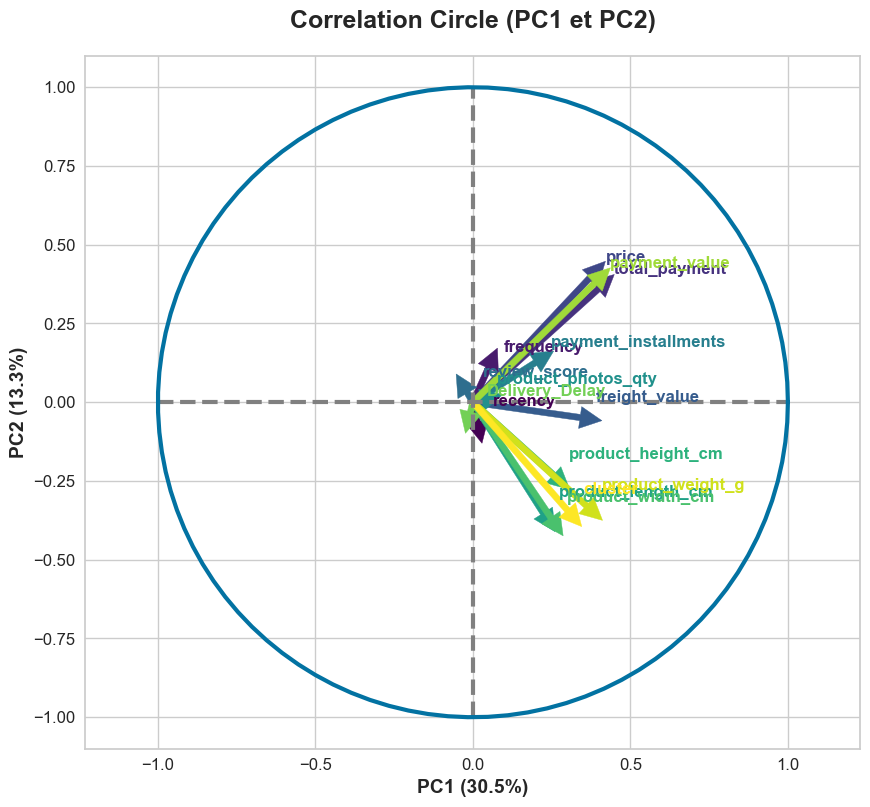

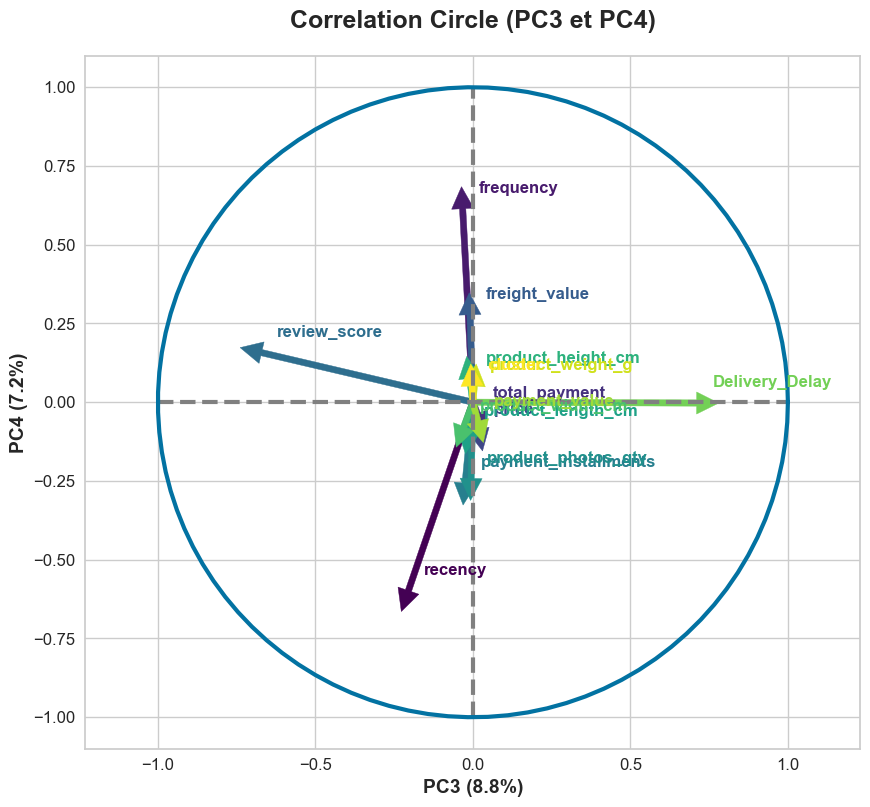

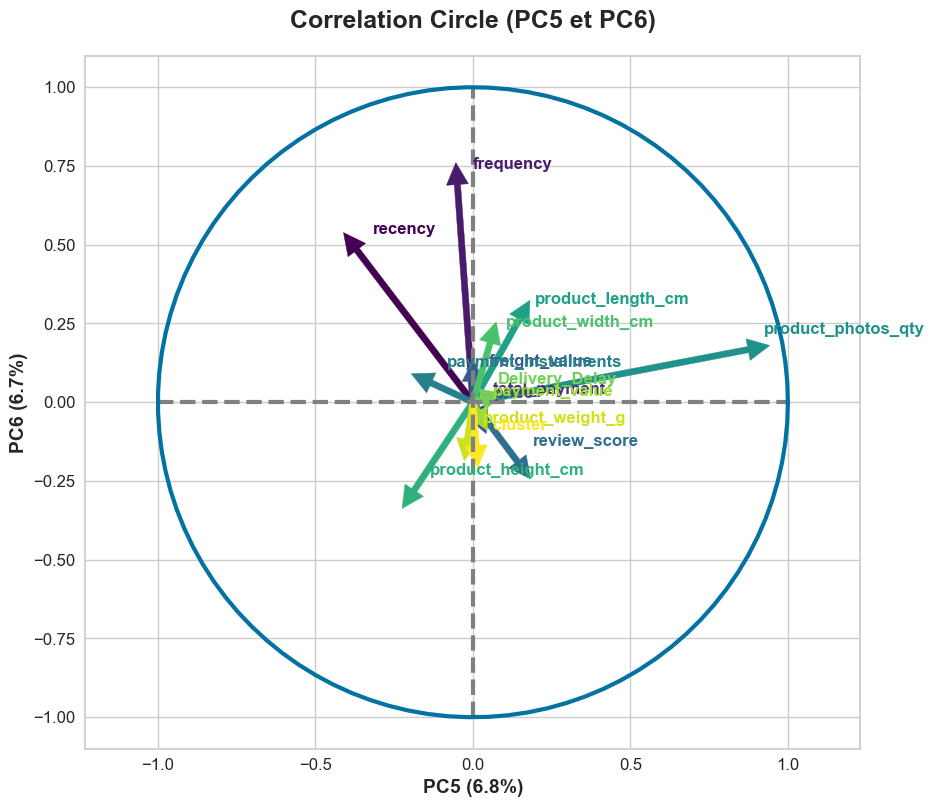

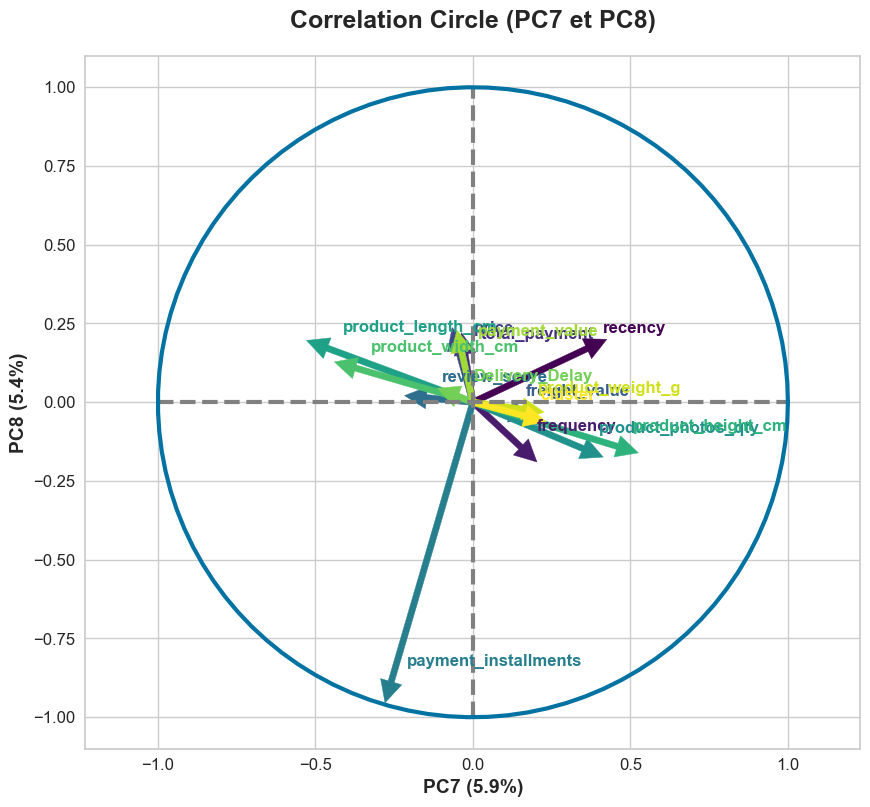

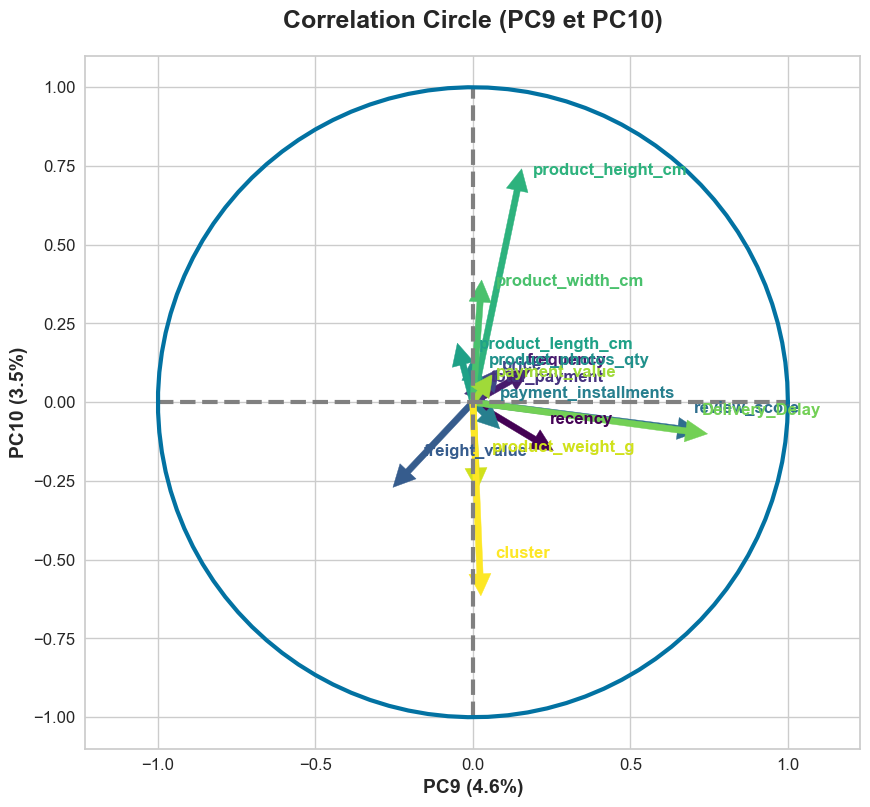

In [49]:
# ==================================================================================================
# PLOT PC1 vs PC2 (Nuage des variables)
# PLOT PC3 vs PC4 (Nuage des variables)
# PLOT PC5 vs PC6 (Nuage des variables)
# ==================================================================================================
def correlation_graph(pca, x_y, features):
    """Affiche le graphe des correlations

    Positional arguments:
    -----------------------------------
    pca : sklearn.decomposition.PCA : notre objet PCA qui a été fit
    x_y : list ou tuple : le couple x,y des plans à afficher, exemple [0,1] pour F1, F2
    features : list ou tuple : la liste des features (ie des dimensions) à représenter
    """

    # Extrait x et y
    x, y = x_y

    # Taille de l'image (en inches)
    fig, ax = plt.subplots(figsize=(10, 9))

    # Define colors for arrows
    arrow_colors = plt.cm.viridis(np.linspace(0, 1, pca.components_.shape[1]))

    # Pour chaque composante :
    for i in range(0, pca.components_.shape[1]):

        # Les flèches avec couleur spécifique
        ax.arrow(0, 0,
                 pca.components_[x, i],
                 pca.components_[y, i],
                 head_width=0.07,
                 head_length=0.07,
                 width=0.02,
                 color=arrow_colors[i])  # Assign unique color to each arrow

        # Les labels avec la même couleur que la flèche
        plt.text(pca.components_[x, i] + 0.05,
                 pca.components_[y, i] + 0.05,
                 features[i],
                 color=arrow_colors[i], fontweight='bold')  # Set text color same as arrow color

    # Affichage des lignes horizontales et verticales
    plt.plot([-1, 1], [0, 0], color='grey', ls='--')
    plt.plot([0, 0], [-1, 1], color='grey', ls='--')

    # Nom des axes, avec le pourcentage d'inertie expliqué
    plt.xlabel('PC{} ({}%)'.format(x+1, round(100*pca.explained_variance_ratio_[x], 1)), fontsize=14, fontweight='bold')
    plt.ylabel('PC{} ({}%)'.format(y+1, round(100*pca.explained_variance_ratio_[y], 1)), fontsize=14, fontweight='bold')

    # Title with font size and weight adjustments
    plt.title("Correlation Circle (PC{} et PC{})".format(x+1, y+1), fontsize=18, fontweight='bold')

    # Le cercle
    an = np.linspace(0, 2 * np.pi, 100)
    plt.plot(np.cos(an), np.sin(an))  # Add a unit circle for scale

    # Axes et display
    plt.axis('equal')
    plt.show(block=False)

# Plot PC1 vs PC2
correlation_graph(pca, (0,1), df_data_kmeans_without_cf.columns)
# Plot PC3 vs PC4
correlation_graph(pca, (2,3), df_data_kmeans_without_cf.columns)
# Plot PC5 vs PC6
correlation_graph(pca, (4,5), df_data_kmeans_without_cf.columns)
# Plot PC7 vs PC8
correlation_graph(pca, (6,7), df_data_kmeans_without_cf.columns)
# Plot PC9 vs PC10
correlation_graph(pca, (8,9), df_data_kmeans_without_cf.columns)

## III.2. Choice of the number of cluster - Data-Driven Technique 1 -  Elbow method, Silhoutette, and Calinski Harabasz

In [50]:
numerical_features = list(df_PCA.select_dtypes(include=['int64','float64', 'uint8']).columns) # without the encodec categorical features
display('There are :  numerical features',len(numerical_features))


# ==================================================================================================
# Choice of the Preprocessor
# ==================================================================================================
# Preprocessor - TEST 0 
preprocessor = None


# Preprocessor - TEST 1 
# scaler = MinMaxScaler()

# preprocessor = ColumnTransformer([
#     ('scaler', scaler, numerical_features)])


# Preprocessor - TEST 2
# scaler = StandardScaler()

# preprocessor = ColumnTransformer([
#     ('scaler', scaler, numerical_features)])


# Preprocessor - TEST 3
# scaler = PowerTransformer()  # Use PowerTransformer

# preprocessor = ColumnTransformer([
#     ('scaler', scaler, numerical_features)])

'There are :  numerical features'

10

[20.079160490851507, 5.762053902555324, 12.704251510943573, 6.09322894286302, 4.317375257129689, 10.001588993810126]


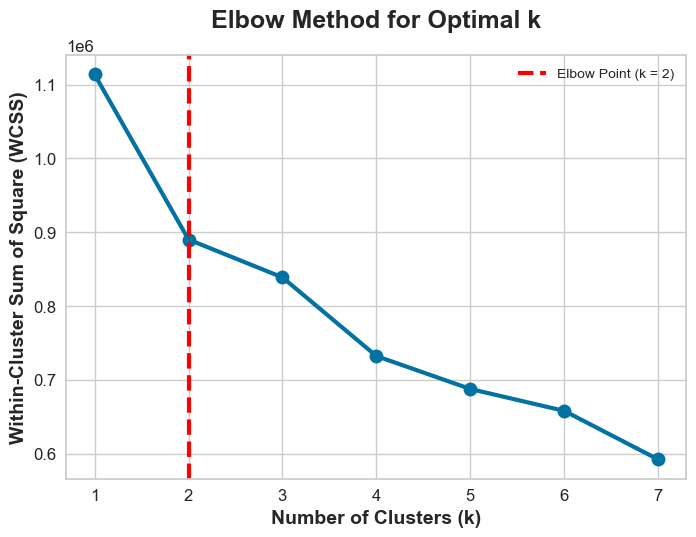

Elbow Point (k = 2)


D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\yellowbrick\utils\kneed.py:156: YellowbrickWarning:

No 'knee' or 'elbow point' detected This could be due to bad clustering, no actual clusters being formed etc.

D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\yellowbrick\cluster\elbow.py:374: YellowbrickWarning:

No 'knee' or 'elbow' point detected, pass `locate_elbow=False` to remove the warning



Visualizer for distortion:


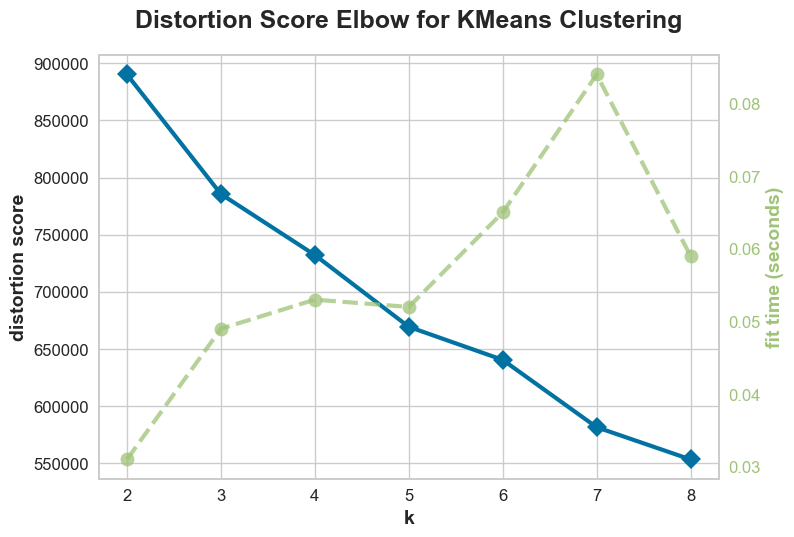

Visualizer for silhouette:


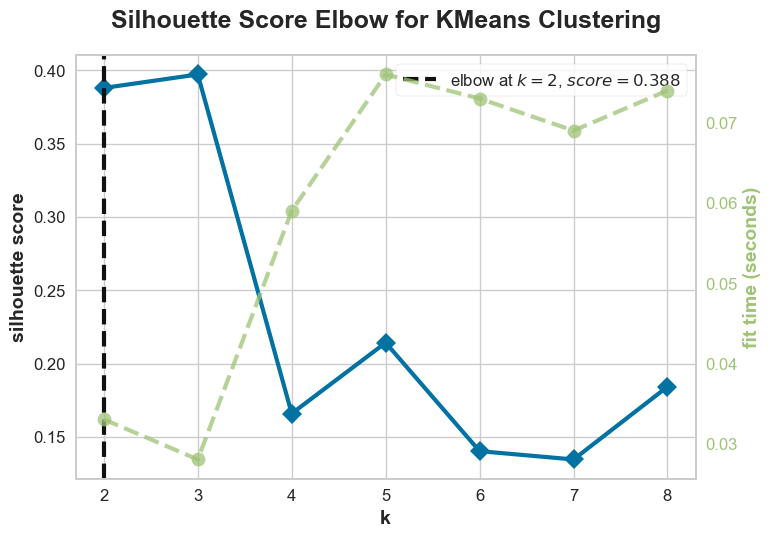

Visualizer for calinski_harabasz:


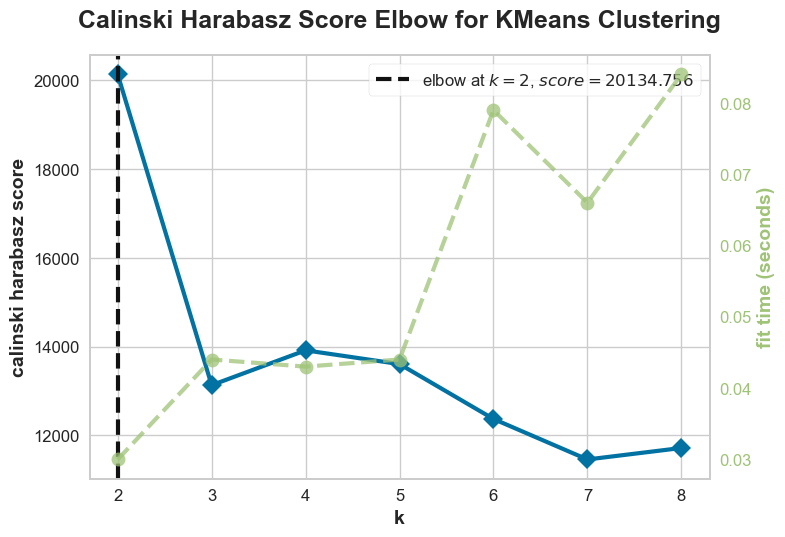

In [51]:
# ==================================================================================================
# Search the optimal number of cluster using Elbow Curve method
# ==================================================================================================
# Initialize an empty list to store the within-cluster sum of squares (WCSS)
wcss = []

# Define a range of clusters to try
max_clusters = 7
k_values = range(1, max_clusters + 1)

# Calculate the WCSS for different values of k
for k in k_values:
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(df_PCA)
    wcss.append(kmeans.inertia_)

# Calculate the percentage decrease in WCSS between successive numbers of clusters
percentage_decrease = [(wcss[i - 1] - wcss[i]) / wcss[i - 1] * 100 for i in range(1, len(wcss))]
print(percentage_decrease)

# Find the index corresponding to a significant drop-off in percentage decrease
threshold_percentage_decrease = 7  # Adjust as needed
elbow_point_index = next((i for i, decrease in enumerate(percentage_decrease) if decrease < threshold_percentage_decrease), None)+1


# ==================================================================================================
# PLOT THE ELBOW CURVE
# ==================================================================================================
# Plot the elbow curve
plt.plot(k_values, wcss, marker='o')
plt.xlabel('Number of Clusters (k)', fontsize=14, fontweight='bold')
plt.ylabel('Within-Cluster Sum of Square (WCSS)',fontsize=14, fontweight='bold')
plt.title('Elbow Method for Optimal k',fontsize=18, fontweight='bold')
plt.grid(True)

# Highlight the elbow point
if elbow_point_index is not None:
    plt.axvline(x=elbow_point_index, color='red', linestyle='--', label=f'Elbow Point (k = {elbow_point_index})')
    plt.legend()

plt.show()

# Print elbow point information
if elbow_point_index is not None:
    print(f'Elbow Point (k = {elbow_point_index})')
else:
    print('No significant elbow point found.')

# ==================================================================================================
# PLOT THE ELBOW CURVE WITH YELLOWBRICK
# ==================================================================================================
metrics_to_use = ['distortion', 'silhouette', 'calinski_harabasz']

# Create a visualizer for each metric and display it
for metric in metrics_to_use:
    # Create the visualizer for the current metric
    kmeans_visualizer = Pipeline([
        ("preprocessor", preprocessor),
        ("kelbowvisualizer", KElbowVisualizer(KMeans(), k=(2, 9), metric=metric))
    ])

    # Fit the visualizer to your data
    kmeans_visualizer.fit(df_PCA)

    # Show the visualizer for the current metric
    print(f'Visualizer for {metric}:')
    kmeans_visualizer.named_steps['kelbowvisualizer'].poof()

## III.3. Choice of the number of cluster - Data-Driven Technique 2 -  SILHOUETTE VISUALIZER

Calculating Silhouette scores for 4 clusters...


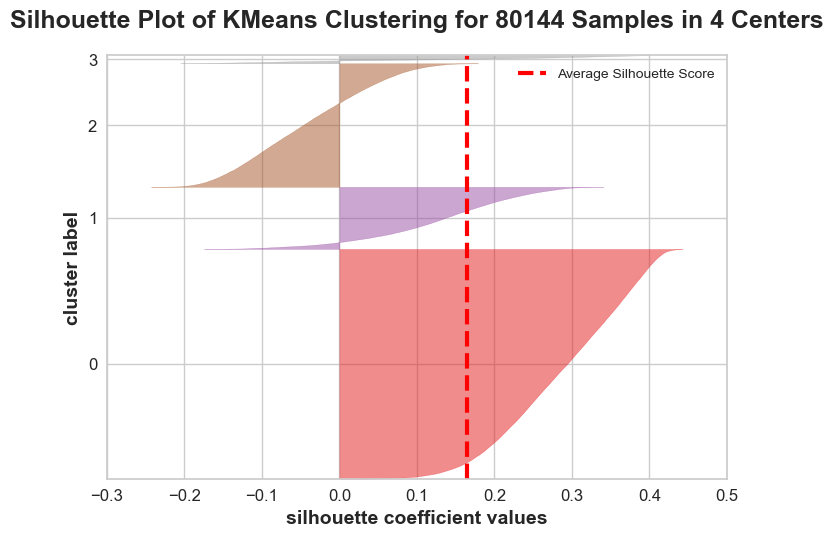

Calculating Silhouette scores for 5 clusters...


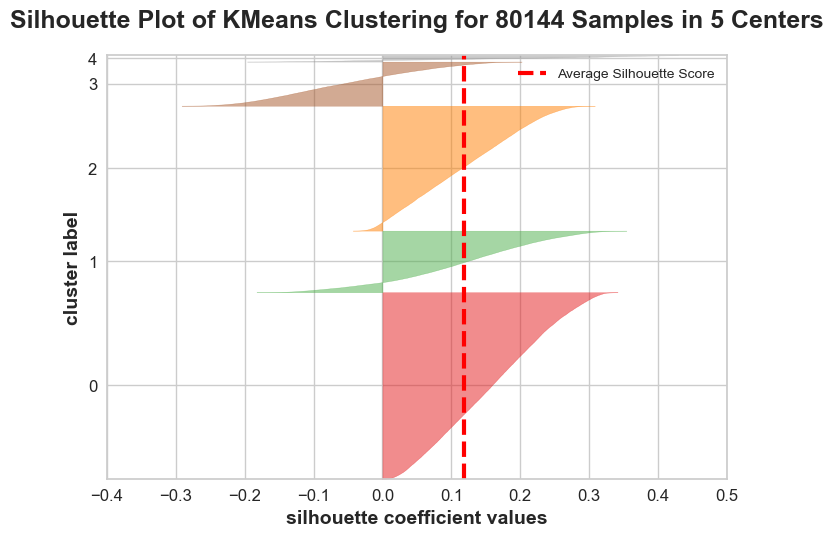

Calculating Silhouette scores for 6 clusters...


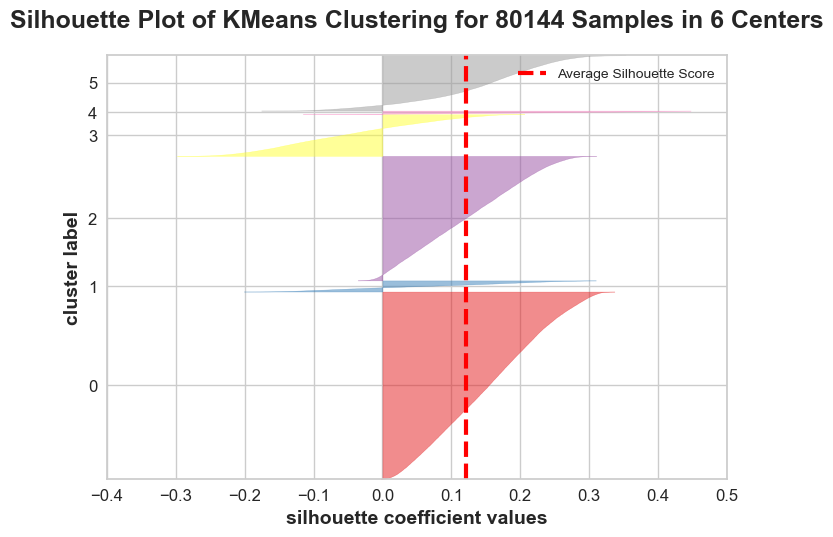

Calculating Silhouette scores for 7 clusters...


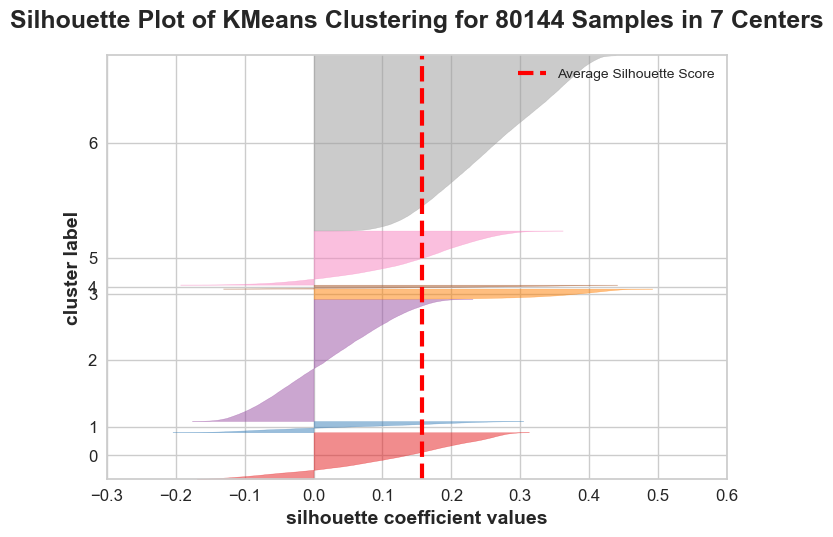

Calculating Silhouette scores for 8 clusters...


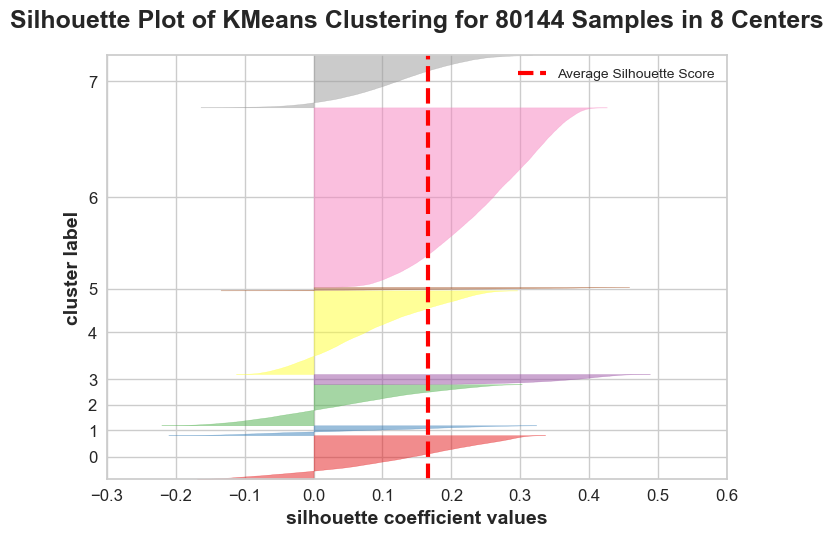

In [52]:
# ==================================================================================================
# SILHOUETTE VISUALIZER WITH YELLOWBRICK
# ==================================================================================================
# Define the range of clusters to try
min_clusters = 4
max_clusters = 8

# Loop through each number of clusters and create Silhouette plots
for num_clusters in range(min_clusters, max_clusters + 1):
    print(f"Calculating Silhouette scores for {num_clusters} clusters...")

    # Instantiate the pipeline with KMeans and SilhouetteVisualizer
    silhouette_visualizer = Pipeline([
        ("preprocessor", preprocessor),
        ("silhouettevisualizer", SilhouetteVisualizer(KMeans(n_clusters=num_clusters, random_state=42)))
    ])

    # Fit the pipeline to your data
    silhouette_visualizer.fit(df_PCA)

    # Show the silhouette visualizer for the current number of clusters
    silhouette_visualizer.named_steps['silhouettevisualizer'].poof()




## III.4. Choice of the number of cluster - Data-Driven Technique 3 -  Intercluster Distance Maps using MDS

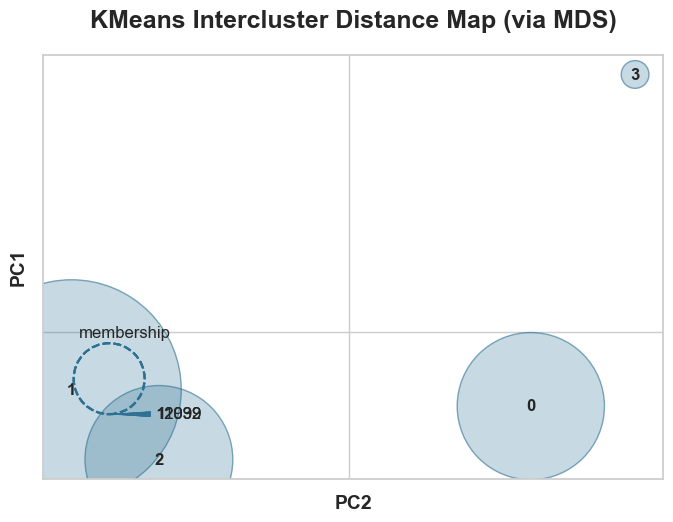

Number of customers in each cluster:
1    54423
2    12099
0    11932
3     1690
Name: count, dtype: int64


In [53]:
# ==================================================================================================
# Intercluster Distance Maps WITH YELLOWBRICK
# ==================================================================================================
nb_cluster = 4
distance_intercluster_visualizer = Pipeline([
    ("preprocessor", preprocessor),
    ("distancevisualizer", InterclusterDistance(KMeans(nb_cluster)))])
distance_intercluster_visualizer.fit(df_PCA)
distance_intercluster_visualizer.named_steps['distancevisualizer'].show()

# ==================================================================================================
# NB of CUSTOMERS by CLUSTER
# ==================================================================================================
# Get the labels assigned to each data point
cluster_labels = distance_intercluster_visualizer.named_steps['distancevisualizer'].labels_

# Count the number of customers in each cluster
cluster_counts = pd.Series(cluster_labels).value_counts()

# Print the number of customers in each cluster
print("Number of customers in each cluster:")
print(cluster_counts)



## III.5. Empirical evaluation of the impact of k-means initialization

Evaluation of KMeans with random init
Evaluation of MiniBatchKMeans with k-means++ init


D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\sklearn\cluster\_kmeans.py:1972: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 2048 or by setting the environment variable OMP_NUM_THREADS=4

D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\sklearn\cluster\_kmeans.py:1972: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 2048 or by setting the environment variable OMP_NUM_THREADS=4

D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\sklearn\cluster\_kmeans.py:1972: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 2048 or by setting the environment variable OMP_NUM_THREADS=4

D:\ANACONDA\envs\OC_PROJET2\Lib\site-packag

Evaluation of MiniBatchKMeans with random init


D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\sklearn\cluster\_kmeans.py:1972: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 2048 or by setting the environment variable OMP_NUM_THREADS=4

D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\sklearn\cluster\_kmeans.py:1972: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 2048 or by setting the environment variable OMP_NUM_THREADS=4

D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\sklearn\cluster\_kmeans.py:1972: UserWarning:

MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 2048 or by setting the environment variable OMP_NUM_THREADS=4

D:\ANACONDA\envs\OC_PROJET2\Lib\site-packag

Evaluation of KMeans with k-means++ init


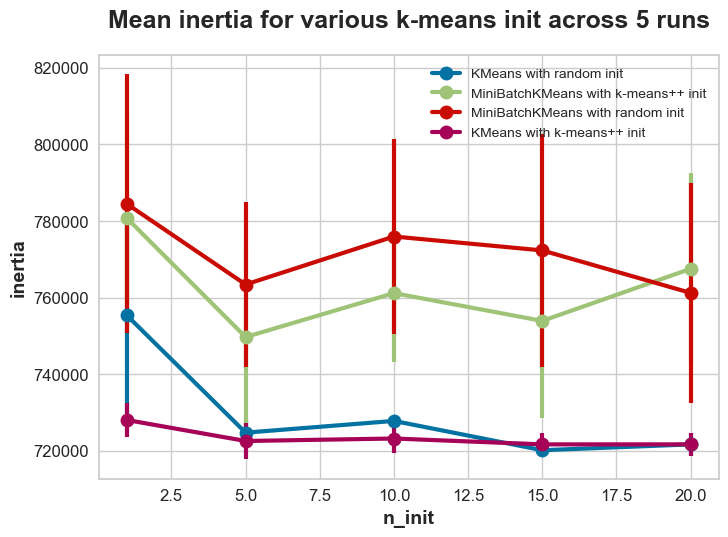

In [54]:
# Set the random state
random_state = np.random.RandomState(42)

# Number of runs for each strategy
n_runs = 5

# Number of initializations
n_init_range = np.array([1, 5, 10, 15, 20])

X = df_PCA.values

plt.figure()
plots = []
legends = []

cases = [
    (KMeans, "random", {}, "o-"),
    (MiniBatchKMeans, "k-means++", {"max_no_improvement": 3}, "x-"),
    (MiniBatchKMeans, "random", {"max_no_improvement": 3, "init_size": 500}, "d-"),
    (KMeans, "k-means++", {}, "^-"),
]

for factory, init, params, format in cases:
    print("Evaluation of %s with %s init" % (factory.__name__, init))
    inertia = np.empty((len(n_init_range), n_runs))

    for run_id in range(n_runs):
        for i, n_init in enumerate(n_init_range):
            km = factory(
                n_clusters=nb_cluster,
                init=init,
                random_state=check_random_state(random_state),
                n_init=n_init,
                **params,
            ).fit(X)
            inertia[i, run_id] = km.inertia_
    p = plt.errorbar(
        n_init_range, inertia.mean(axis=1), inertia.std(axis=1), fmt='-o'
    )
    plots.append(p[0])
    legends.append("%s with %s init" % (factory.__name__, init))

plt.xlabel("n_init")
plt.ylabel("inertia")
plt.legend(plots, legends)
plt.title("Mean inertia for various k-means init across %d runs" % n_runs)
plt.show()

## III.6. CLUSTERING - K MEANS

In [55]:
# ==================================================================================================
# APPLY THE K-MEANS NOW. 
# ==================================================================================================


# Set the number of clusters based on the elbow method or any other criterion
num_clusters = nb_cluster

# Define the pipeline including preprocessing and KMeans
kmeans_pipeline = Pipeline([
    ("preprocessor", preprocessor),  # Assuming you have defined preprocessor earlier
    ("kmeans", KMeans(n_clusters=num_clusters, random_state=42, n_init='auto'))
])

# Fit the pipeline to the RFM dataset
kmeans_pipeline.fit(df_PCA)

# Get the cluster labels for each data point
cluster_labels = kmeans_pipeline.named_steps['kmeans'].labels_

# Add the cluster labels to the DataFrame
df_PCA['cluster'] = cluster_labels



# ==================================================================================================
# GET SOME STATS ON THE CLUSTERS
# ==================================================================================================
# Iterate over each cluster label
for cluster_label in range(num_clusters):
    # Count the number of customers in the current cluster
    cluster_count = len(df_PCA[df_PCA['cluster'] == cluster_label])
    # Print the count for the current cluster
    print(f'CLUSTER {cluster_label} contains {cluster_count} customers')






# ==================================================================================================
# SILHOUETTE SCORE
# ==================================================================================================
# Compute the silhouette score
silhouette_avg = silhouette_score(df_PCA.drop(columns=['cluster']), cluster_labels)
print(f"Silhouette Score: {silhouette_avg}")

# ==================================================================================================
# DAVIES-BOULDIN
# ==================================================================================================
# Compute the Davies-Bouldin index
davies_bouldin_idx = davies_bouldin_score(df_PCA.drop(columns=['cluster']), cluster_labels)
print(f"Davies-Bouldin Index: {davies_bouldin_idx}")

CLUSTER 0 contains 43498 customers
CLUSTER 1 contains 11753 customers
CLUSTER 2 contains 23383 customers
CLUSTER 3 contains 1510 customers
Silhouette Score: 0.16506666492855324
Davies-Bouldin Index: 2.068074572656677


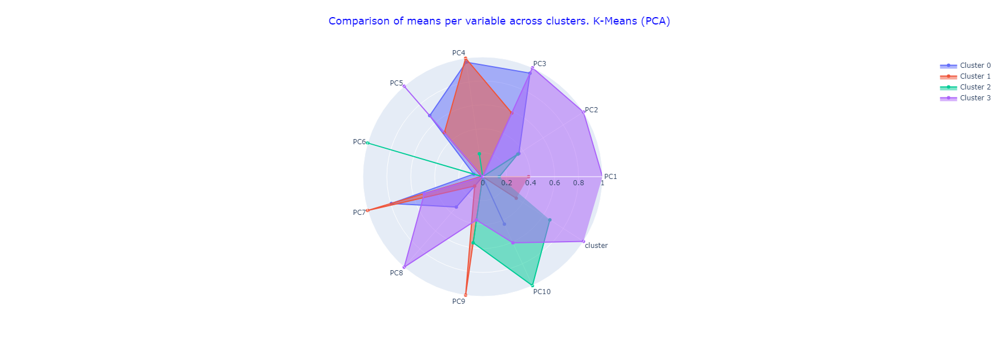

In [56]:
# ==================================================================================================
# DIFFERENCES BETWEEN CLUSTERS - Radar Plot using Plotly
# ==================================================================================================
def plot_radars(data, group, width=800, height=600):
    scaler = MinMaxScaler()
    data = pd.DataFrame(scaler.fit_transform(data), 
                        index=data.index,
                        columns=data.columns).reset_index()
    
    fig = go.Figure()

    # Sort the data by the cluster labels
    data_sorted = data.sort_values(by=[group])

    for k in data_sorted[group].unique():
        cluster_data = data_sorted[data_sorted[group] == k]
        fig.add_trace(go.Scatterpolar(
            r=cluster_data.iloc[:, 1:].values.reshape(-1),
            theta=data.columns[1:],
            fill='toself',
            name='Cluster ' + str(k)
        ))

    fig.update_layout(
        polar=dict(
            radialaxis=dict(
                visible=True,
                range=[0, 1]
            )),
        showlegend=True,
        title={
            'text': "Comparison of means per variable across clusters.\nK-Means (PCA)",
            'y': 0.95,
            'x': 0.5,
            'xanchor': 'center',
            'yanchor': 'top'},
        title_font_color="blue",
        title_font_size=18,
        width=width,
        height=height)

    fig.show()
    fig.write_html("kmeans_PCA_radar_plot2.html")

numerical_features = list(df_PCA.select_dtypes(include=['int32', 'int64','float64', 'uint8']).columns)
# Preprocessor
scaler = MinMaxScaler()

preprocessor = ColumnTransformer([
    ('scaler', scaler, numerical_features)])
X_scaled = preprocessor.fit_transform(df_PCA)
X_scaled = pd.DataFrame(X_scaled, index=df_PCA.index, columns=df_PCA.columns)
X_scaled["kmeans_label"] = cluster_labels
X_scaled_clusters = X_scaled.groupby("kmeans_label").mean()
X_scaled_clusters


plot_radars(data=X_scaled_clusters, group="kmeans_label", width=600, height=600)


In [57]:
df_data_kmeans_without_cf.columns

Index(['recency', 'frequency', 'total_payment', 'price', 'freight_value',
       'review_score', 'payment_installments', 'product_photos_qty',
       'product_length_cm', 'product_height_cm', 'product_width_cm',
       'Delivery_Delay', 'payment_value', 'product_weight_g', 'cluster'],
      dtype='object')

D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\seaborn\_oldcore.py:1057: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



Cluster 0, Mean of recency: 234.33
Cluster 0, Mode of recency: 277

Cluster 2, Mean of recency: 237.47
Cluster 2, Mode of recency: 277

Cluster 3, Mean of recency: 272.32
Cluster 3, Mode of recency: 278

Cluster 1, Mean of recency: 242.79
Cluster 1, Mode of recency: 278



D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\seaborn\_oldcore.py:1057: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



Cluster 0, Mean of frequency: 1.03
Cluster 0, Mode of frequency: 1

Cluster 2, Mean of frequency: 1.02
Cluster 2, Mode of frequency: 1

Cluster 3, Mean of frequency: 1.02
Cluster 3, Mode of frequency: 1

Cluster 1, Mean of frequency: 1.02
Cluster 1, Mode of frequency: 1



D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\seaborn\_oldcore.py:1057: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



Cluster 0, Mean of total_payment: 146.30
Cluster 0, Mode of total_payment: 95.24

Cluster 2, Mean of total_payment: 257.91
Cluster 2, Mode of total_payment: 114.6

Cluster 3, Mean of total_payment: 724.17
Cluster 3, Mode of total_payment: 433.86

Cluster 1, Mean of total_payment: 395.73
Cluster 1, Mode of total_payment: 257.54



D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\seaborn\_oldcore.py:1057: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



Cluster 0, Mean of review_score: 4.23
Cluster 0, Mode of review_score: 5.0

Cluster 2, Mean of review_score: 4.19
Cluster 2, Mode of review_score: 5.0

Cluster 3, Mean of review_score: 4.00
Cluster 3, Mode of review_score: 5.0

Cluster 1, Mean of review_score: 4.06
Cluster 1, Mode of review_score: 5.0



D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\seaborn\_oldcore.py:1057: FutureWarning:

The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.



Cluster 0, Mean of Delivery_Delay: -11.77
Cluster 0, Mode of Delivery_Delay: -14.0

Cluster 2, Mean of Delivery_Delay: -11.89
Cluster 2, Mode of Delivery_Delay: -14.0

Cluster 3, Mean of Delivery_Delay: -10.56
Cluster 3, Mode of Delivery_Delay: -14.0

Cluster 1, Mean of Delivery_Delay: -11.43
Cluster 1, Mode of Delivery_Delay: -14.0



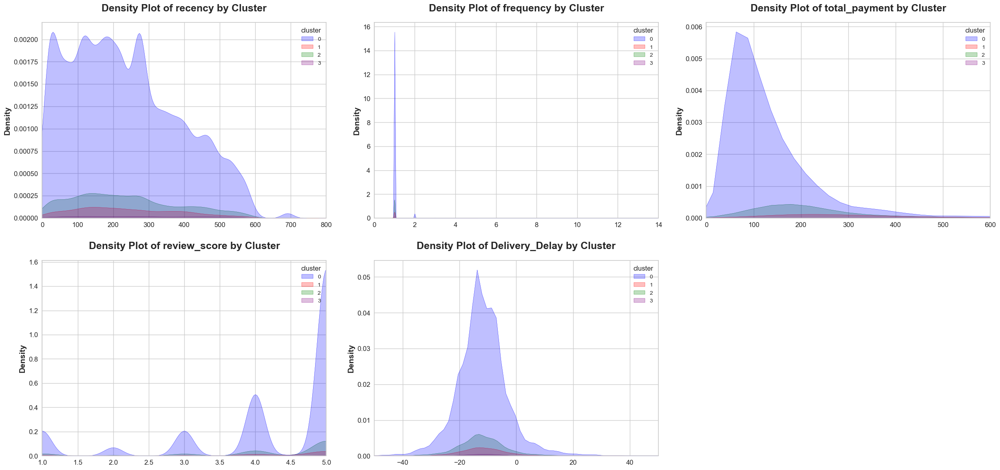

In [58]:
# Check if 'cluster' column exists and is categorical
if 'cluster' not in df_data_kmeans_without_cf.columns:
    df_data_kmeans_without_cf['cluster'] = cluster_labels  # Assuming 'cluster_labels' contains cluster assignments
else:
    df_data_kmeans_without_cf['cluster'] = df_data_kmeans_without_cf['cluster'].astype('category')

# Define the features for plotting
features_to_plot = ['recency', 'frequency', 'total_payment', 'review_score', 'Delivery_Delay']
x_limits = {'recency': (0, 800),
            'frequency': (0, 14),
            'total_payment': (0, 600),
            'review_score': (1, 5),
            'Delivery_Delay': (-50, 50)}

# Calculate the number of rows for subplots
num_features = len(features_to_plot)
num_rows = (num_features + 2) // 3  # Adjusted for three subplots per row

# Define the size of the figure
fig_width = 25  # Adjust as needed
fig_height = num_rows * 6  # Adjust as needed

# Create subplots with a larger figure size
fig, axes = plt.subplots(num_rows, 3, figsize=(fig_width, fig_height))  # Changed to 3 columns

# Flatten axes if only one row
if num_rows == 1:
    axes = [axes]

# Define custom colors for each cluster
colors = ['blue', 'red', 'green', 'purple']

# Plot density plots for each numerical feature
for i, feature in enumerate(features_to_plot):
    row_index = i // 3  # Adjusted for three subplots per row
    col_index = i % 3  # Adjusted for three subplots per row
    ax = axes[row_index][col_index]
    
    sns.kdeplot(data=df_data_kmeans_without_cf, x=feature, hue='cluster', palette=colors, fill=True, ax=ax)
    ax.set_title(f'Density Plot of {feature} by Cluster')
    ax.set_xlabel('')
    ax.set_ylabel('Density')
    
    # Set x-axis limits
    if feature in x_limits:
        ax.set_xlim(x_limits[feature])
    
    # Iterate over clusters
    for cluster, color in zip(df_data_kmeans_without_cf['cluster'].unique(), colors):
        cluster_data = df_data_kmeans_without_cf[df_data_kmeans_without_cf['cluster'] == cluster][feature]
        
        # Calculate and print mean
        mean_value = cluster_data.mean()
        print(f"Cluster {cluster}, Mean of {feature}: {mean_value:.2f}")
        
        # Calculate and print mode
        mode_value = cluster_data.mode().values[0]
        print(f"Cluster {cluster}, Mode of {feature}: {mode_value}\n")
    
# Remove empty subplots
if num_features % 3 != 0:  # Adjusted for three subplots per row
    for i in range(num_features % 3, 3):  # Adjusted for three subplots per row
        axes[-1][i].remove()

# Adjust layout
plt.tight_layout(pad=2)  # Adjust spacing between subplots
plt.show()


D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.

D:\ANACONDA\envs\OC_PROJET2\Lib\site-packages\seaborn\_oldcore.py:1119: FutureWarning:

use_inf_as_na option is deprecated and will 

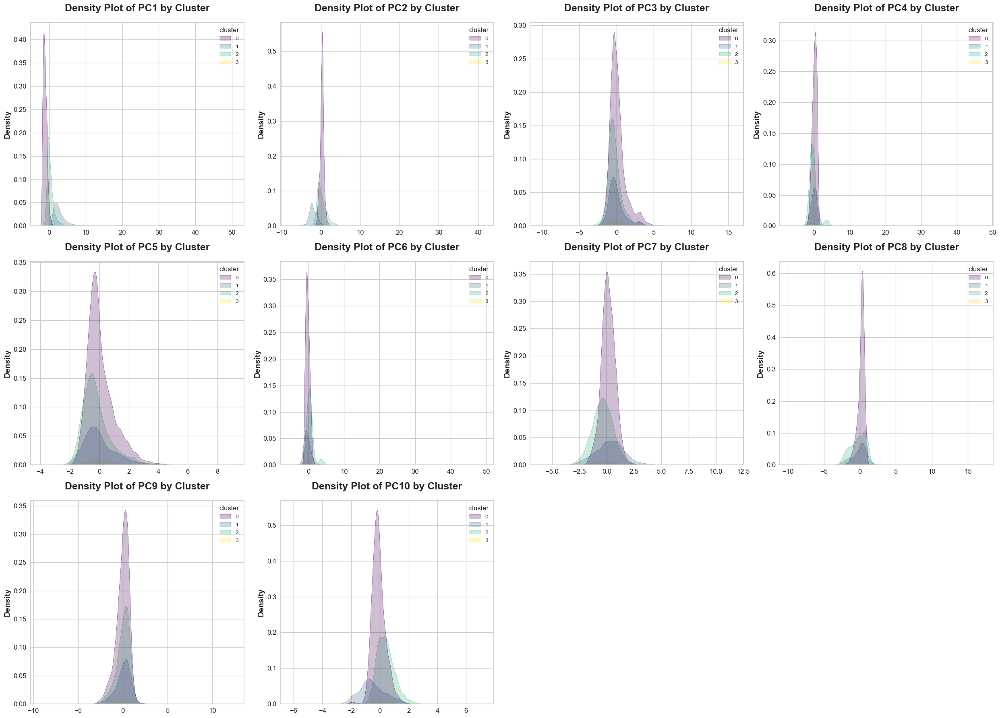

In [59]:
# ==================================================================================================
# DENSITY PLOTS BY CLUSTER
# ==================================================================================================
# Define the numerical features for plotting
# numerical_features = df_data.select_dtypes(include=np.number).columns.tolist()
numerical_features = list(df_PCA.select_dtypes(include=['int64','float64', 'uint8']).columns)

# Calculate the number of rows for subplots
num_features = len(numerical_features)
num_rows = (num_features + 3) // 4  # Round up to the nearest integer

# Define the size of the figure
fig_width = 25  # Adjust as needed
fig_height = num_rows * 6  # Adjust as needed

# Create subplots with a larger figure size
fig, axes = plt.subplots(num_rows, 4, figsize=(fig_width, fig_height))

# Flatten axes if only one row
if num_rows == 1:
    axes = [axes]

# Plot density plots for each numerical feature
for i, feature in enumerate(numerical_features):
    row_index = i // 4
    col_index = i % 4
    ax = axes[row_index][col_index]
    
    sns.kdeplot(data=df_PCA, x=feature, hue='cluster', palette='viridis', fill=True, ax=ax)
    ax.set_title(f'Density Plot of {feature} by Cluster')
    ax.set_xlabel('')
    ax.set_ylabel('Density')

# Remove empty subplots
if num_features % 4 != 0:
    for i in range(num_features % 4, 4):
        axes[-1][i].remove()

# Adjust layout
plt.tight_layout()
plt.show()

## III.7 SAVE DATA

In [60]:
# ==================================================================================================
# SAVE DATA INTO EXCEL (df_PCA.xlsx)
# ==================================================================================================
# Specify the file path where you want to save the CSV file
csv_file_path = r'C:\Users\Olivi\OneDrive\Documents\OC_Formation_DATA_SCIENCE\PROJET5_segmentez_des_clients_dun_site_ecommerce\DATA\df_PCA.csv'

# Write the DataFrame to CSV
df_PCA.to_csv(csv_file_path, index=True)

# Print a message indicating the successful save
print(f"Cleaned data has been successfully saved to: {csv_file_path}")




# ==================================================================================================
# SAVE DATA INTO EXCEL (df_PCA.xlsx)
# ==================================================================================================
# Specify the file path where you want to save the CSV file
csv_file_path = r'C:\Users\Olivi\OneDrive\Documents\OC_Formation_DATA_SCIENCE\PROJET5_segmentez_des_clients_dun_site_ecommerce\DATA\df_data_kmeans_without_cf.csv'

# Write the DataFrame to CSV
df_data_kmeans_without_cf.to_csv(csv_file_path, index=True)

# Print a message indicating the successful save
print(f"Cleaned data has been successfully saved to: {csv_file_path}")



Cleaned data has been successfully saved to: C:\Users\Olivi\OneDrive\Documents\OC_Formation_DATA_SCIENCE\PROJET5_segmentez_des_clients_dun_site_ecommerce\DATA\df_PCA.csv
Cleaned data has been successfully saved to: C:\Users\Olivi\OneDrive\Documents\OC_Formation_DATA_SCIENCE\PROJET5_segmentez_des_clients_dun_site_ecommerce\DATA\df_data_kmeans_without_cf.csv


## III.8. Evaluation of cluster 

In [61]:
df_PCA.columns

Index(['PC1', 'PC2', 'PC3', 'PC4', 'PC5', 'PC6', 'PC7', 'PC8', 'PC9', 'PC10',
       'cluster'],
      dtype='object')

In [62]:
# ==================================================================================================
# SILHOUETTE SCORE
# ==================================================================================================
# Compute the silhouette score
silhouette_avg = silhouette_score(df_PCA.drop(columns=['cluster']), cluster_labels)
print(f"Silhouette Score: {silhouette_avg}")

# ==================================================================================================
# DAVIES-BOULDIN
# ==================================================================================================
# Compute the Davies-Bouldin index
davies_bouldin_idx = davies_bouldin_score(df_PCA.drop(columns=['cluster']), cluster_labels)
print(f"Davies-Bouldin Index: {davies_bouldin_idx}")

Silhouette Score: 0.16506666492855324
Davies-Bouldin Index: 2.068074572656677


# IV. Data-Driven Technique - DBSCAN

In [63]:
df_PCA

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,cluster
0,-0.04,0.23,0.16,-0.13,-0.27,-0.16,-2.09,-1.48,0.77,0.02,2
1,-1.70,-0.11,0.78,0.60,-0.26,-0.53,-0.47,0.36,0.18,-0.00,0
2,0.62,-0.97,0.84,-1.91,-1.21,0.72,1.27,-1.85,0.85,1.99,2
3,-1.50,0.55,-0.01,-0.86,1.05,0.50,0.82,-0.82,-0.16,-0.63,0
4,0.79,0.10,-0.20,-0.44,0.20,-0.55,0.66,-1.16,0.75,-2.76,2
...,...,...,...,...,...,...,...,...,...,...,...
80139,-1.62,0.61,-1.19,0.34,-0.63,-0.48,0.29,0.43,-0.39,-0.40,0
80140,-0.22,-0.88,0.68,0.08,-0.35,-0.26,0.56,0.44,0.65,1.28,0
80141,-0.96,0.51,-2.12,-1.32,0.53,0.81,2.03,0.48,-0.48,-0.20,0
80142,-0.64,0.83,-0.42,0.19,0.53,-0.60,-0.17,-1.04,0.12,-0.00,0


In [64]:
df_data_kmeans_without_cf.dtypes

recency                    int64
frequency                  int64
total_payment            float64
price                    float64
freight_value            float64
review_score             float64
payment_installments     float64
product_photos_qty       float64
product_length_cm        float64
product_height_cm        float64
product_width_cm         float64
Delivery_Delay           float64
payment_value            float64
product_weight_g         float64
cluster                 category
dtype: object

,Population Mean,Sampled Data Mean,Population Standard Deviation,Sampled Data Standard Deviation
recency,235.42,236.29,152.51,151.75
frequency,1.03,1.03,0.18,0.18
total_payment,175.13,175.79,215.72,215.73
price,133.23,133.98,199.16,199.31
freight_value,20.95,20.91,16.72,16.56
review_score,4.21,4.22,1.23,1.23
payment_installments,2.87,2.87,2.64,2.64
product_photos_qty,2.29,2.29,1.76,1.76
product_length_cm,30.04,30.01,16.03,15.81
product_height_cm,16.45,16.49,13.20,13.16


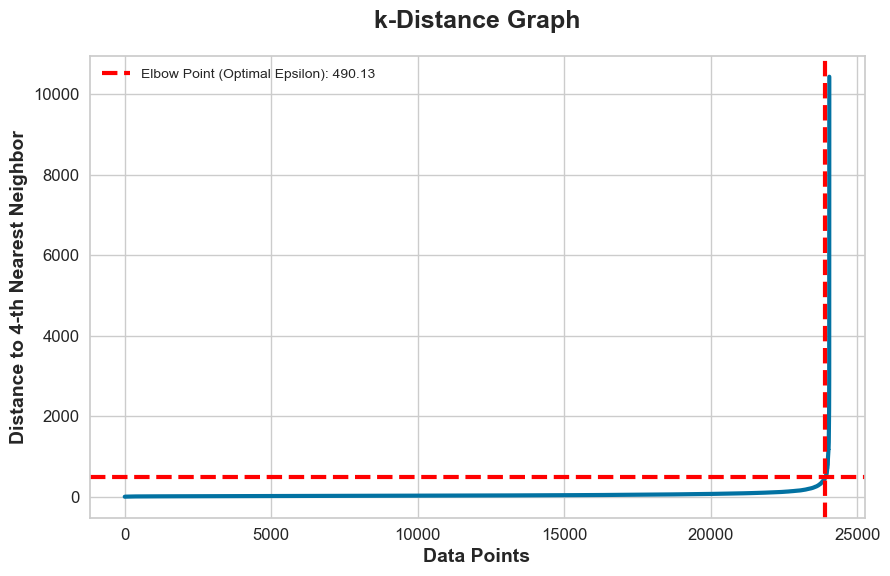

Optimal Epsilon Value: 490.1295600144926


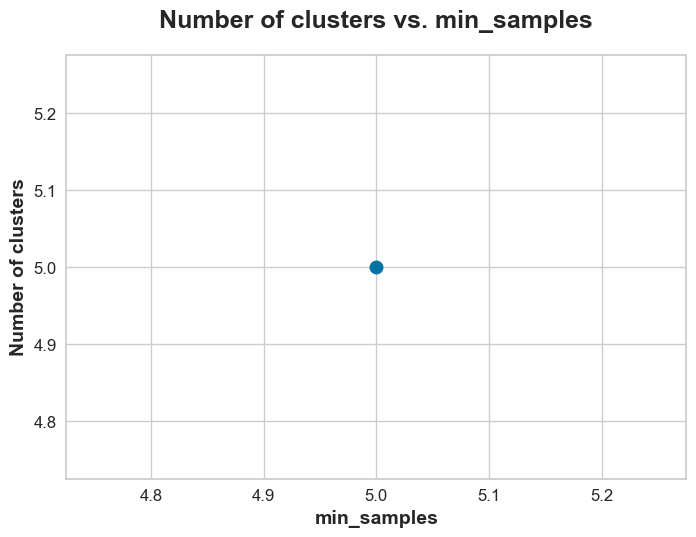

Optimal values: epsilon=490.1295600144926, min_samples=5
CLUSTER 0 contains 23850 customers
CLUSTER 1 contains 4 customers
CLUSTER 2 contains 65 customers
CLUSTER 3 contains 12 customers
CLUSTER 4 contains 5 customers
Number of noise points: 107


In [65]:
'''
Note:
I cannot use DBSCAN on the full dataset due to memory problems. 
I will create a sample which reflects the proportions of the differents groups present in the population using Stratified sampling. 
'''


# ==================================================================================================
# CREATE THE SAMPLE
# ==================================================================================================
# Assuming df_data_kmeans_without_cf is your population DataFrame
population_mean = df_data_kmeans_without_cf.drop(columns=['cluster']).mean()
population_std = df_data_kmeans_without_cf.drop(columns=['cluster']).std()

# Define the size of the sample you want to take (30% of the population)
sample_size = int(0.3 * len(df_data_kmeans_without_cf.drop(columns=['cluster'])))

# Take a random sample from the population
df_data_sample = df_data_kmeans_without_cf.drop(columns=['cluster']).sample(n=sample_size, random_state=42)

# Compare population and sample statistics
comparison = pd.DataFrame({
    'Population Mean': df_data_kmeans_without_cf.drop(columns=['cluster']).mean(),
    'Sampled Data Mean': df_data_sample.mean(),
    'Population Standard Deviation': df_data_kmeans_without_cf.drop(columns=['cluster']).std(),
    'Sampled Data Standard Deviation': df_data_sample.std()
})

display(comparison)



# # ==================================================================================================
# # Choose EPS and MIN_SAMPLES
# # ==================================================================================================

df_data_sample_to_use = df_data_sample
# Compute the distances to the k-th nearest neighbor
k = 4  # You can adjust this value
neighbors = NearestNeighbors(n_neighbors=k)
neighbors.fit(df_data_sample_to_use)
distances, _ = neighbors.kneighbors(df_data_sample_to_use)

# Sort the distances and flatten the array
sorted_distances = np.sort(distances[:, -1])
sorted_distances_flat = sorted_distances.flatten()

# Plot the sorted distances
plt.figure(figsize=(10, 6))
plt.plot(np.arange(len(sorted_distances_flat)), sorted_distances_flat)
plt.xlabel('Data Points')
plt.ylabel(f'Distance to {k}-th Nearest Neighbor')
plt.title('k-Distance Graph')
plt.grid(True)

# Find the elbow point (optimal epsilon)
threshold = 5  # Adjust this threshold as needed
for i in range(1, len(sorted_distances_flat)):
    if sorted_distances_flat[i] - sorted_distances_flat[i-1] > threshold:
        elbow_index = i
        break

optimal_epsilon = sorted_distances_flat[elbow_index]

# Add a horizontal & verttical line at the level of the optimal epsilon value
plt.axvline(x=elbow_index, color='red', linestyle='--', label=f'Elbow Point (Optimal Epsilon): {optimal_epsilon:.2f}')
plt.axhline(y=optimal_epsilon, color='red', linestyle='--')

plt.legend()
plt.show()

print(f'Optimal Epsilon Value: {optimal_epsilon}')


# # Once you determine epsilon, set it and find the optimal min_samples
# min_samples_range = np.arange(5, 10)  # You can adjust the range
# for min_samples in min_samples_range:
#     dbscan = DBSCAN(eps=optimal_epsilon, min_samples=min_samples)
#     cluster_labels = dbscan.fit_predict(df_data_sample_to_use)
#     num_clusters = len(set(cluster_labels)) - (1 if -1 in cluster_labels else 0)
#     if num_clusters > 1:
#         break

# Define the range of min_samples
min_samples_range = np.arange(5, 10)

# Initialize lists to store the number of clusters and the chosen min_samples
num_clusters_list = []
chosen_min_samples = None

# Iterate over the min_samples range
for min_samples in min_samples_range:
    # Create DBSCAN instance with optimal_epsilon and current min_samples
    dbscan = DBSCAN(eps=optimal_epsilon, min_samples=min_samples)
    
    # Fit DBSCAN to the sample data
    cluster_labels = dbscan.fit_predict(df_data_sample_to_use)
    
    # Count the number of clusters
    num_clusters = len(set(cluster_labels)) - (1 if -1 in cluster_labels else 0)
    
    # Append the number of clusters to the list
    num_clusters_list.append(num_clusters)
    
    # If more than one cluster is found, break the loop and store the chosen min_samples
    if num_clusters > 1:
        chosen_min_samples = min_samples
        break

# Plot the number of clusters as a function of min_samples
plt.plot(min_samples_range[:len(num_clusters_list)], num_clusters_list, marker='o')
plt.xlabel('min_samples')
plt.ylabel('Number of clusters')
plt.title('Number of clusters vs. min_samples')
plt.grid(True)
plt.show()


print(f'Optimal values: epsilon={optimal_epsilon}, min_samples={min_samples}')


# optimal_epsilon = 5
# min_samples = 2
# ==================================================================================================
# APPLY DBSCAN ON THE STRATIFIED SAMPLE
# ==================================================================================================
# Initialize DBSCAN with parameters
dbscan = DBSCAN(eps=optimal_epsilon, min_samples=min_samples)

# Fit DBSCAN to the RFM dataset
cluster_labels = dbscan.fit_predict(df_data_sample_to_use)

# Add the cluster labels to the DataFrame
df_data_sample_to_use['cluster'] = cluster_labels

# Get the number of clusters (excluding noise points)
num_clusters = len(set(cluster_labels)) - (1 if -1 in cluster_labels else 0)

# Print statistics for each cluster
for cluster_label in range(num_clusters):
    # Count the number of customers in the current cluster
    cluster_count = len(df_data_sample_to_use[df_data_sample_to_use['cluster'] == cluster_label])
    # Print the count for the current cluster
    print(f'CLUSTER {cluster_label} contains {cluster_count} customers')

# Check the number of noise points
noise_points = len(df_data_sample_to_use[df_data_sample_to_use['cluster'] == -1])
print(f'Number of noise points: {noise_points}')


## IV.2. Evaluation of cluster - SILHOUETTE VISUALIZER + Index DAVIES-BOULDIN

In [66]:
# ==================================================================================================
# SILHOUETTE SCORE
# ==================================================================================================
# Compute the silhouette score
silhouette_avg = silhouette_score(df_data_sample_to_use.drop(columns=['cluster']), cluster_labels)
print(f"Silhouette Score: {silhouette_avg}")

# ==================================================================================================
# DAVIES-BOULDIN
# ==================================================================================================
# Compute the Davies-Bouldin index
davies_bouldin_idx = davies_bouldin_score(df_data_sample_to_use.drop(columns=['cluster']), cluster_labels)
print(f"Davies-Bouldin Index: {davies_bouldin_idx}")

Silhouette Score: 0.3404509593725882
Davies-Bouldin Index: 0.9075619136399459


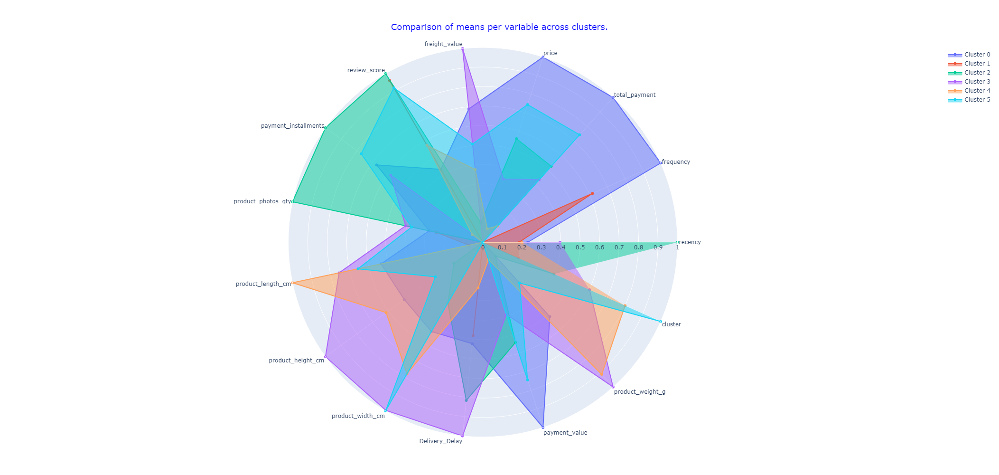

In [67]:
# ==================================================================================================
# DIFFERENCES BETWEEN CLUSTERS - Radar Plot using Plotly
# ==================================================================================================
def plot_radars(data, group, width=800, height=600):
    scaler = MinMaxScaler()
    data = pd.DataFrame(scaler.fit_transform(data), 
                        index=data.index,
                        columns=data.columns).reset_index()
    
    fig = go.Figure()

    # Sort the data by the cluster labels
    data_sorted = data.sort_values(by=[group])

    for k in data_sorted[group].unique():
        cluster_data = data_sorted[data_sorted[group] == k]
        fig.add_trace(go.Scatterpolar(
            r=cluster_data.iloc[:, 1:].values.reshape(-1),
            theta=data.columns[1:],
            fill='toself',
            name='Cluster ' + str(k+1)
        ))

    fig.update_layout(
        polar=dict(
            radialaxis=dict(
                visible=True,
                range=[0, 1]
            )),
        showlegend=True,
        title={
            'text': "Comparison of means per variable across clusters.",
            'y': 0.95,
            'x': 0.5,
            'xanchor': 'center',
            'yanchor': 'top'},
        title_font_color="blue",
        title_font_size=18,
        width=width,
        height=height)

    fig.show()


numerical_features = list(df_data_sample_to_use.select_dtypes(include=['int32', 'int64','float64', 'uint8']).columns)
# Preprocessor
scaler = MinMaxScaler()

preprocessor = ColumnTransformer([
    ('scaler', scaler, numerical_features)])
X_scaled = preprocessor.fit_transform(df_data_sample_to_use)
X_scaled = pd.DataFrame(X_scaled, index=df_data_sample_to_use.index, columns=df_data_sample_to_use.columns)
X_scaled["kmeans_label"] = cluster_labels
X_scaled_clusters = X_scaled.groupby("kmeans_label").mean()
X_scaled_clusters


plot_radars(data=X_scaled_clusters, group="kmeans_label", width=1200, height=1000)


# V. Data-Driven Technique - Ward Clustering

,Population Mean,Sampled Data Mean,Population Standard Deviation,Sampled Data Standard Deviation
recency,235.42,236.29,152.51,151.75
frequency,1.03,1.03,0.18,0.18
total_payment,175.13,175.79,215.72,215.73
price,133.23,133.98,199.16,199.31
freight_value,20.95,20.91,16.72,16.56
review_score,4.21,4.22,1.23,1.23
payment_installments,2.87,2.87,2.64,2.64
product_photos_qty,2.29,2.29,1.76,1.76
product_length_cm,30.04,30.01,16.03,15.81
product_height_cm,16.45,16.49,13.20,13.16


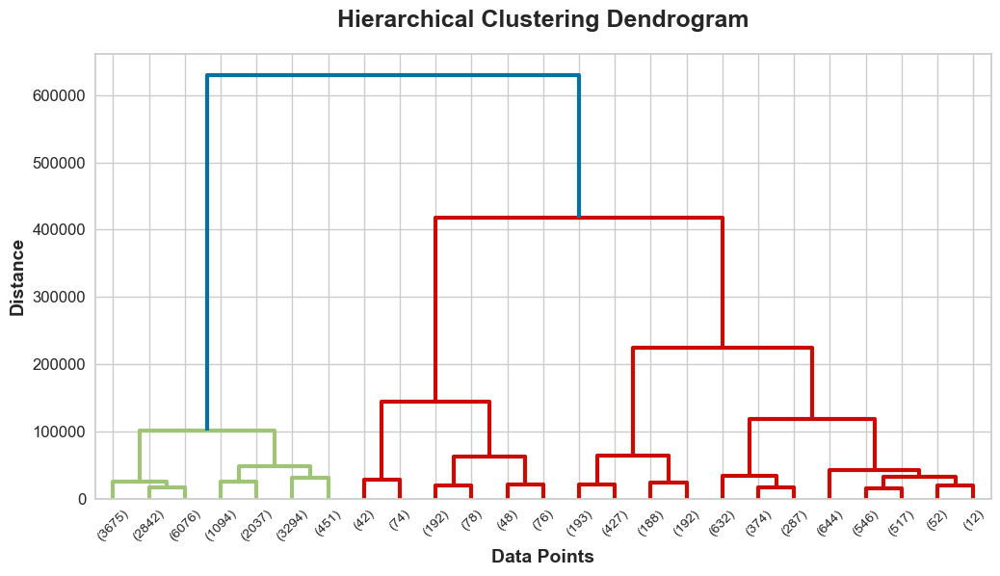

CLUSTER 0 contains 0 data points
CLUSTER 1 contains 19469 data points
CLUSTER 2 contains 510 data points
CLUSTER 3 contains 1000 data points
CLUSTER 4 contains 3064 data points
Number of noise points: 0


In [68]:

'''
Note:
I cannot use WARD on the full dataset due to memory problems. 
I will create a sample which reflects the proportions of the differents groups present in the population using Stratified sampling. 
'''


# ==================================================================================================
# CREATE THE SAMPLE
# ==================================================================================================
# Assuming df_data_kmeans_without_cf is your population DataFrame
population_mean = df_data_kmeans_without_cf.drop(columns=['cluster']).mean()
population_std = df_data_kmeans_without_cf.drop(columns=['cluster']).std()

# Define the size of the sample you want to take (30% of the population)
sample_size = int(0.3 * len(df_data_kmeans_without_cf.drop(columns=['cluster'])))

# Take a random sample from the population
df_data_sample = df_data_kmeans_without_cf.drop(columns=['cluster']).sample(n=sample_size, random_state=42)

# Compare population and sample statistics
comparison = pd.DataFrame({
    'Population Mean': df_data_kmeans_without_cf.drop(columns=['cluster']).mean(),
    'Sampled Data Mean': df_data_sample.mean(),
    'Population Standard Deviation': df_data_kmeans_without_cf.drop(columns=['cluster']).std(),
    'Sampled Data Standard Deviation': df_data_sample.std()
})

display(comparison)


df_data_sample_to_use = df_data_sample






# ==================================================================================================
# WARD CLUSTERING
# ==================================================================================================
# Compute hierarchical clustering using ward linkage
linkage_matrix = linkage(df_data_sample_to_use, method='ward')

# Plot the dendrogram (optional)
plt.figure(figsize=(12, 6))
dendrogram(linkage_matrix, truncate_mode='lastp', p=25)
plt.title('Hierarchical Clustering Dendrogram')
plt.xlabel('Data Points')
plt.ylabel('Distance')
plt.show()

# Set the number of clusters you want to obtain
num_clusters = 4  # You can adjust this value

# Apply flat clustering to obtain cluster labels
cluster_labels = fcluster(linkage_matrix, num_clusters, criterion='maxclust')

# Add the cluster labels to the DataFrame
df_data_sample_to_use['cluster'] = cluster_labels

# Get the number of clusters
num_clusters = len(set(cluster_labels))

# Print statistics for each cluster
for cluster_label in range(0, num_clusters + 1):
    # Count the number of data points in the current cluster
    cluster_count = len(df_data_sample_to_use[df_data_sample_to_use['cluster'] == cluster_label])
    # Print the count for the current cluster
    print(f'CLUSTER {cluster_label} contains {cluster_count} data points')

# Check the number of noise points (if applicable)
noise_points = len(df_data_sample_to_use[df_data_sample_to_use['cluster'] == -1])
print(f'Number of noise points: {noise_points}')


## V.2. Evaluation of cluster - SILHOUETTE VISUALIZER

In [69]:
# ==================================================================================================
# SILHOUETTE SCORE
# ==================================================================================================
# Compute the silhouette score
silhouette_avg = silhouette_score(df_data_sample_to_use.drop(columns=['cluster']), cluster_labels)
print(f"Silhouette Score: {silhouette_avg}")

# ==================================================================================================
# DAVIES-BOULDIN
# ==================================================================================================
# Compute the Davies-Bouldin index
davies_bouldin_idx = davies_bouldin_score(df_data_sample_to_use.drop(columns=['cluster']), cluster_labels)
print(f"Davies-Bouldin Index: {davies_bouldin_idx}")

Silhouette Score: 0.729444012520007
Davies-Bouldin Index: 0.5726651134653191


In [ ]:
# # ==================================================================================================
# # DIFFERENCES BETWEEN CLUSTERS - Radar Plot using Plotly
# # ==================================================================================================
# def plot_radars(data, group, width=800, height=600):
#     scaler = MinMaxScaler()
#     data = pd.DataFrame(scaler.fit_transform(data), 
#                         index=data.index,
#                         columns=data.columns).reset_index()
    
#     fig = go.Figure()

#     # Sort the data by the cluster labels
#     data_sorted = data.sort_values(by=[group])

#     for k in data_sorted[group].unique():
#         cluster_data = data_sorted[data_sorted[group] == k]
#         fig.add_trace(go.Scatterpolar(
#             r=cluster_data.iloc[:, 1:].values.reshape(-1),
#             theta=data.columns[1:],
#             fill='toself',
#             name='Cluster ' + str(k)
#         ))

#     fig.update_layout(
#         polar=dict(
#             radialaxis=dict(
#                 visible=True,
#                 range=[0, 1]
#             )),
#         showlegend=True,
#         title={
#             'text': "Comparison of means per variable across clusters.",
#             'y': 0.95,
#             'x': 0.5,
#             'xanchor': 'center',
#             'yanchor': 'top'},
#         title_font_color="blue",
#         title_font_size=18,
#         width=width,
#         height=height)

#     fig.show()


# numerical_features = list(df_data_sample_to_use.select_dtypes(include=['int32', 'int64','float64', 'uint8']).columns)
# # Preprocessor
# scaler = MinMaxScaler()

# preprocessor = ColumnTransformer([
#     ('scaler', scaler, numerical_features)])
# X_scaled = preprocessor.fit_transform(df_data_sample_to_use)
# X_scaled = pd.DataFrame(X_scaled, index=df_data_sample_to_use.index, columns=df_data_sample_to_use.columns)
# X_scaled["kmeans_label"] = cluster_labels
# X_scaled_clusters = X_scaled.groupby("kmeans_label").mean()
# X_scaled_clusters


# plot_radars(data=X_scaled_clusters, group="kmeans_label", width=1200, height=1000)


# II. Business-Oriented Technique -  RFM Segmentation

In [72]:
# Concatenate the RFM features into a new dataframe
rfm_df = df_data[['recency', 'frequency', 'total_payment']]

# Based on the elbow method, select the optimal number of clusters
# Clusters in RFM : Loyaux, Champions, Loyalistes potentiels, A Réactiver, Perdus, A risque. 
optimal_num_clusters = 6 

# Perform K-means clustering with the optimal number of clusters
kmeans = KMeans(n_clusters=optimal_num_clusters, random_state=42)
cluster_labels = kmeans.fit_predict(rfm_df)

# Add cluster labels to the dataframe
df_data['cluster'] = cluster_labels

# Analyze the characteristics of each cluster
cluster_summary = df_data.groupby('cluster').agg({
    'recency': 'mean',
    'frequency': 'mean',
    'total_payment': 'mean',
    'customer_unique_id': 'count'
}).rename(columns={'customer_unique_id': 'count'})

# Analyze the characteristics of each cluster
cluster_summary = df_data.groupby('cluster').agg({
    'recency': 'mean',
    'frequency': 'mean',
    'total_payment': 'mean',
    'customer_unique_id': 'count'
}).rename(columns={'customer_unique_id': 'count'})

# Define cluster names based on characteristics
cluster_names = {
    0: 'A Réactiver',
    1: 'Champions',
    2: 'Loyaux',
    3: 'Perdus',
    4: 'A risque',
    5: 'Loyalistes potentiels'
}

# Assign descriptive names to clusters
cluster_summary['cluster_name'] = cluster_summary.index.map(cluster_names)
display(cluster_summary)

# Map cluster labels to cluster names
df_data['cluster_name'] = df_data['cluster'].map(cluster_names)




# Get centroids of the clusters
centroids = kmeans.cluster_centers_

# Convert centroids to DataFrame
centroids_df = pd.DataFrame(centroids, columns=['recency', 'frequency', 'total_payment'])

# Add cluster names to centroids DataFrame
centroids_df['cluster'] = centroids_df.index.map(cluster_names)



,recency,frequency,total_payment,count,cluster_name
cluster,,,,,
0,253.82,1.02,113.51,26230,A Réactiver
1,233.92,1.06,2250.81,307,Champions
2,84.17,1.02,123.19,27163,Loyaux
3,457.92,1.02,130.81,17157,Perdus
4,246.51,1.08,963.31,1825,A risque
5,207.06,1.10,404.51,7462,Loyalistes potentiels


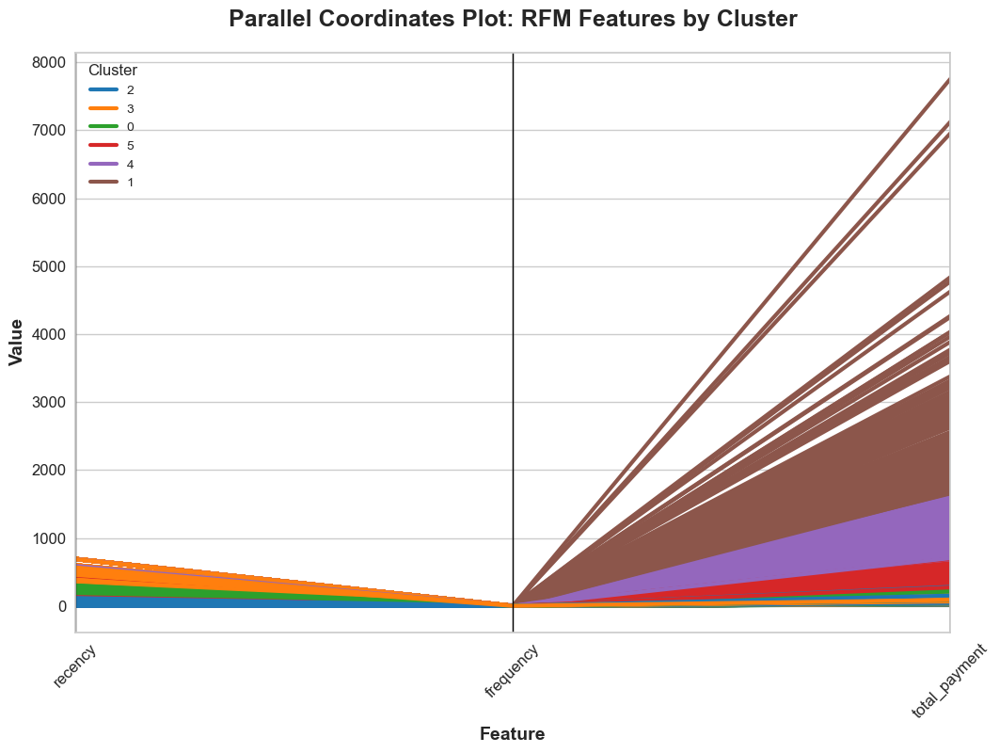

In [73]:
# Parallel Coordinates Plot
plt.figure(figsize=(12, 8))
pd.plotting.parallel_coordinates(df_data[['recency', 'frequency', 'total_payment', 'cluster']], 'cluster', color=('#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd', '#8c564b'))
plt.xlabel('Feature')
plt.ylabel('Value')
plt.title('Parallel Coordinates Plot: RFM Features by Cluster')
plt.xticks(rotation=45)
plt.legend(title='Cluster')
plt.grid(True)
plt.show()


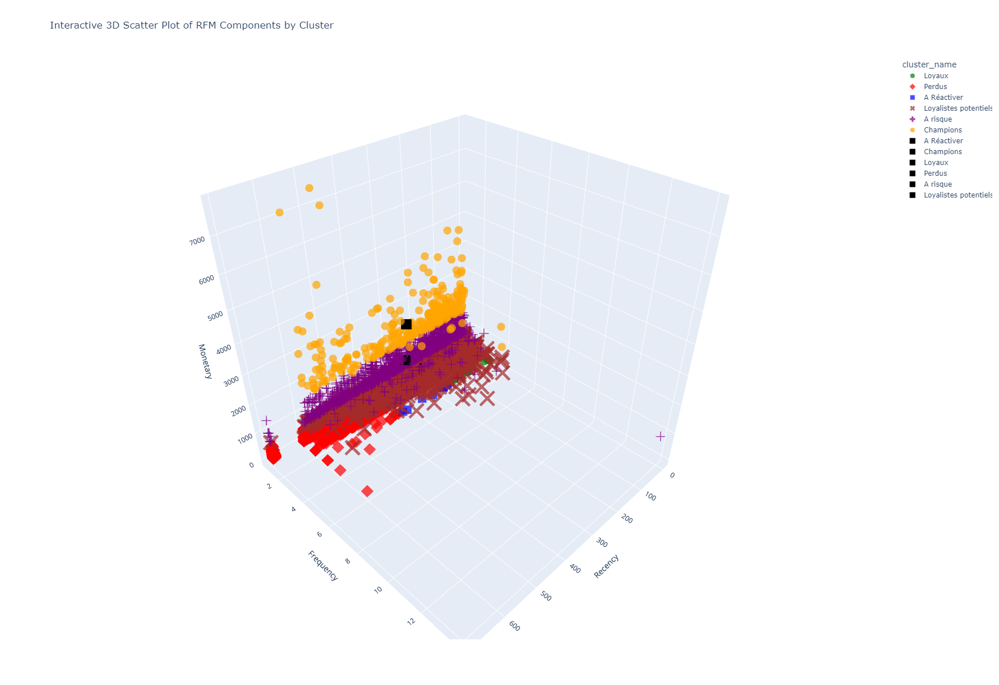

In [74]:
# Define colors for each cluster name
cluster_colors = {
    'A Réactiver': 'blue',
    'Champions': 'orange',
    'Loyaux': 'green',
    'Perdus': 'red',
    'A risque': 'purple',
    'Loyalistes potentiels': 'brown'
}

# Create an interactive 3D scatter plot with Plotly
fig = px.scatter_3d(df_data, x='recency', y='frequency', z='total_payment', color='cluster_name',
                    color_discrete_map=cluster_colors, symbol='cluster_name',
                    opacity=0.7, title='Interactive 3D Scatter Plot of RFM Components by Cluster')

# Update layout to make the figure square and larger
fig.update_layout(scene=dict(
                    xaxis_title='Recency',
                    yaxis_title='Frequency',
                    zaxis_title='Monetary',
                    aspectratio=dict(x=1, y=1, z=1),  # Make axes equal to create a square figure
                    aspectmode='manual'  # Prevent Plotly from automatically adjusting the aspect ratio
                ),
                width=1200,  # Set the width of the plot
                height=1200  # Set the height of the plot
                )

# Add centroids to the plot as black square markers
for i, centroid in centroids_df.iterrows():
    fig.add_trace(go.Scatter3d(x=[centroid['recency']], y=[centroid['frequency']], z=[centroid['total_payment']],
                                mode='markers', marker=dict(color='black', symbol='square', size=10),
                                name=centroid["cluster"]))

# Show plot
fig.show()

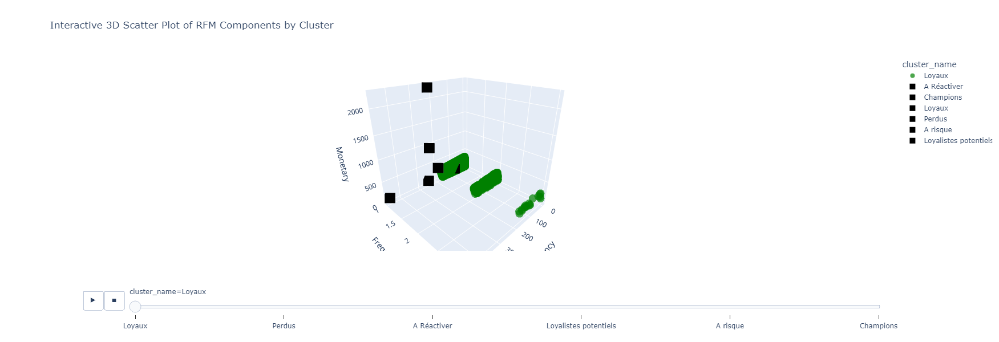

In [75]:
# Create an interactive 3D scatter plot with Plotly
fig = px.scatter_3d(df_data, x='recency', y='frequency', z='total_payment', color='cluster_name',
                    color_discrete_map=cluster_colors, symbol='cluster_name',
                    opacity=0.7, title='Interactive 3D Scatter Plot of RFM Components by Cluster',
                    animation_frame='cluster_name')  # Use cluster_name for animation

# Update layout to make the figure square and larger
fig.update_layout(scene=dict(
                    xaxis_title='Recency',
                    yaxis_title='Frequency',
                    zaxis_title='Monetary',
                    aspectratio=dict(x=1, y=1, z=1),  # Make axes equal to create a square figure
                    aspectmode='manual',  # Prevent Plotly from automatically adjusting the aspect ratio
                    camera=dict(
                        eye=dict(x=1.2, y=1.2, z=0.8)  # Adjust the eye position for zooming
                    )
                ),
                width=600,  # Set the width of the plot
                height=600  # Set the height of the plot
                )

# Add centroids to the plot as black square markers
for i, centroid in centroids_df.iterrows():
    fig.add_trace(go.Scatter3d(x=[centroid['recency']], y=[centroid['frequency']], z=[centroid['total_payment']],
                                mode='markers', marker=dict(color='black', symbol='square', size=10),
                                name=centroid["cluster"]))

# Show plot
fig.show()

# Save the animation as HTML
fig.write_html("3d_RFM_Clustering.html", animation_opts=dict(loop=True))

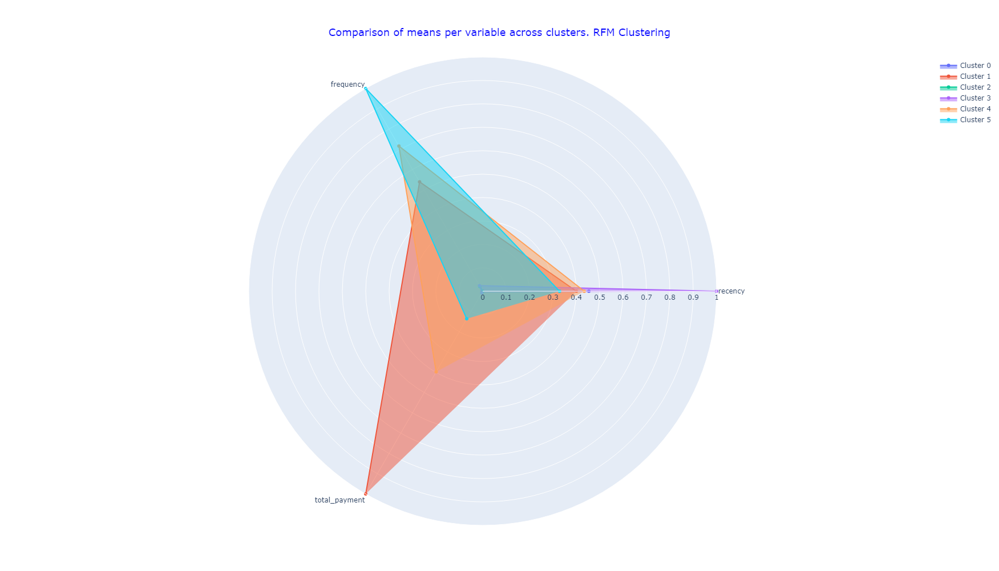

In [76]:
# ==================================================================================================
# DIFFERENCES BETWEEN CLUSTERS - Radar Plot using Plotly
# ==================================================================================================
def plot_radars(data, group, width=800, height=600):
    scaler = MinMaxScaler()
    data = pd.DataFrame(scaler.fit_transform(data), 
                        index=data.index,
                        columns=data.columns).reset_index()
    
    fig = go.Figure()

    # Sort the data by the cluster labels
    data_sorted = data.sort_values(by=[group])

    for k in data_sorted[group].unique():
        cluster_data = data_sorted[data_sorted[group] == k]
        fig.add_trace(go.Scatterpolar(
            r=cluster_data.iloc[:, 1:].values.reshape(-1),
            theta=data.columns[1:],
            fill='toself',
            name='Cluster ' + str(k)
        ))

    fig.update_layout(
        polar=dict(
            radialaxis=dict(
                visible=True,
                range=[0, 1]
            )),
        showlegend=True,
        title={
            'text': "Comparison of means per variable across clusters.\nRFM Clustering",
            'y': 0.95,
            'x': 0.5,
            'xanchor': 'center',
            'yanchor': 'top'},
        title_font_color="blue",
        title_font_size=18,
        width=width,
        height=height)

    fig.show()


numerical_features = list(rfm_df.select_dtypes(include=['int32', 'int64','float64', 'uint8']).columns)
# Preprocessor
scaler = MinMaxScaler()

preprocessor = ColumnTransformer([
    ('scaler', scaler, numerical_features)])
X_scaled = preprocessor.fit_transform(rfm_df)
X_scaled = pd.DataFrame(X_scaled, index=rfm_df.index, columns=rfm_df.columns)
X_scaled["RFM_label"] = cluster_labels
X_scaled_clusters = X_scaled.groupby("RFM_label").mean()
X_scaled_clusters


plot_radars(data=X_scaled_clusters, group="RFM_label", width=1200, height=1000)
